In [712]:
#dataPath1= 'good/'
dataPath='../LFP/'
dataPath2='../new_data/'

In [713]:
MAXLEN=11202

In [903]:
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter
# from torch import nn
# import torch.optim as optim
# import torch
# from torch.utils.data import TensorDataset, DataLoader
# from torch.optim.lr_scheduler import ReduceLROnPlateau
from tqdm.notebook import tqdm
from scipy import stats
from IPython.display import clear_output
import pickle 
import scipy
from scipy import io
import math
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error

import reservoirpy as rpy
from reservoirpy.nodes import Reservoir, Ridge, FORCE, ESN

In [715]:
from reservoirpy.nodes import Reservoir
import scipy
reservoir = Reservoir(100, lr=0.2, sr=0.8)

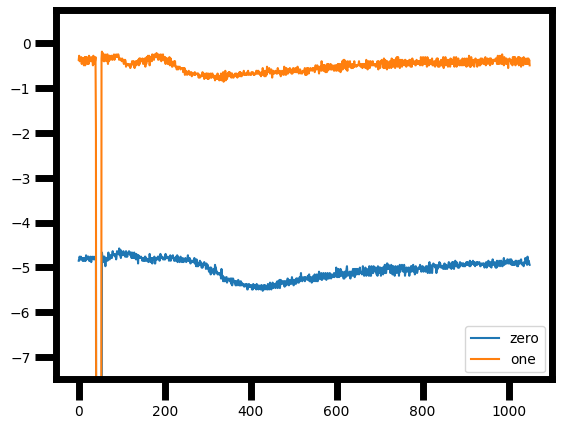

10002
[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


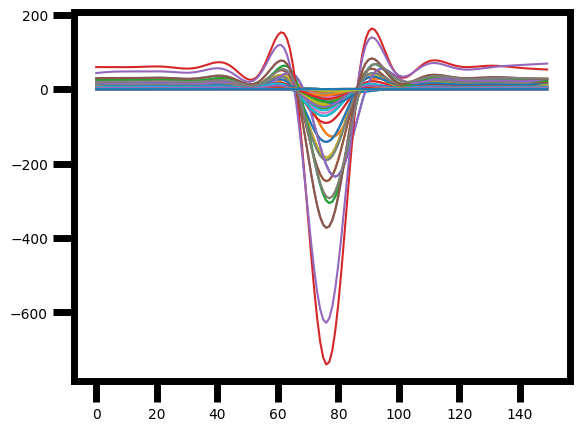

2 1 1 4
1
100


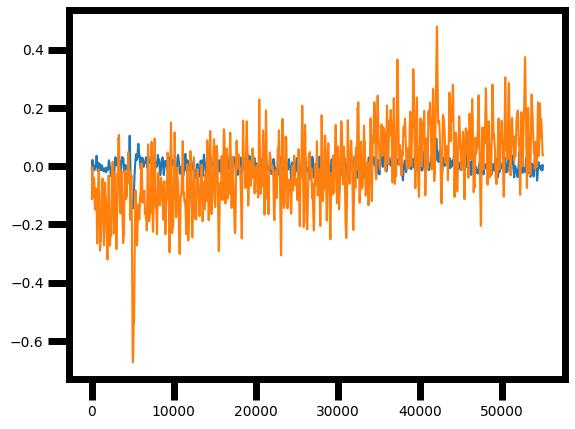

100


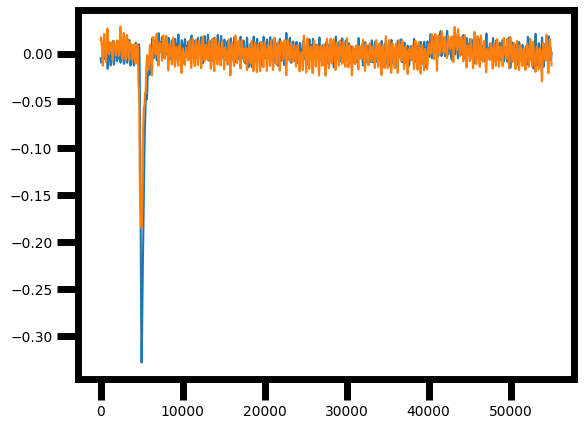

100


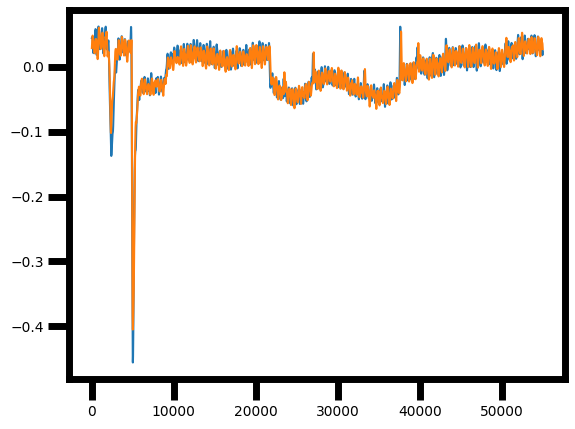

100


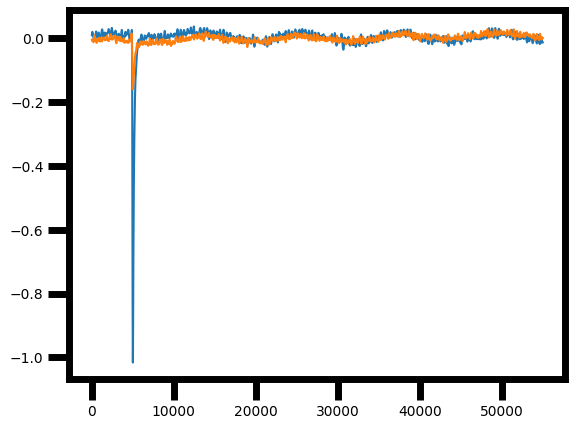

200


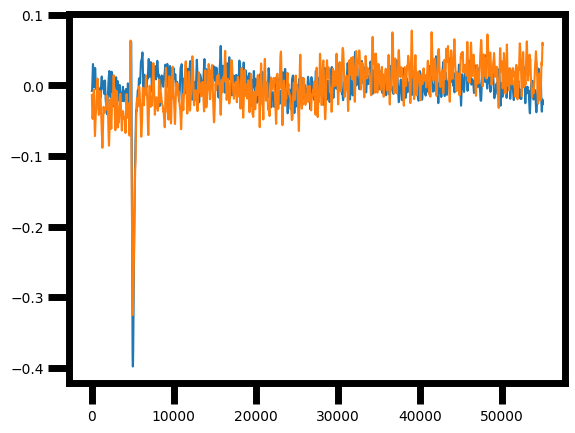

200


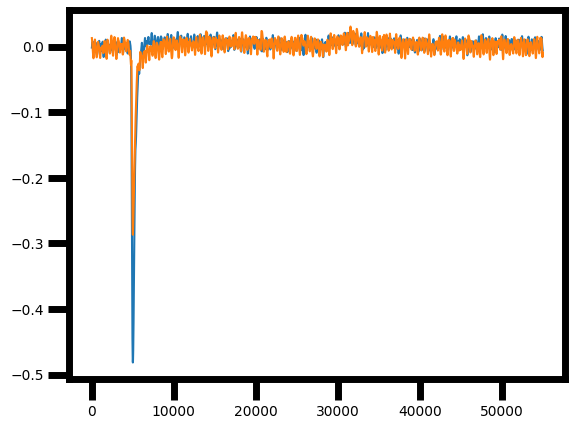

200


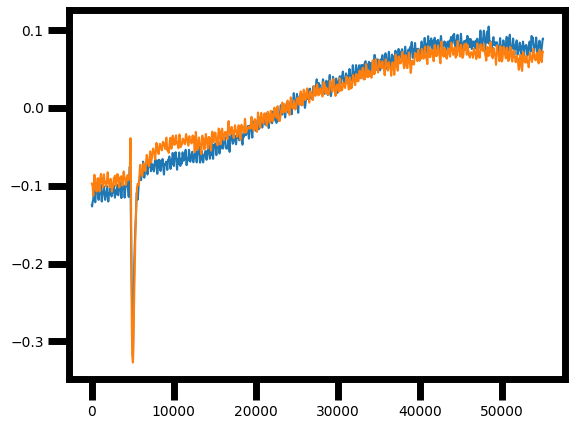

200


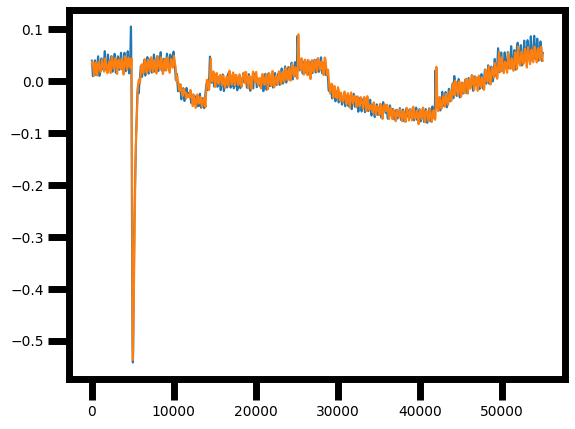

300


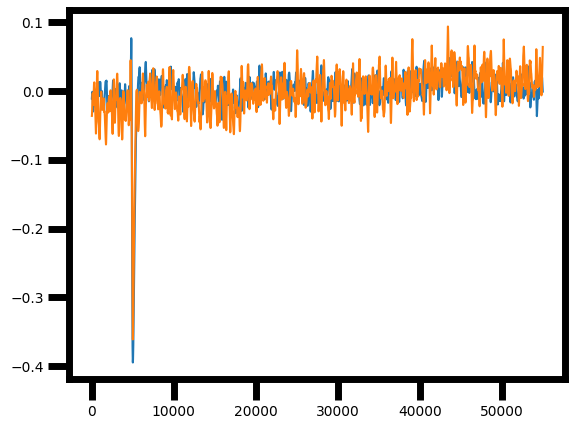

300


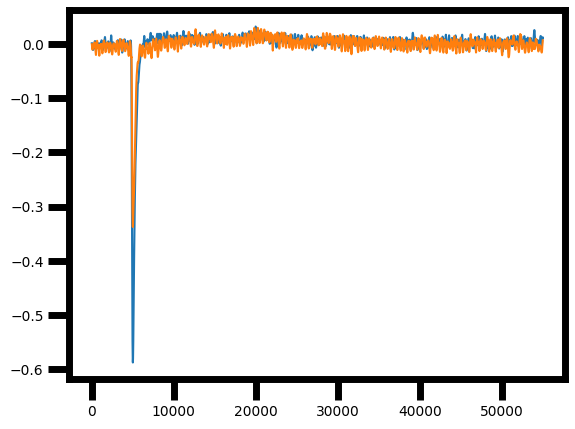

300


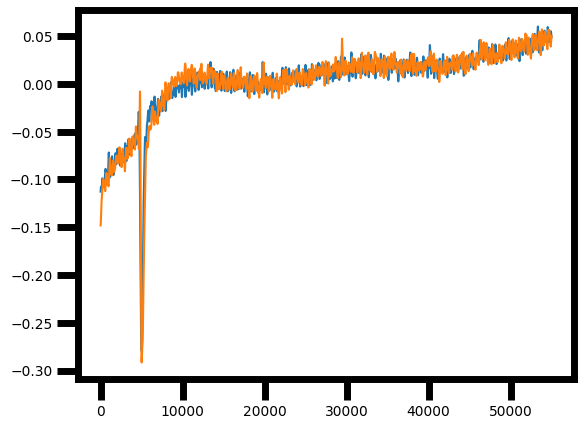

300


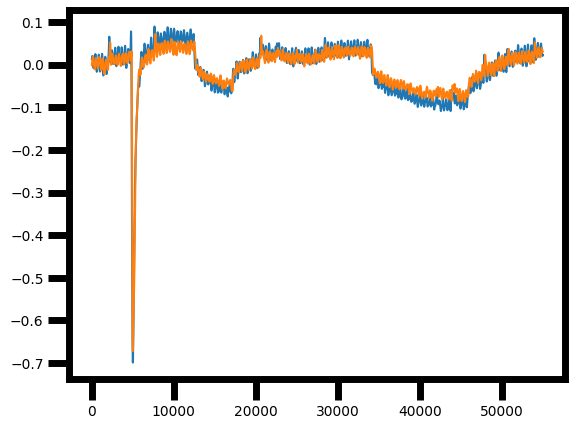

300


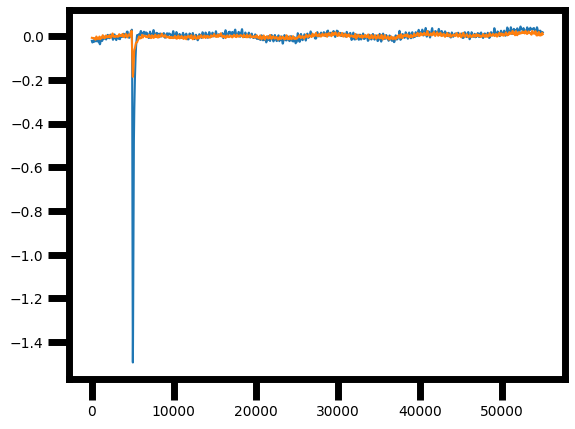

400


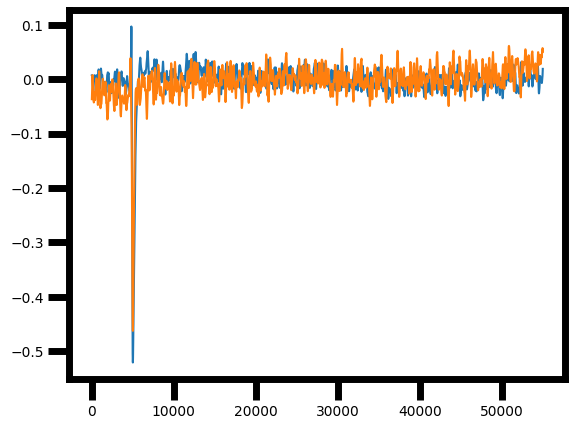

400


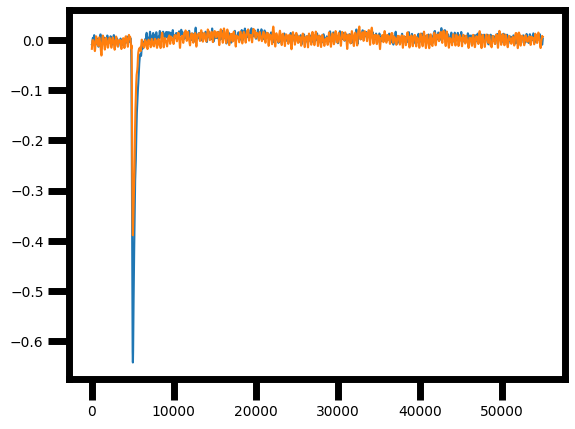

400


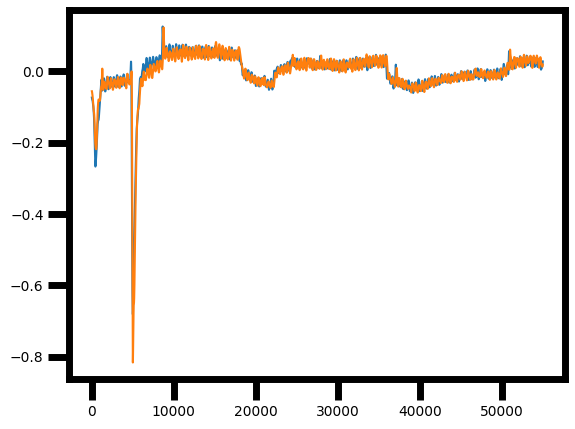

400


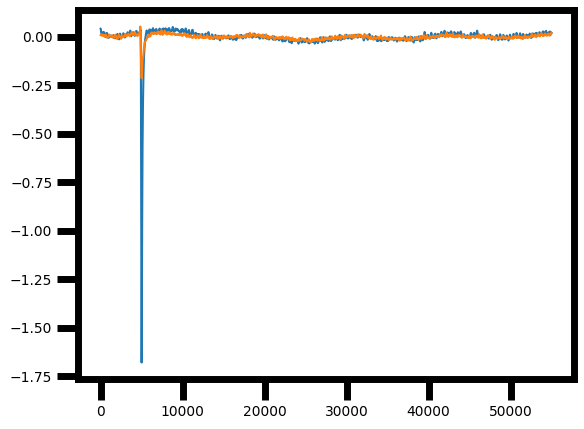

500


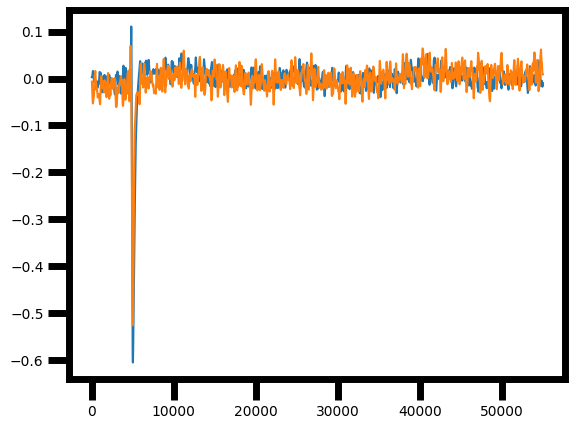

500


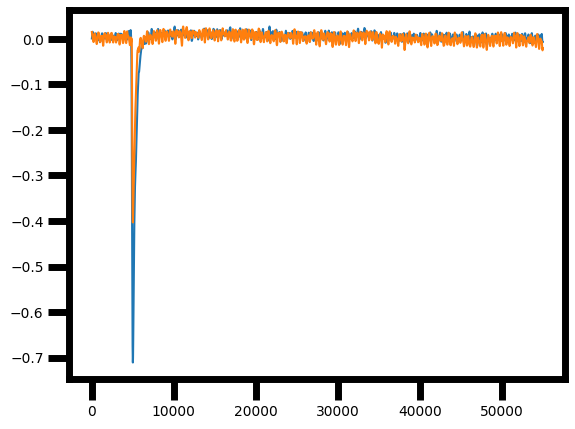

500


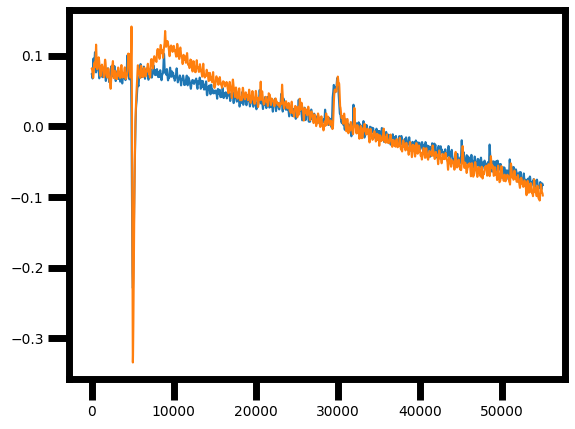

500


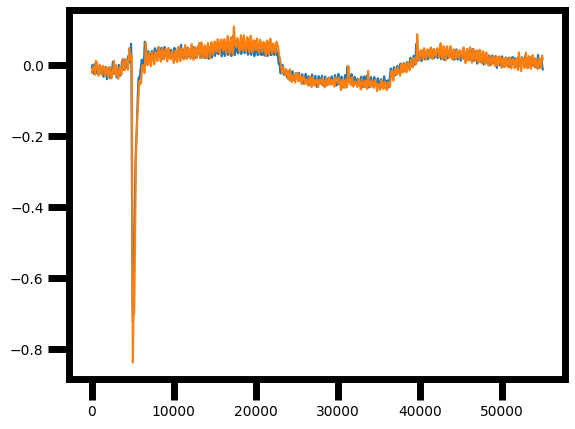

500


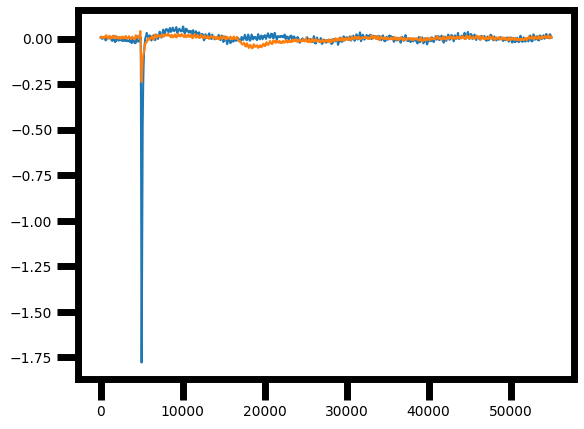

600


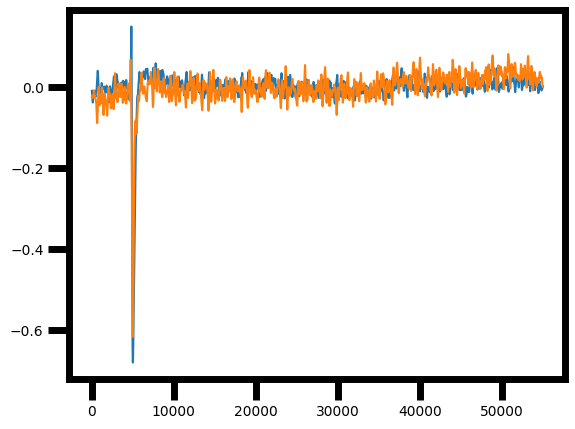

600


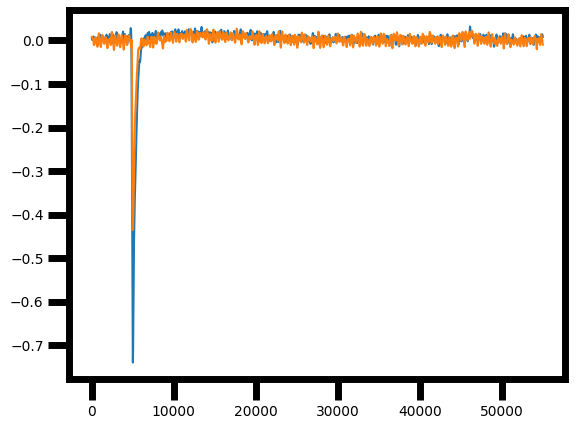

600


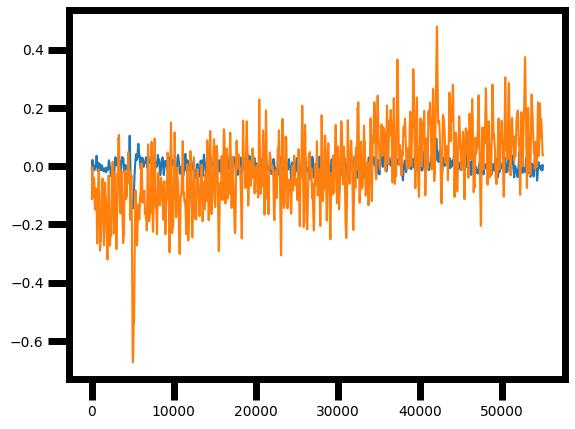

600


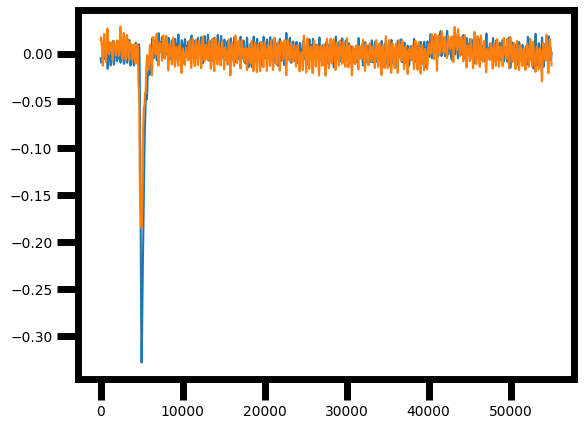

600


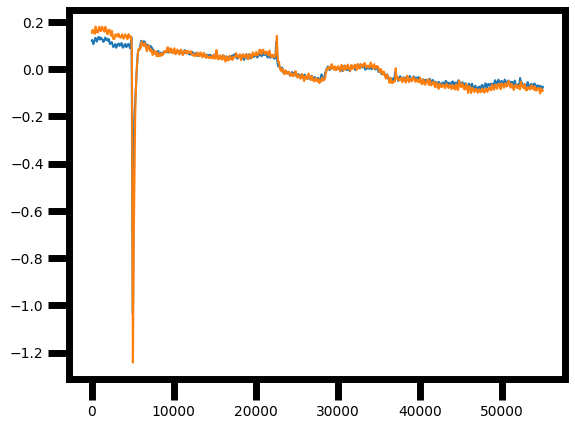

600


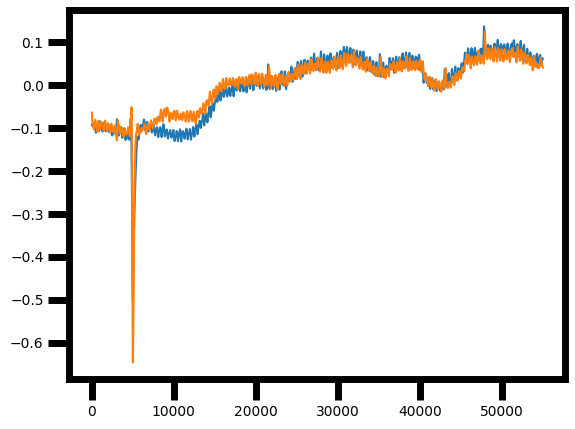

600


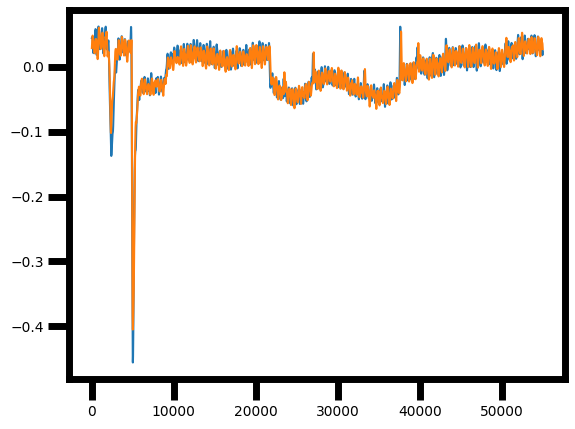

600


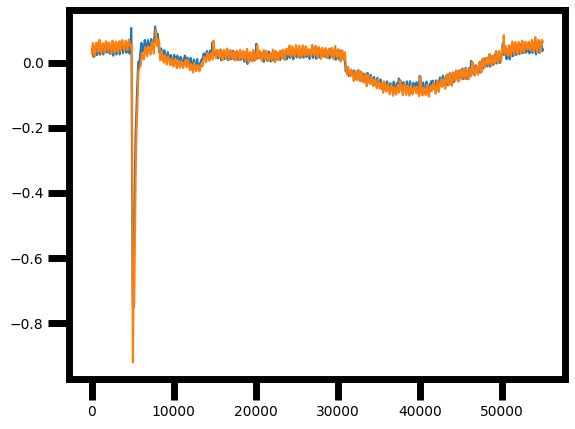

600


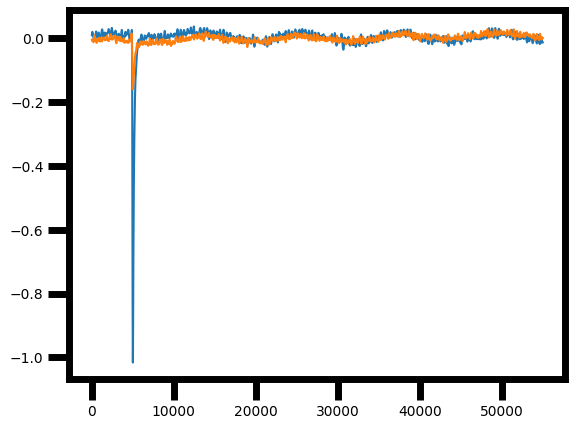

600


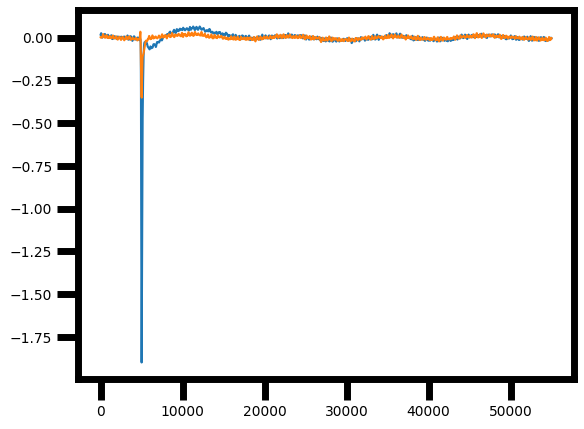

700


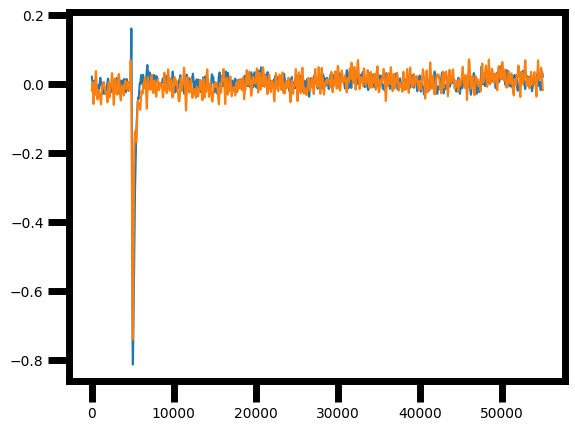

700


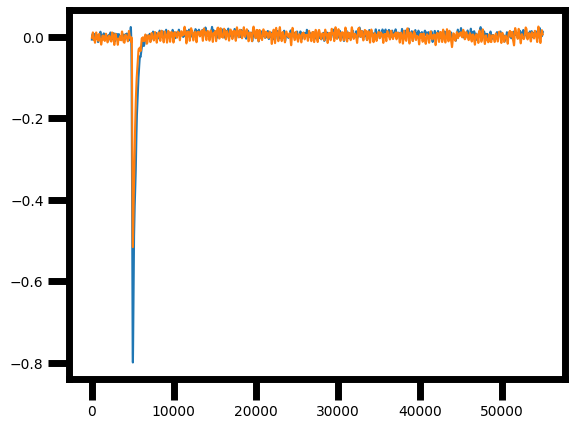

700


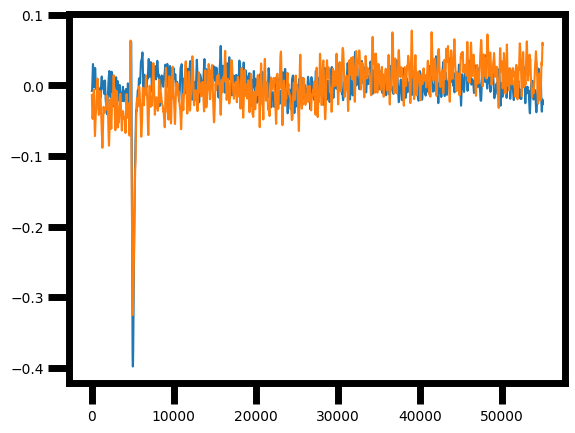

700


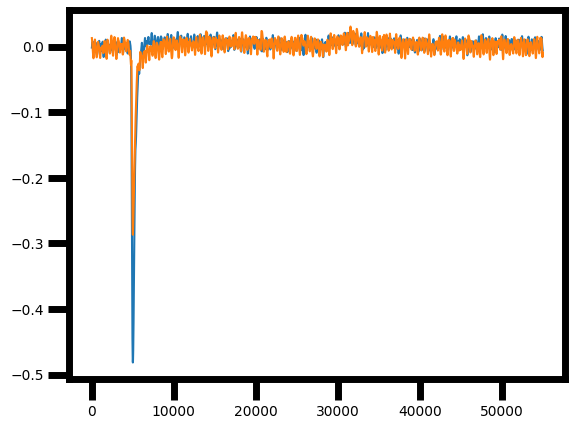

700


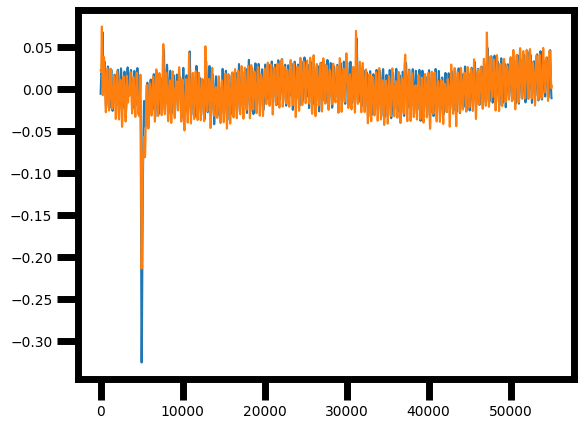

700


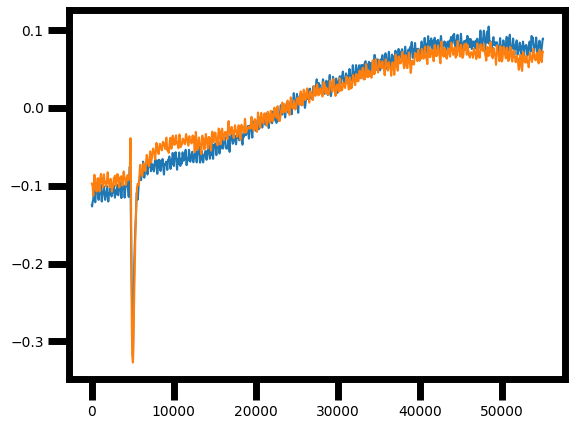

700


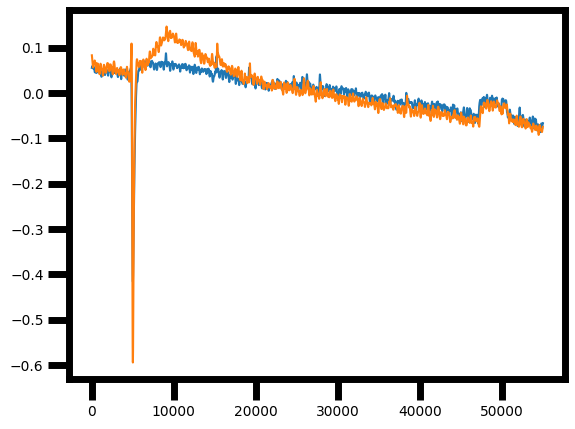

700


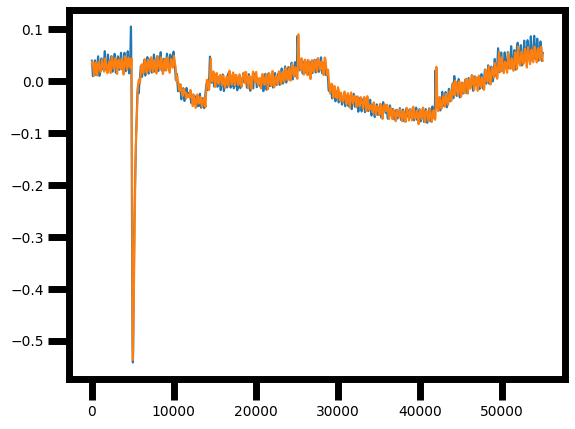

700


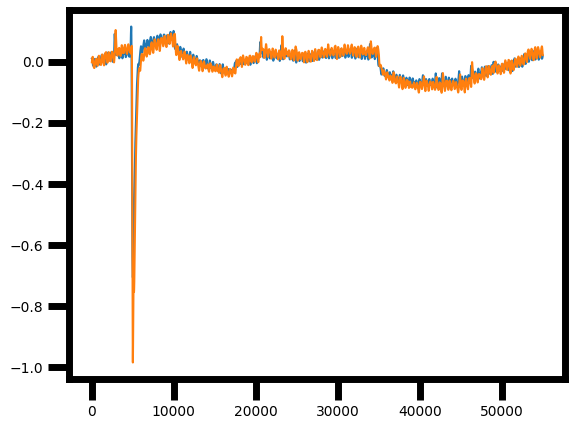

700


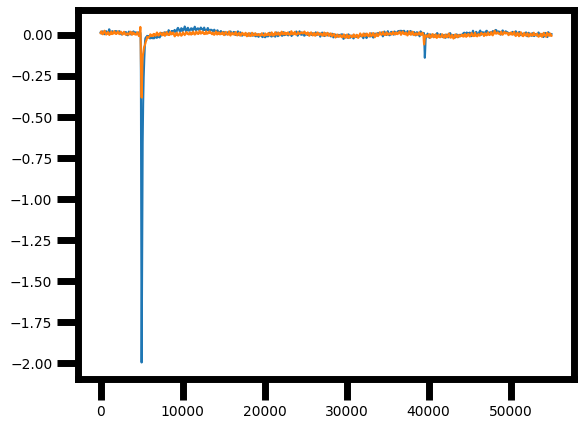

800


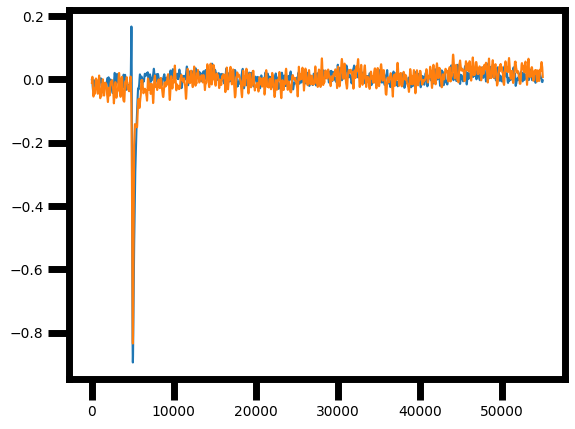

800


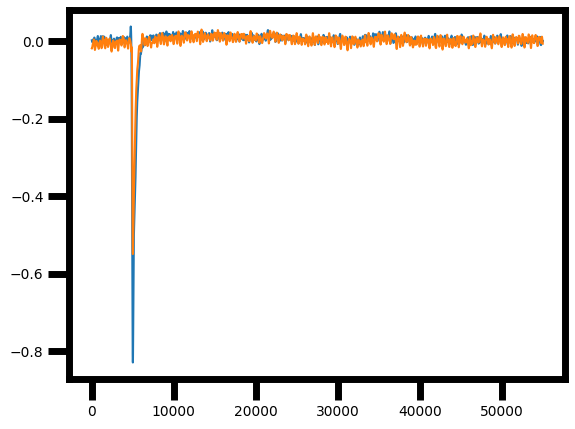

800


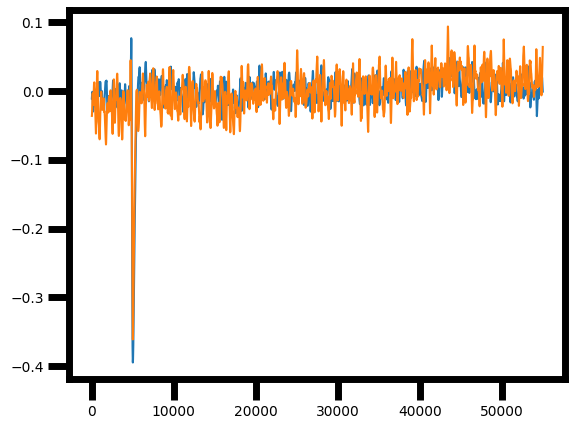

800


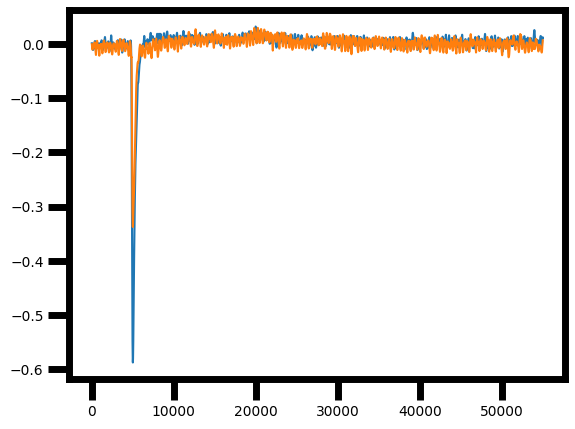

800


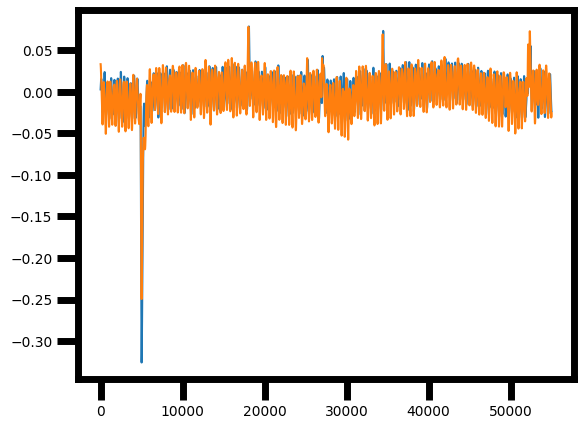

800


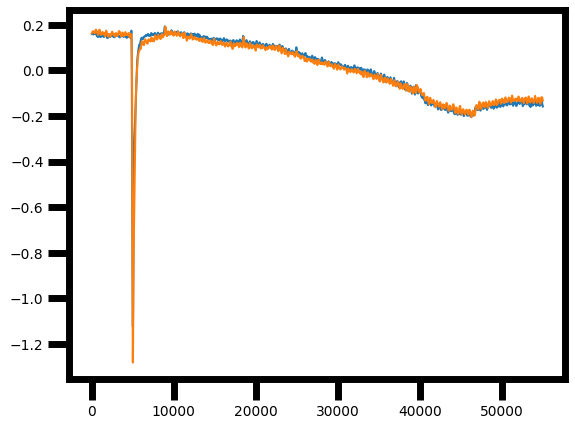

800


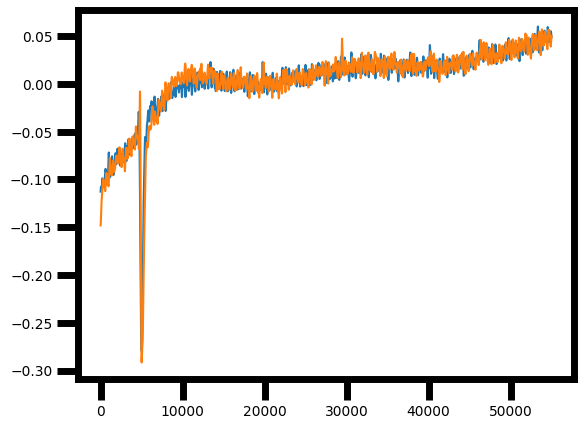

800


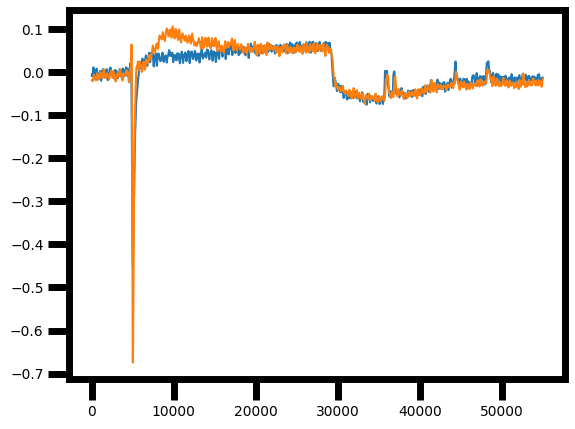

800


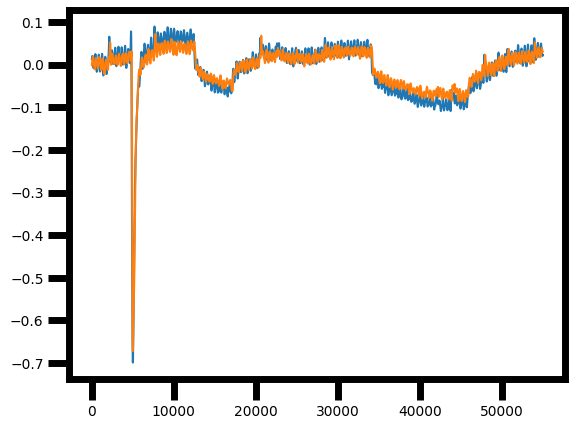

800


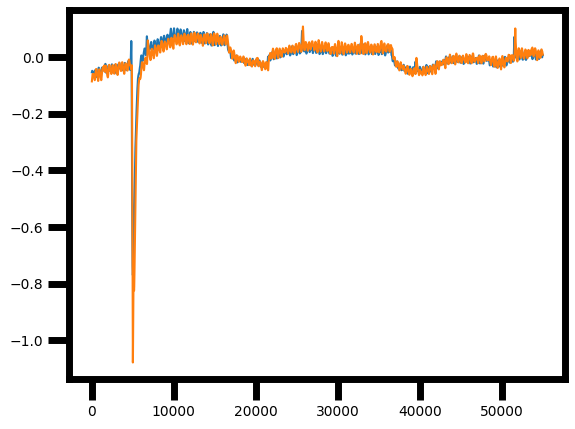

800


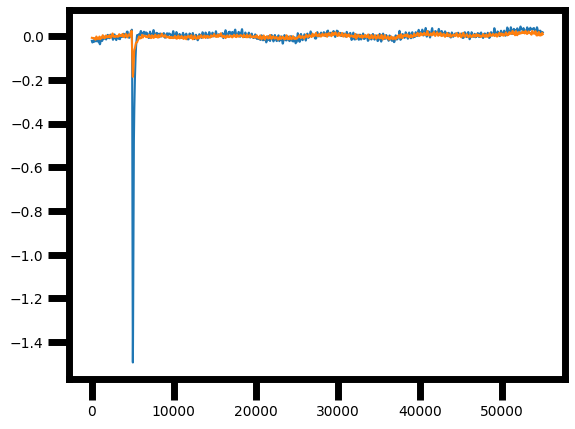

800


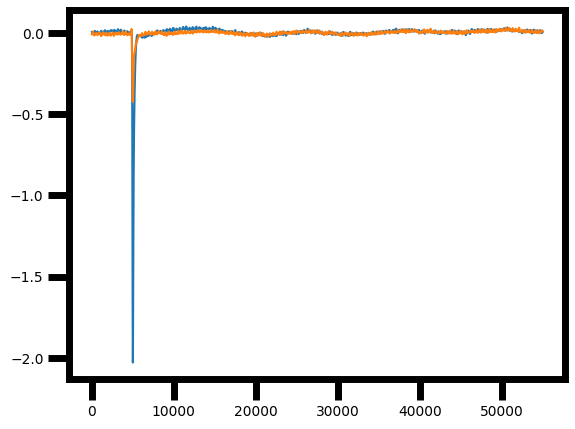

900


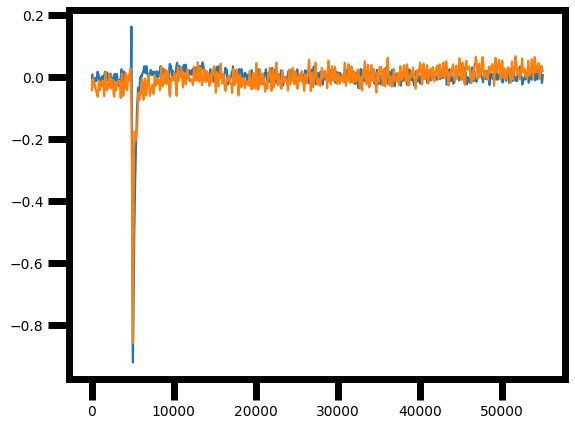

900


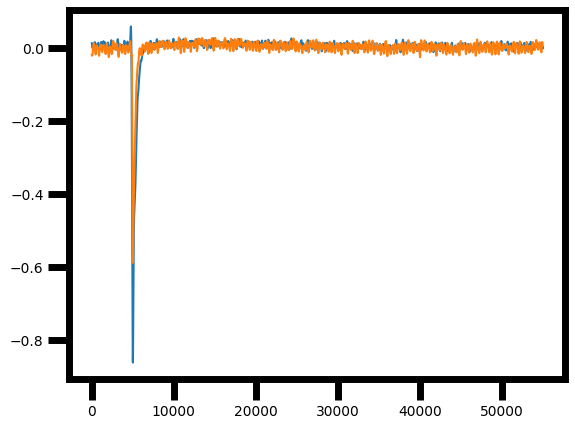

900


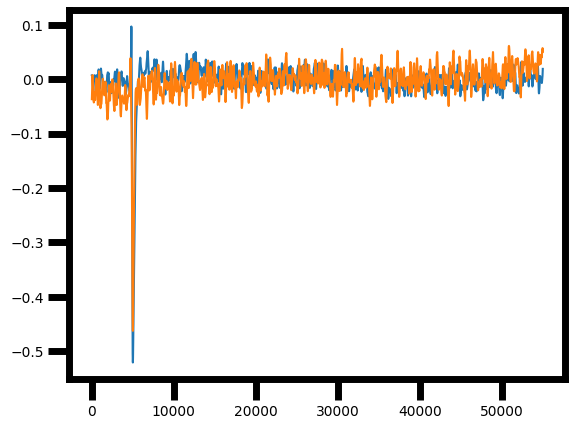

900


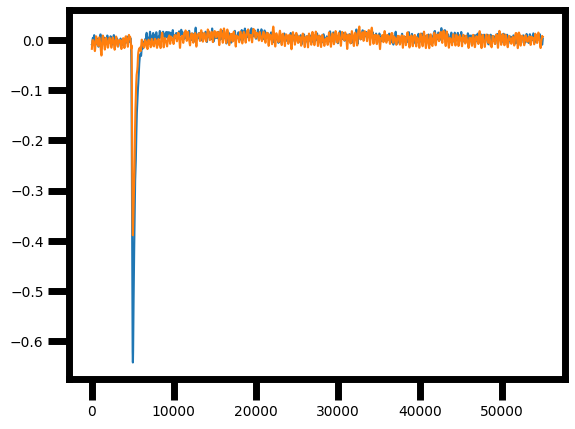

900


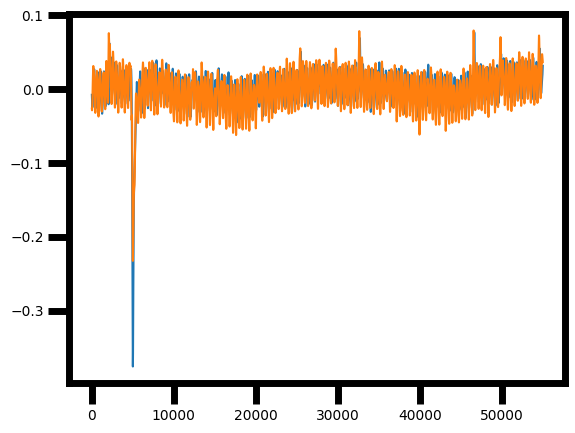

900


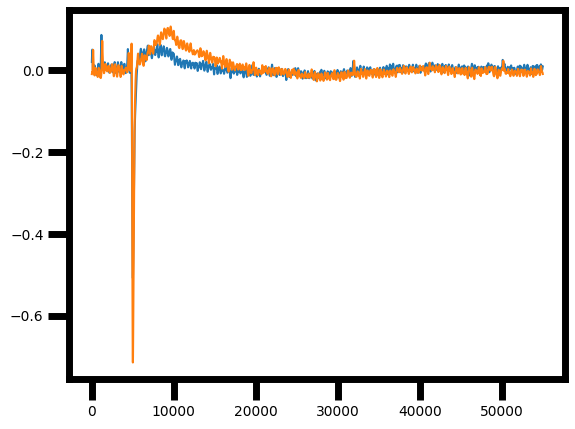

900


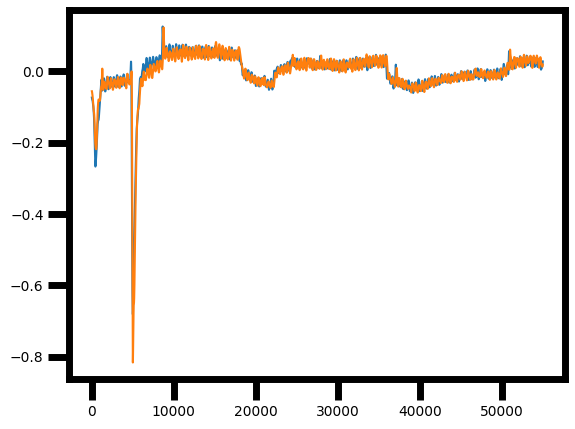

900


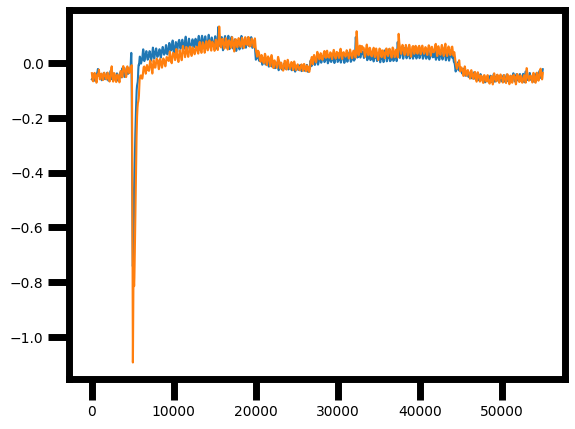

900


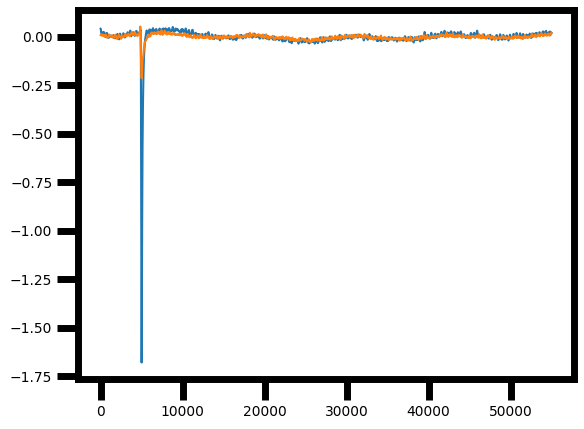

900


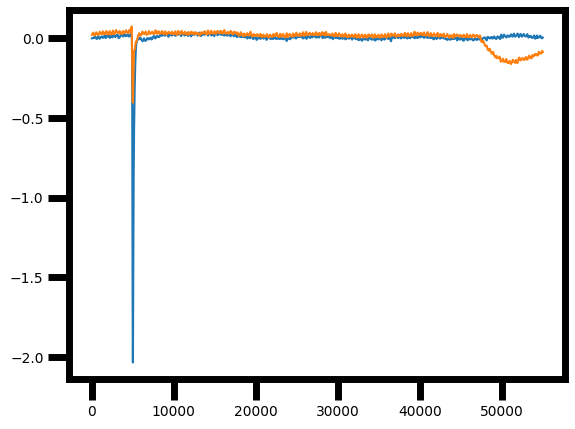

1000


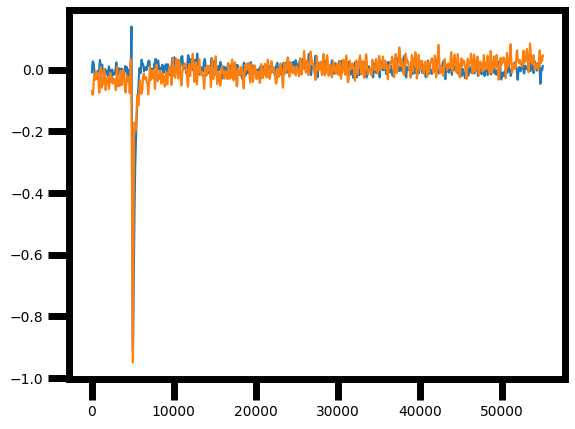

1000


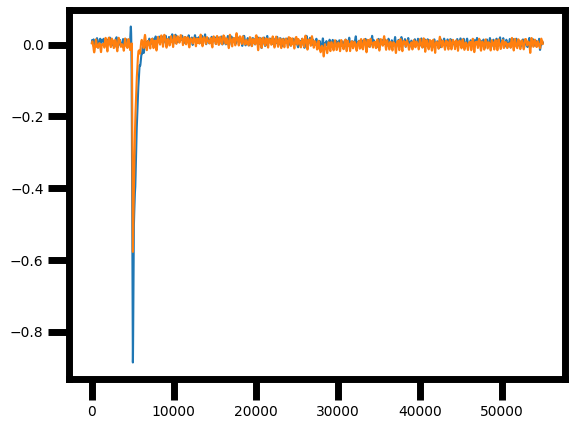

1000


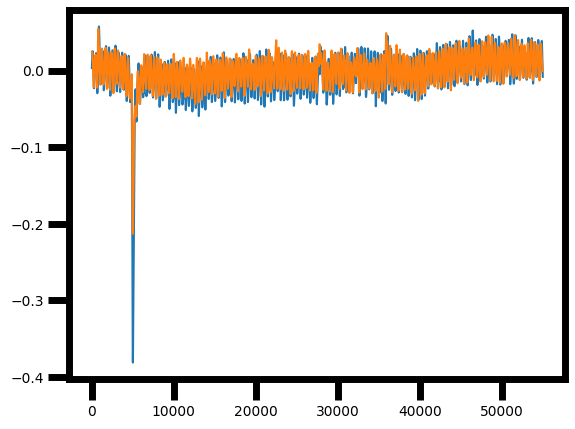

1000


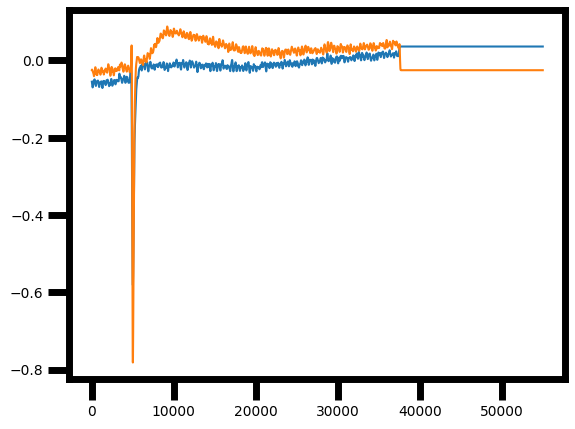

1000


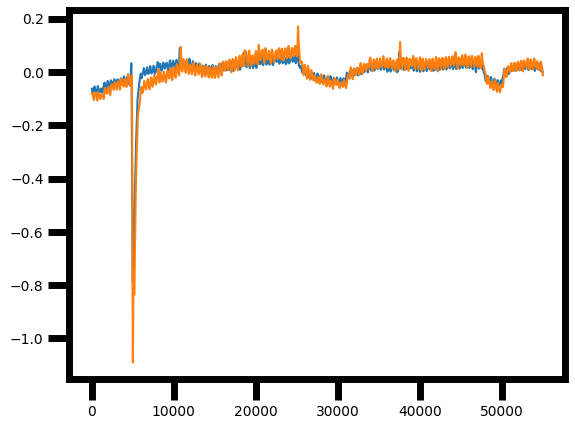

1000


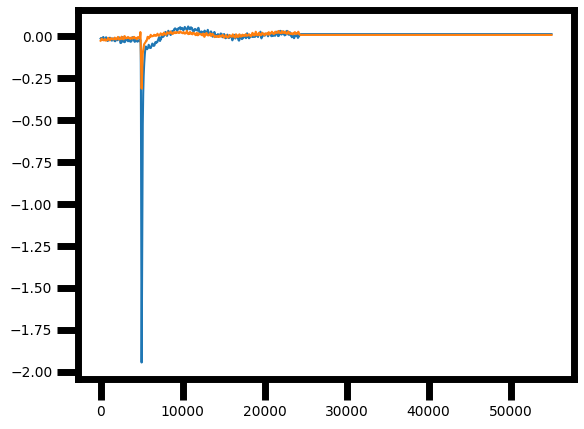

1000


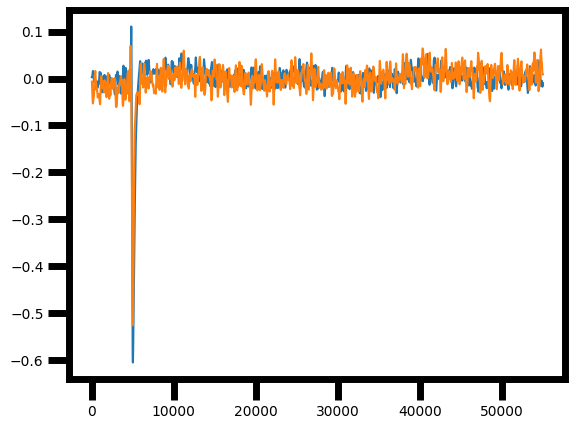

1000


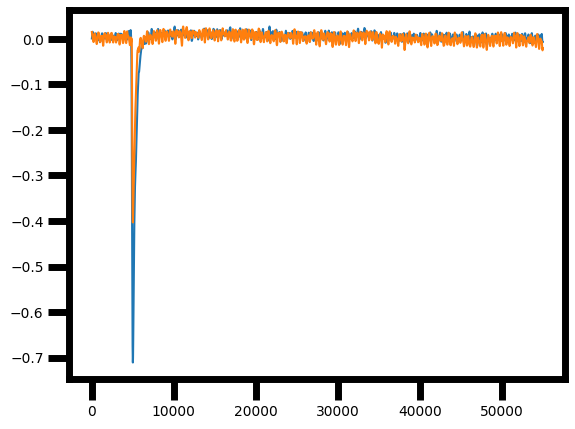

1000


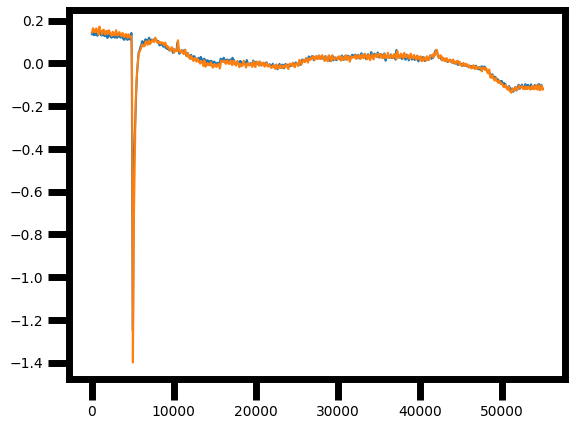

1000


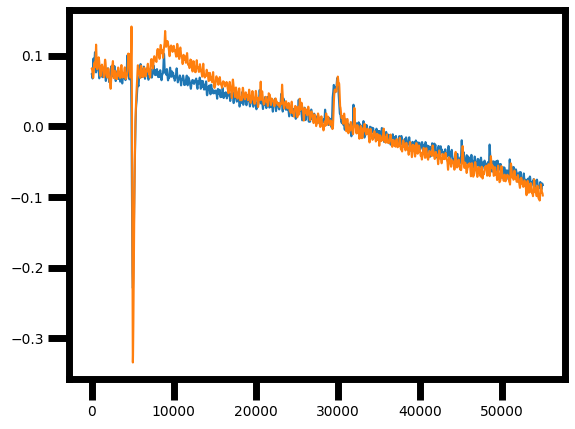

1000


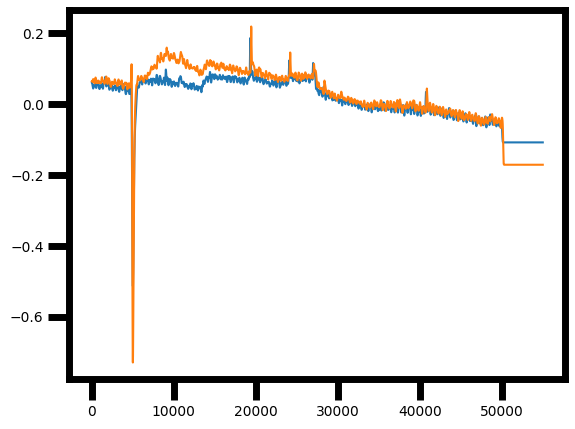

1000


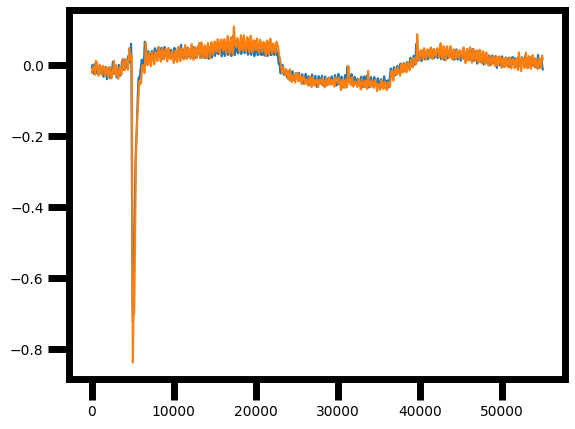

1000


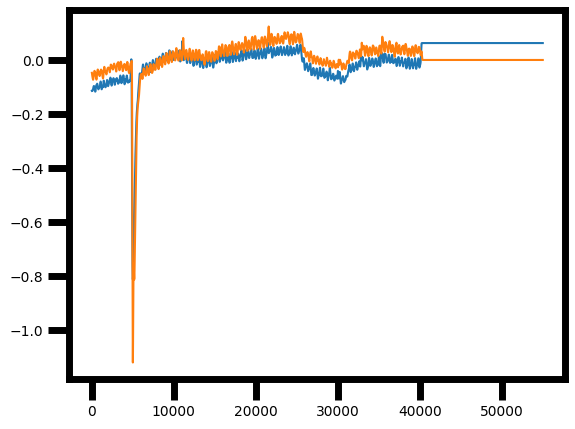

1000


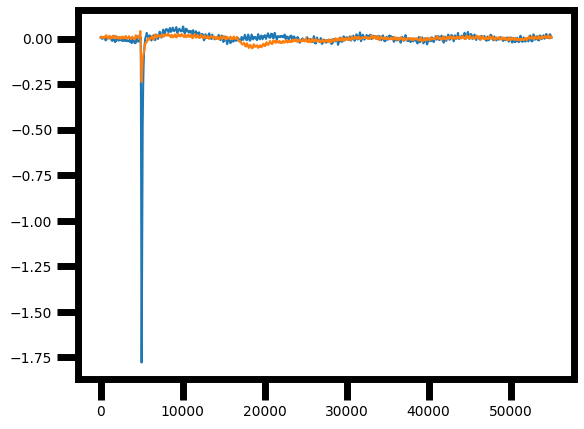

1000


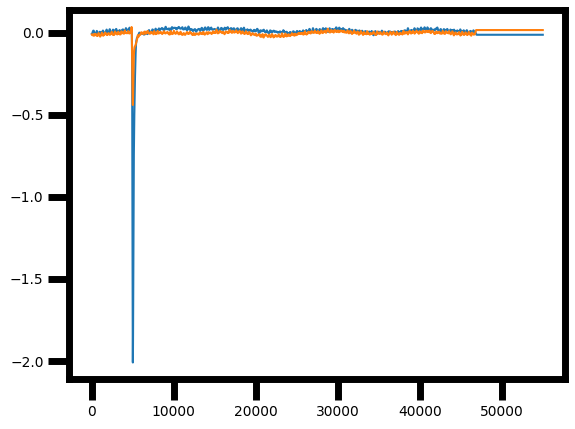

1


In [716]:
%run preprocessing.ipynb
preprocessed = get_output()

In [717]:
os.getcwd()

'C:\\Users\\sambu\\work\\hipp_invitro\\Reservoir'

In [587]:
# %run preprocessing_old.ipynb
# preprocessed_old = get_output_old()

In [718]:
union_data = {}
union_data[100]=[]
union_data[200]=[]
union_data[300]=[]
union_data[400]=[]
union_data[500]=[]
union_data[600]=[]
union_data[700]=[]
union_data[800]=[]
union_data[900]=[]
union_data[1000]=[]

for amp in list(range(100, 1001, 100)):
    if amp in preprocessed.keys():
            for sig in preprocessed[amp]:
                union_data[amp].append([(sig[0], sig[1], sig[2]), amp])
    # if amp in preprocessed_old.keys():
    #      for sig in preprocessed_old[amp]:
    #          union_data[amp].append(sig)

In [741]:
np.save("all_sigs.npy", union_data)

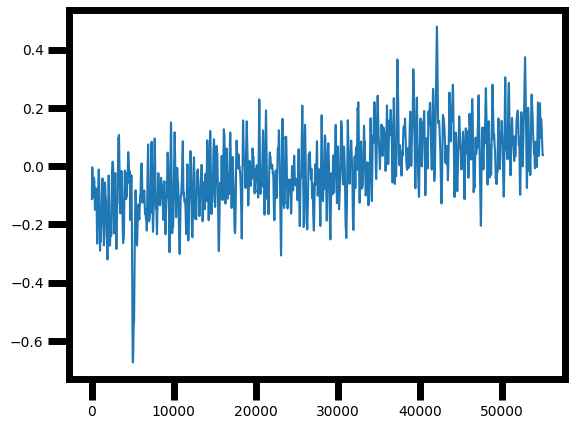

In [742]:
plt.plot(union_data[100][0][0][1])

0 100


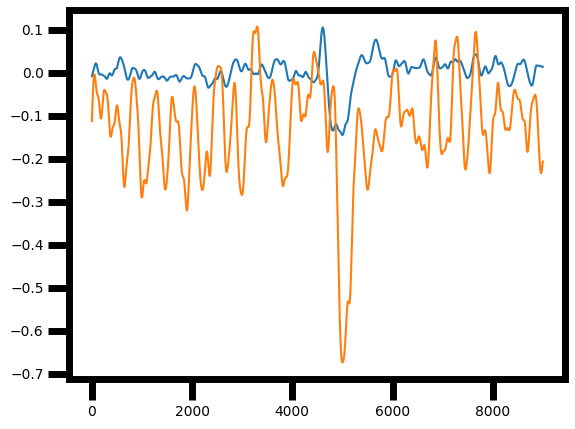

1 100


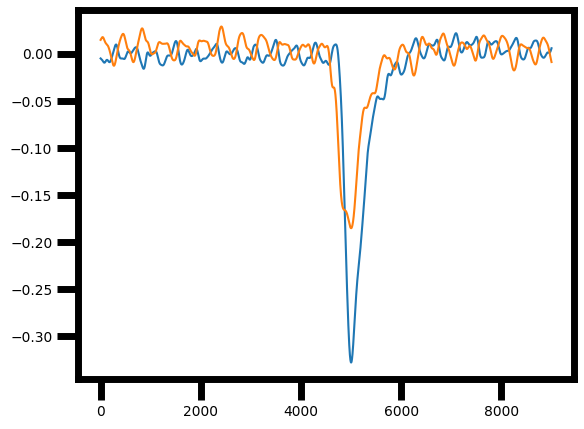

2 100


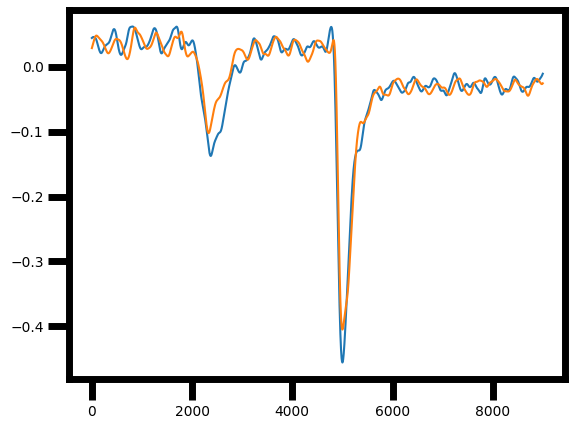

0 200


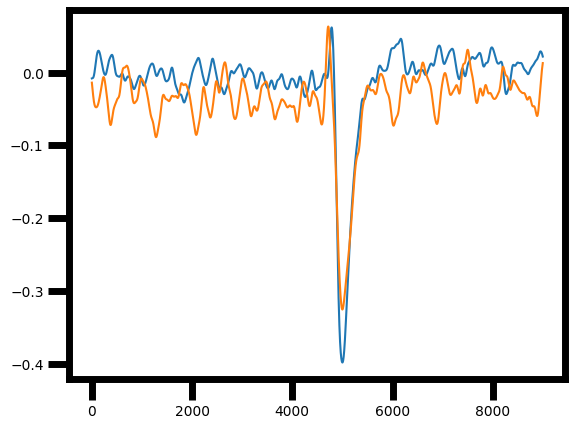

1 200


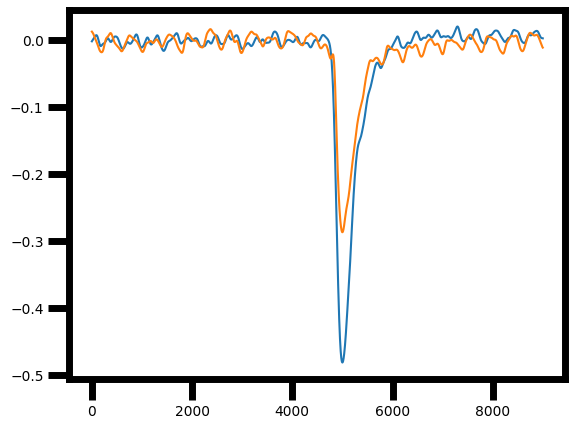

2 200


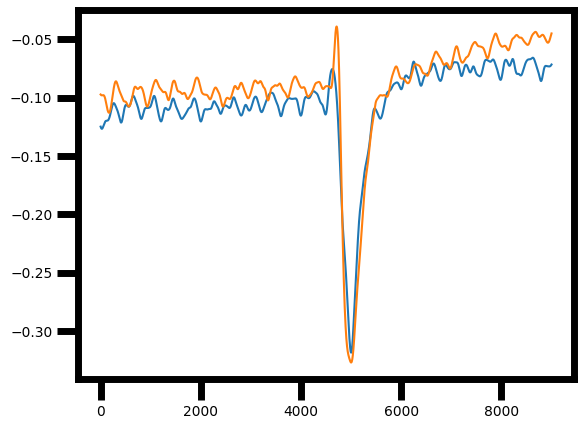

0 300


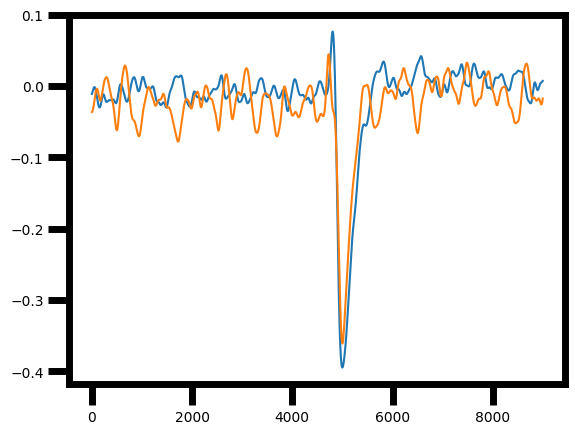

1 300


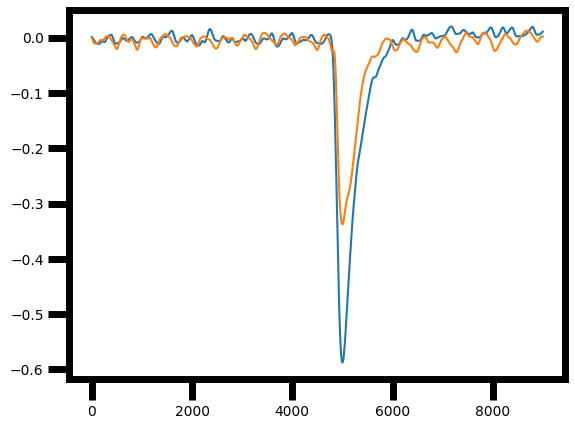

2 300


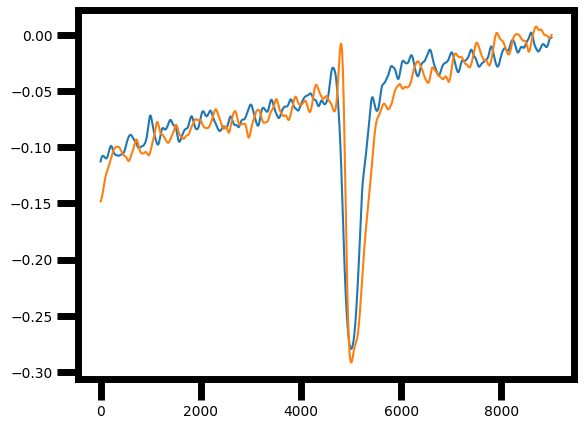

3 300


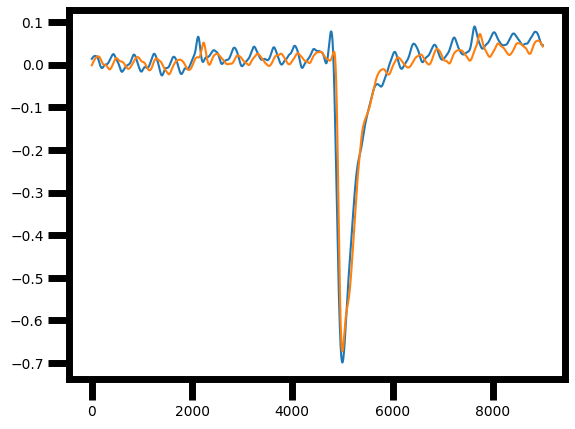

0 400


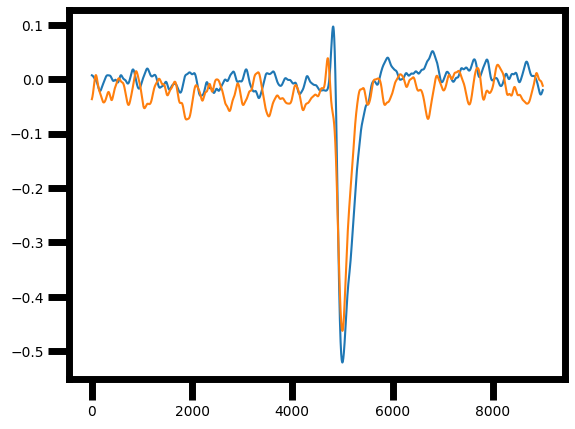

1 400


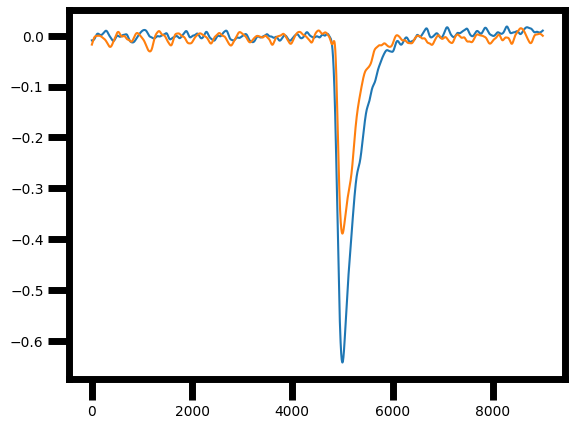

2 400


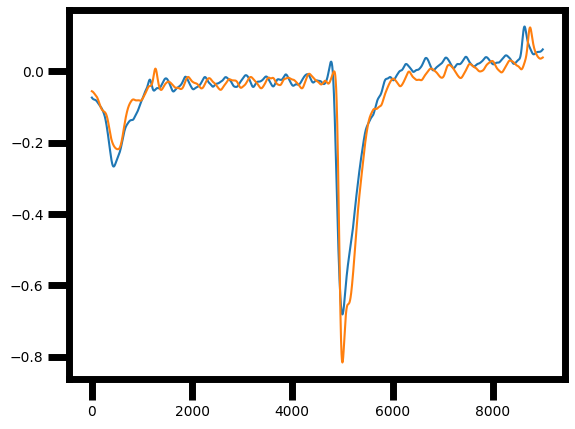

0 500


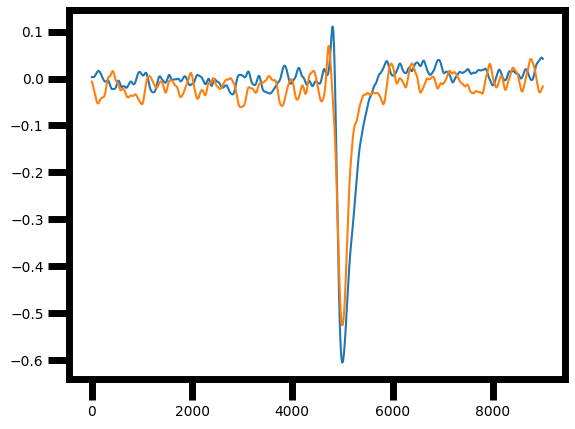

1 500


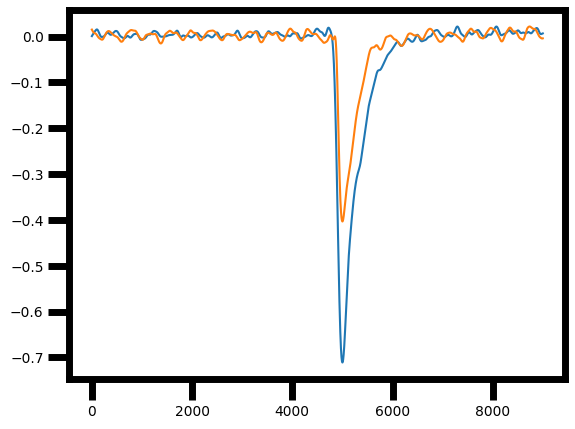

2 500


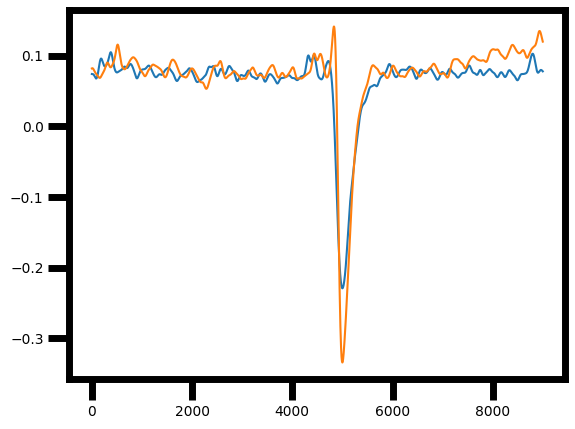

3 500


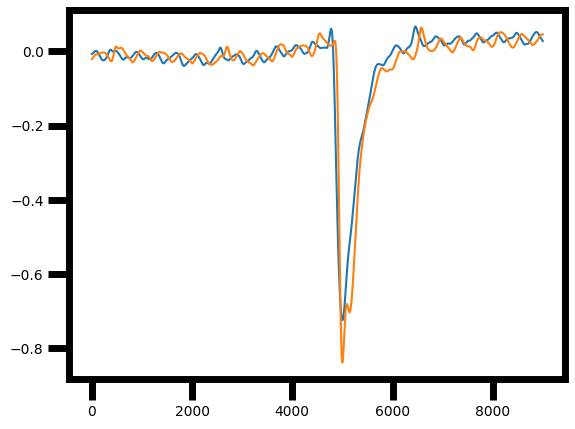

0 600


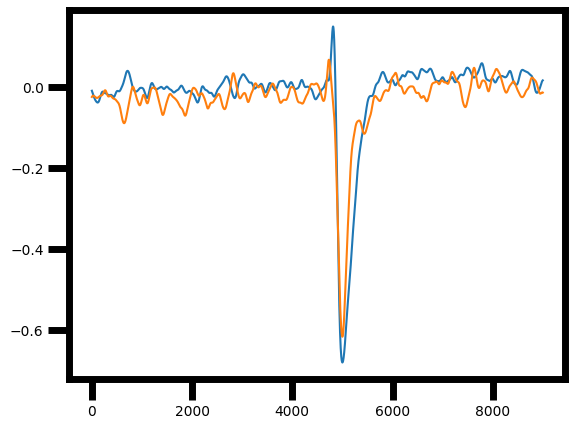

1 600


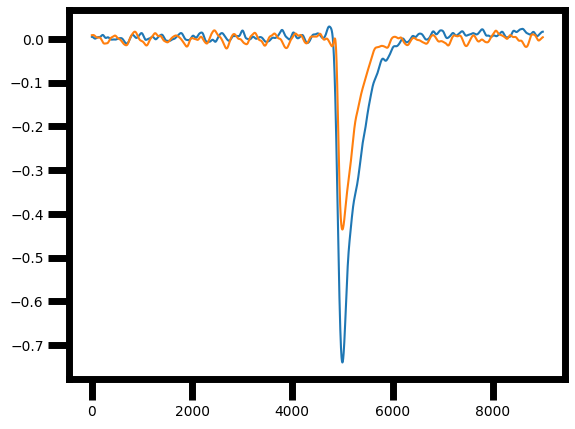

2 600


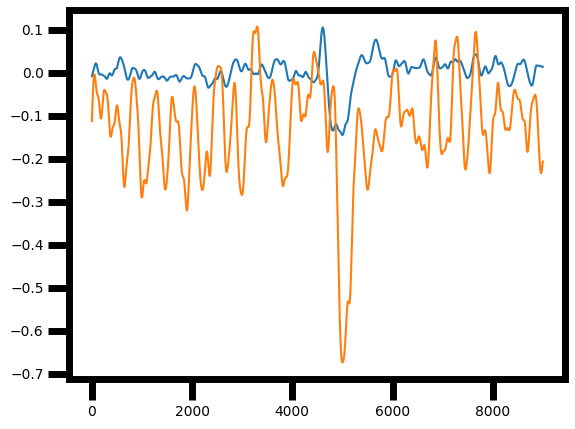

3 600


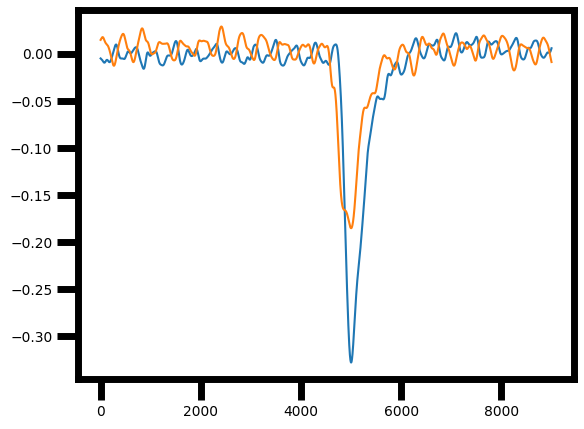

4 600


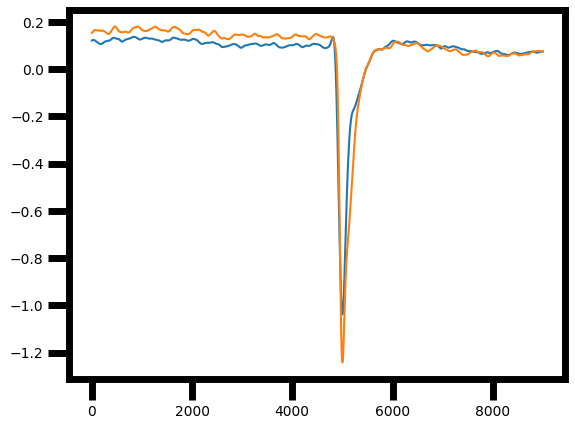

5 600


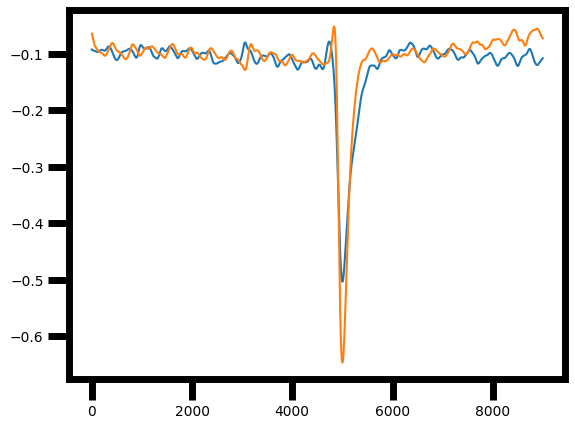

6 600


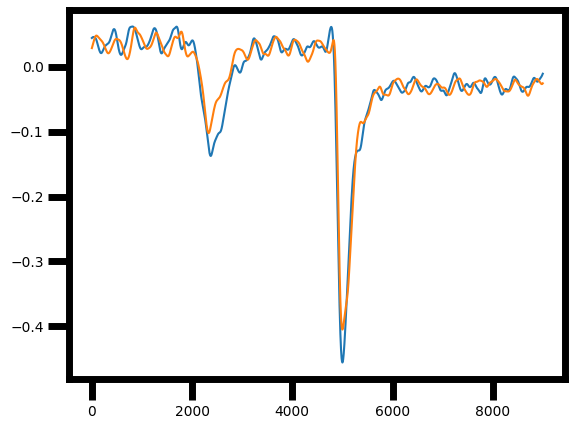

7 600


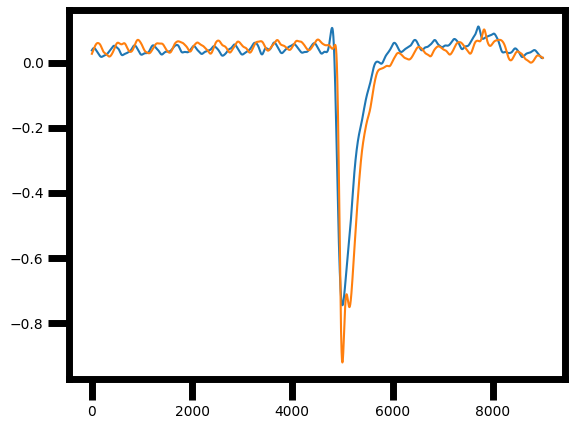

8 600


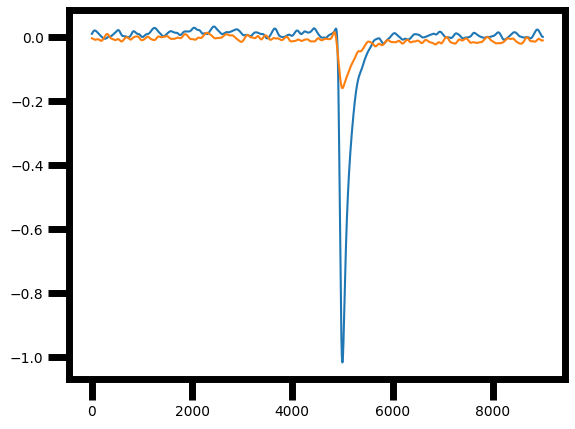

0 700


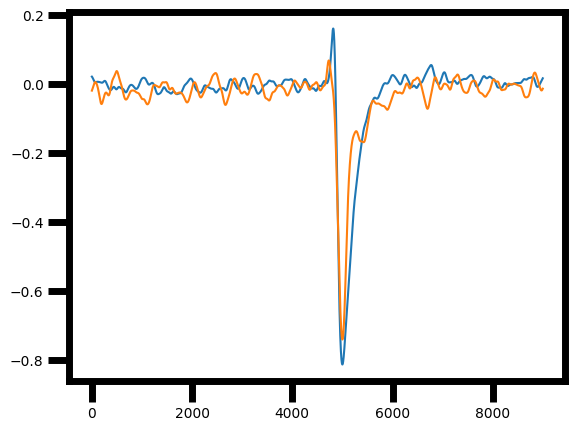

1 700


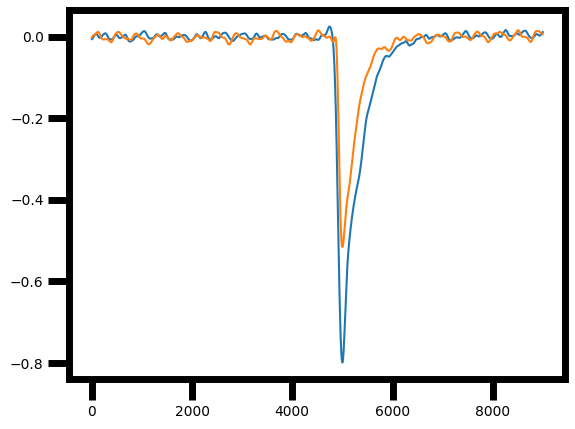

2 700


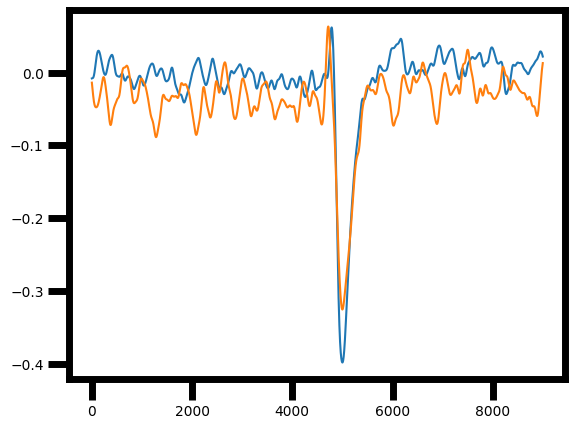

3 700


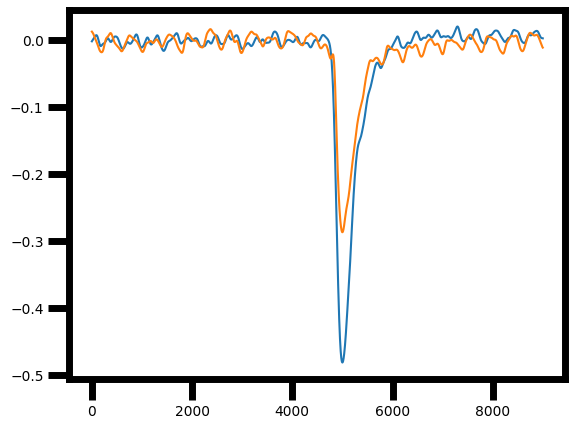

4 700


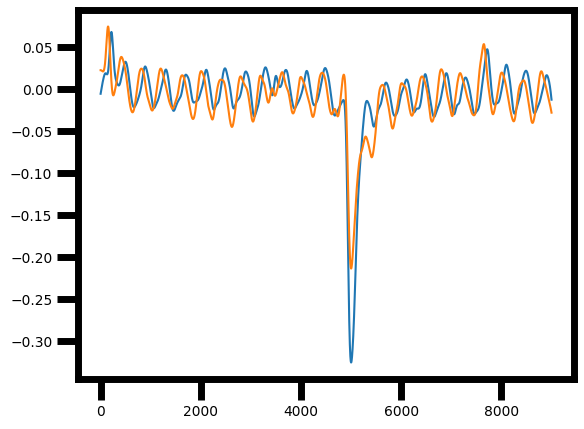

5 700


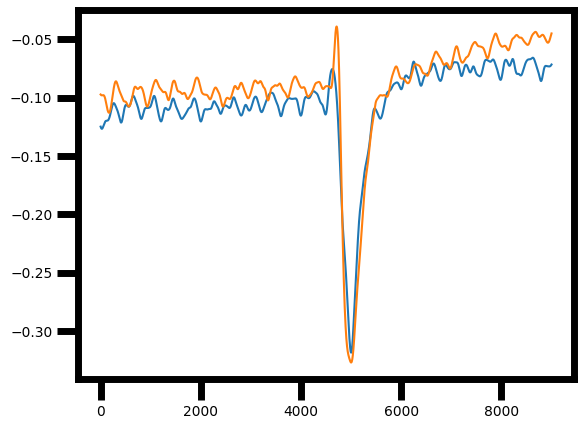

6 700


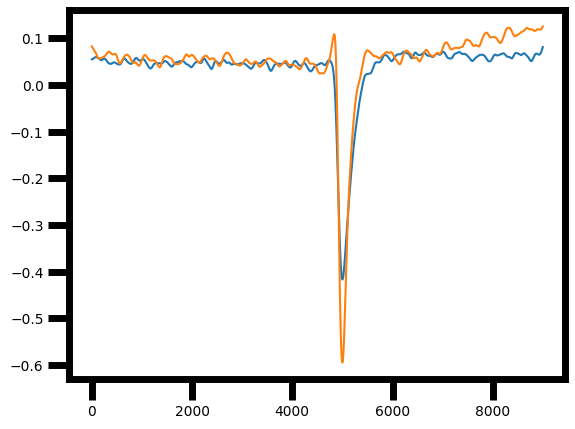

7 700


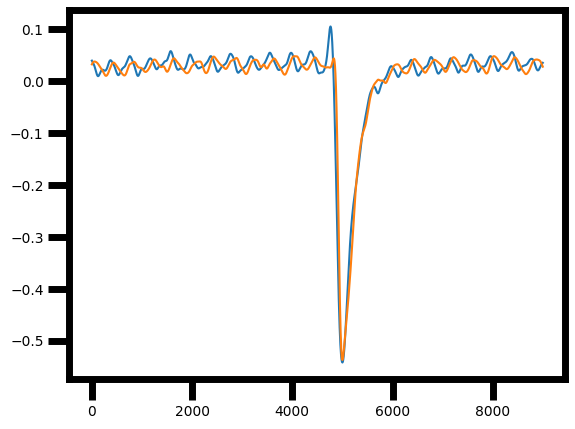

8 700


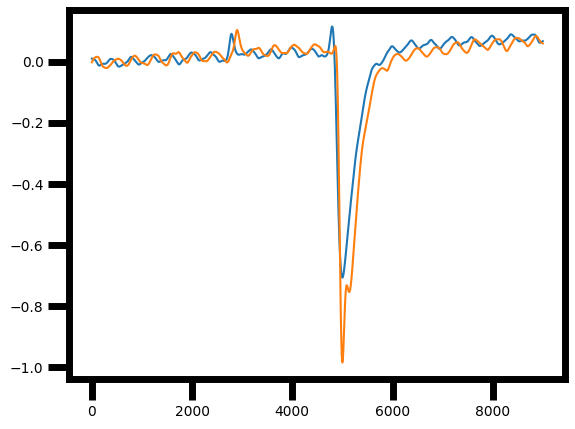

0 800


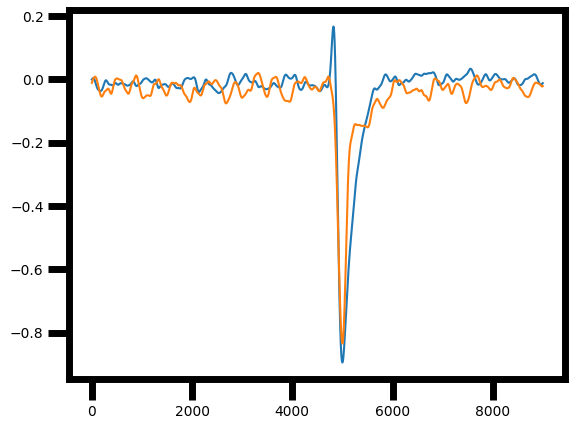

1 800


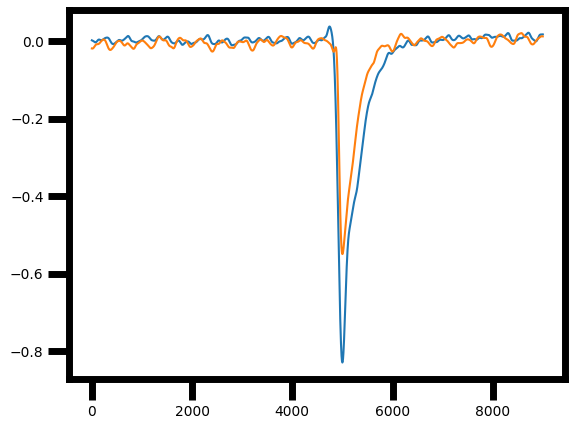

2 800


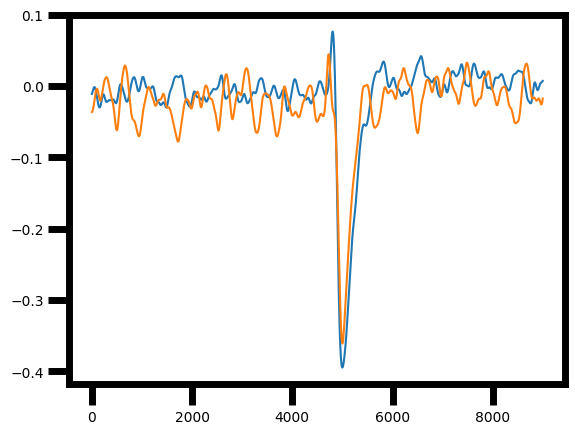

3 800


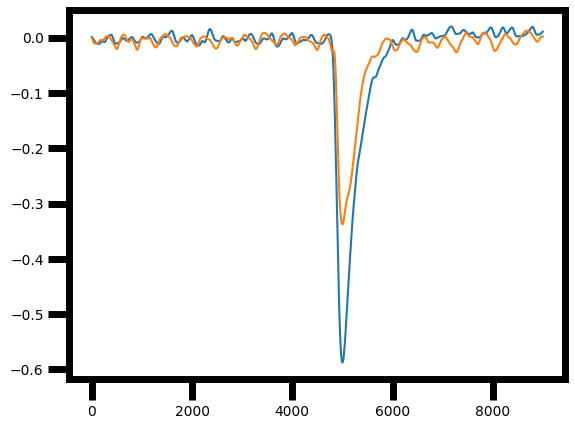

4 800


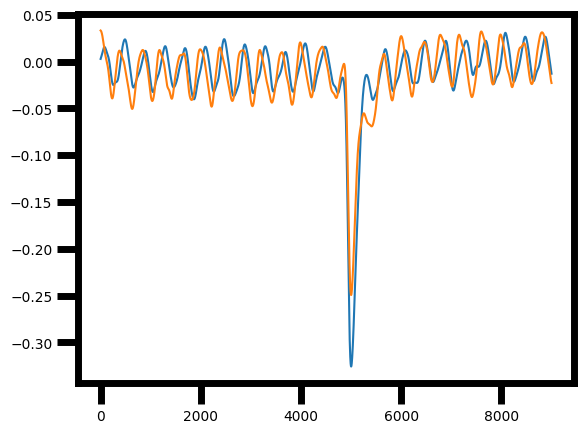

5 800


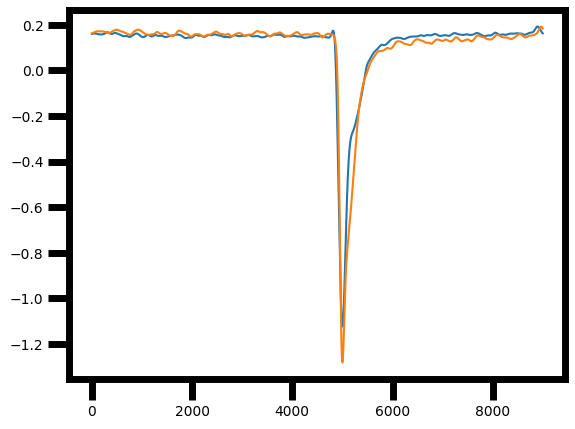

6 800


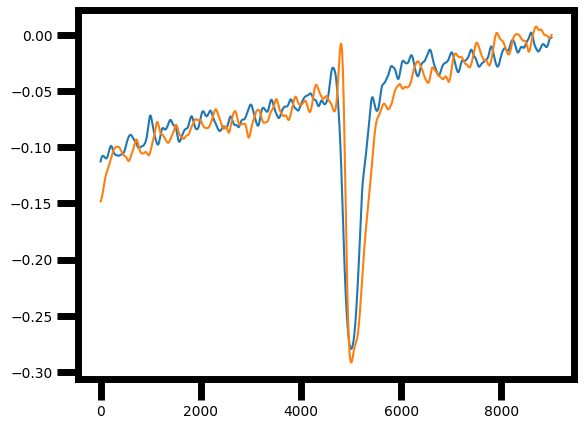

7 800


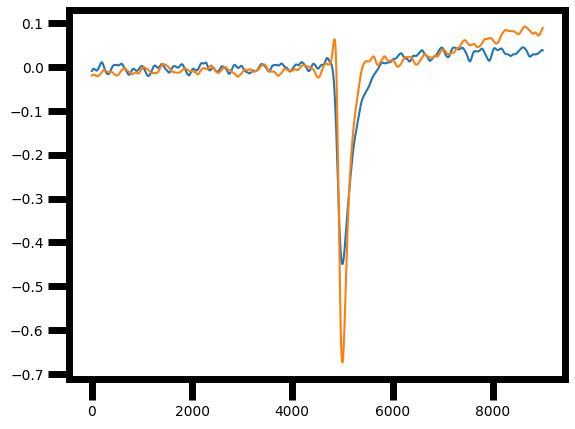

8 800


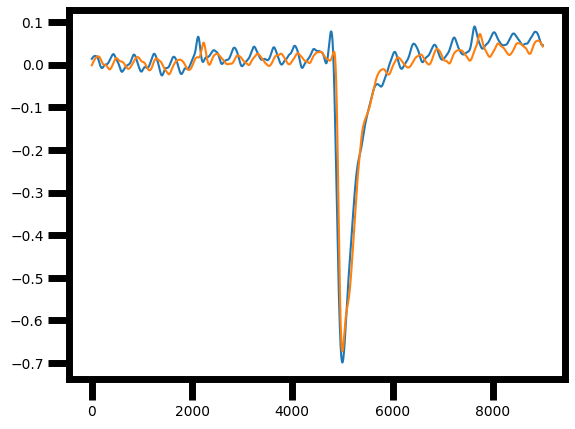

9 800


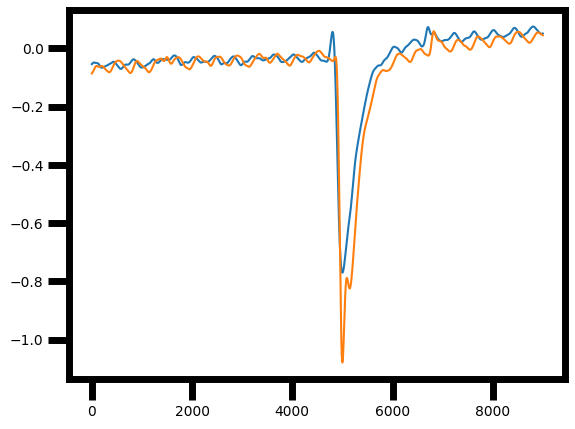

10 800


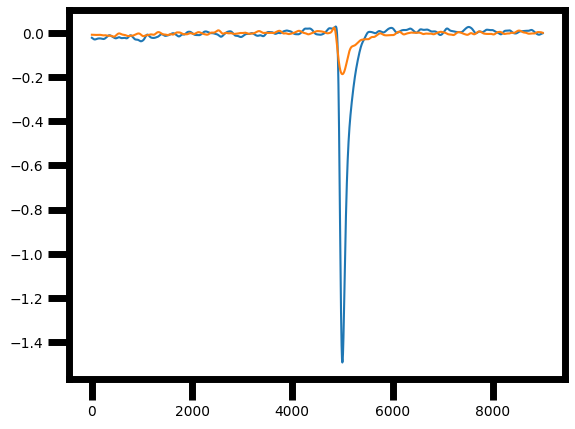

0 900


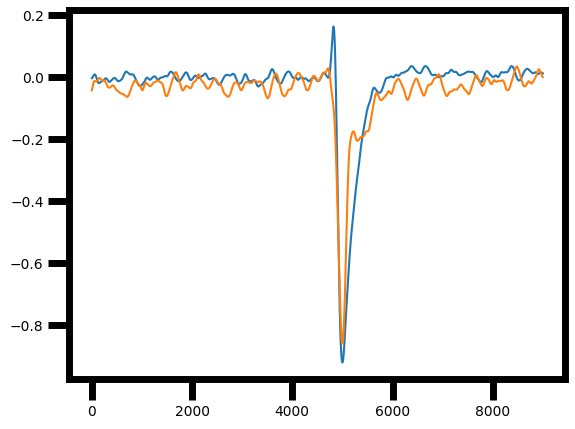

1 900


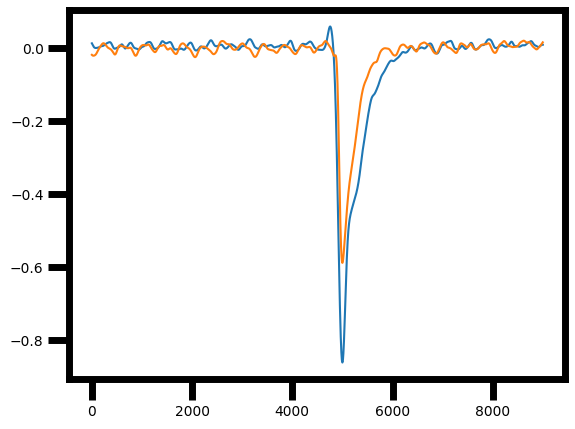

2 900


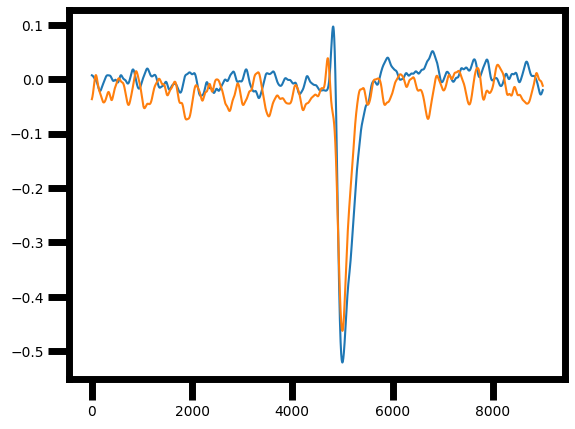

3 900


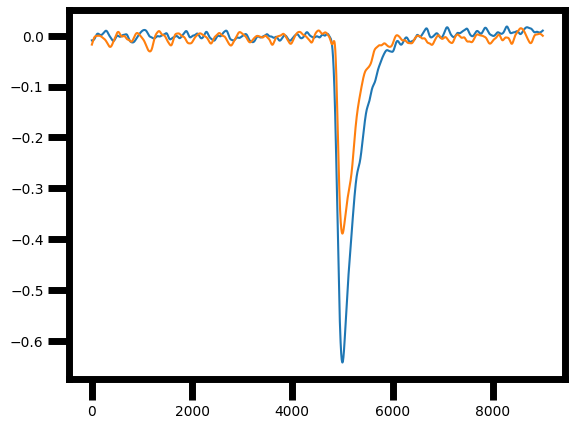

4 900


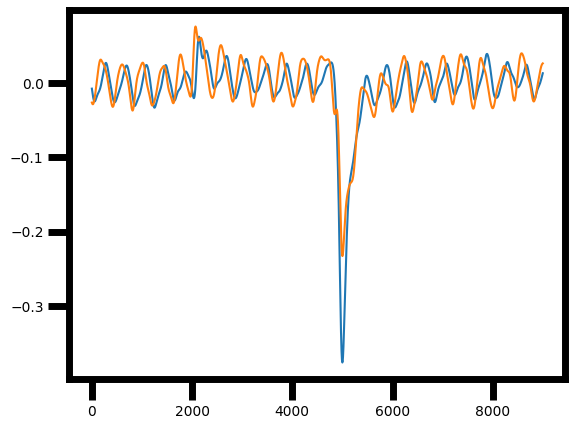

5 900


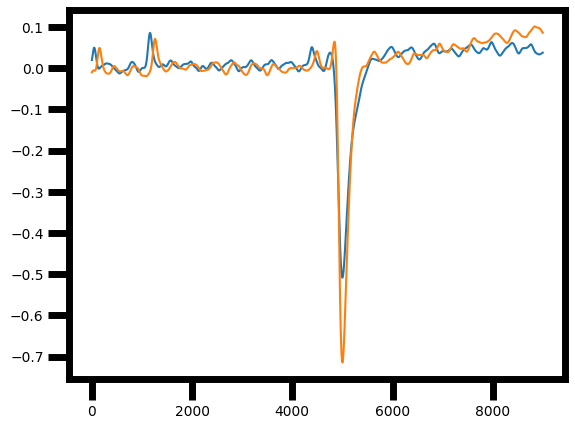

6 900


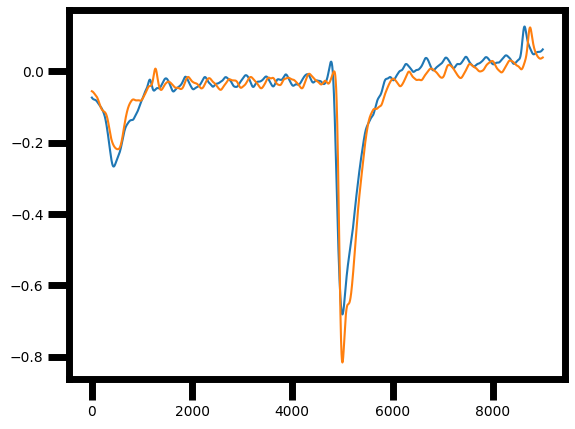

7 900


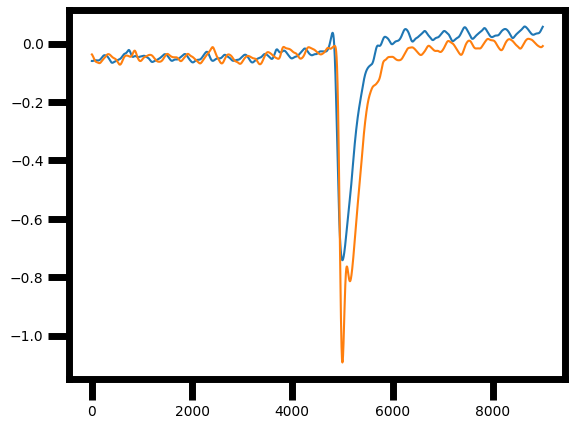

8 900


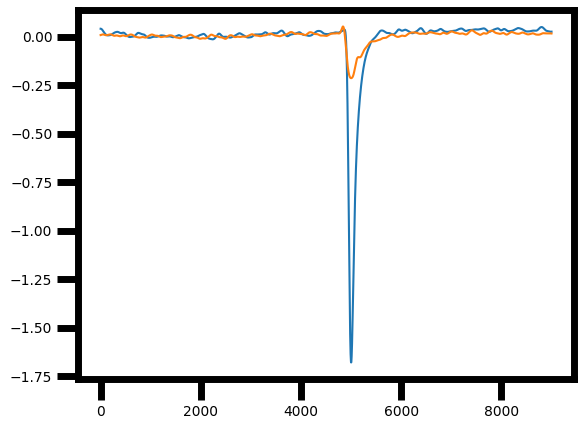

0 1000


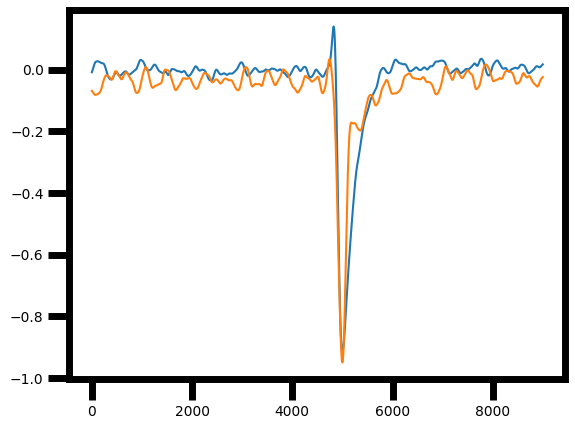

1 1000


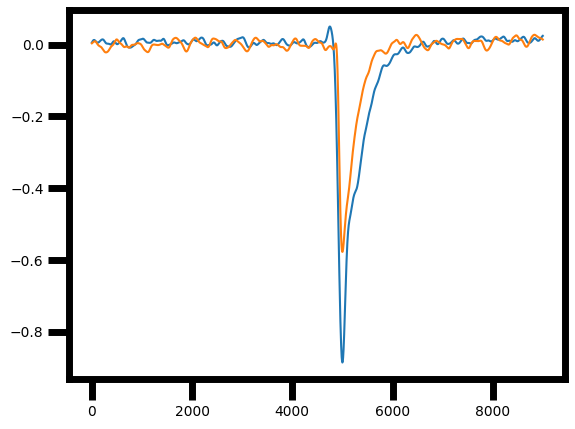

2 1000


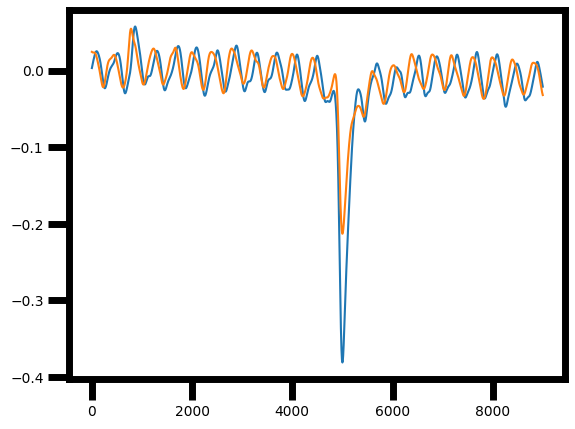

3 1000


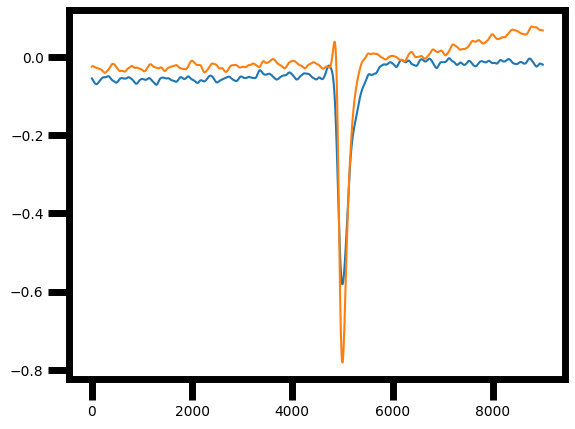

4 1000


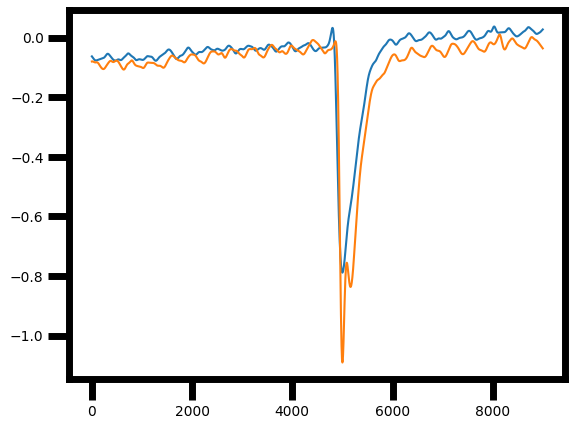

5 1000


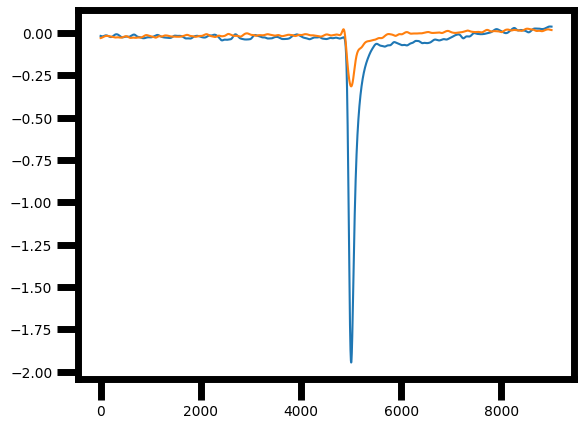

6 1000


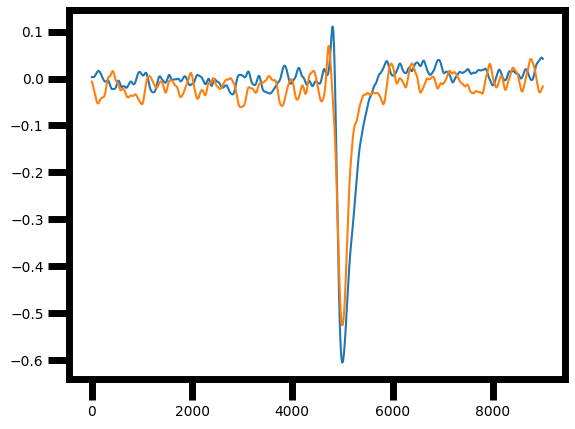

7 1000


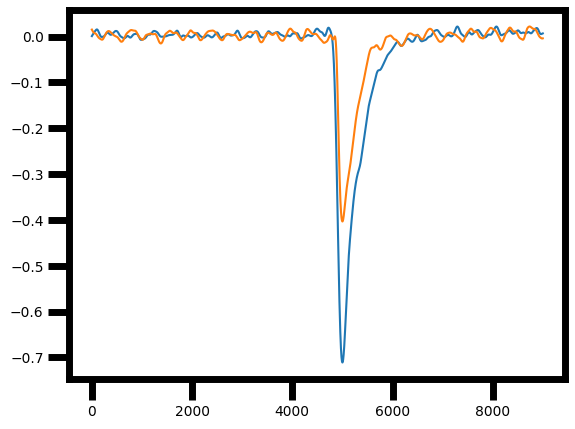

8 1000


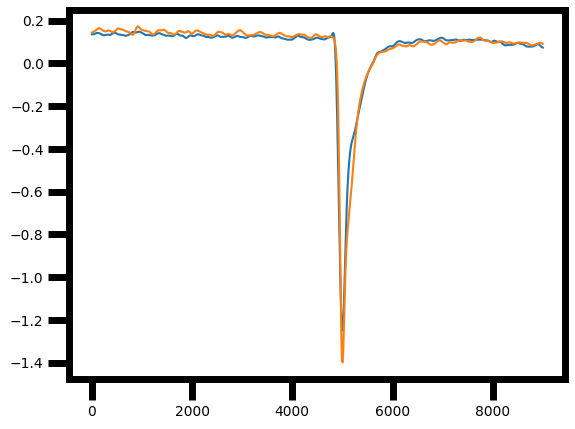

9 1000


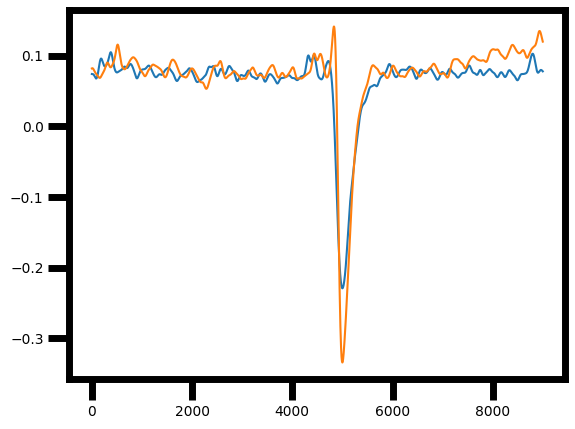

10 1000


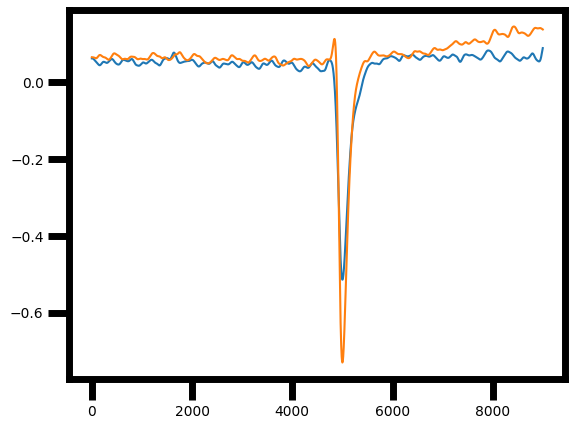

11 1000


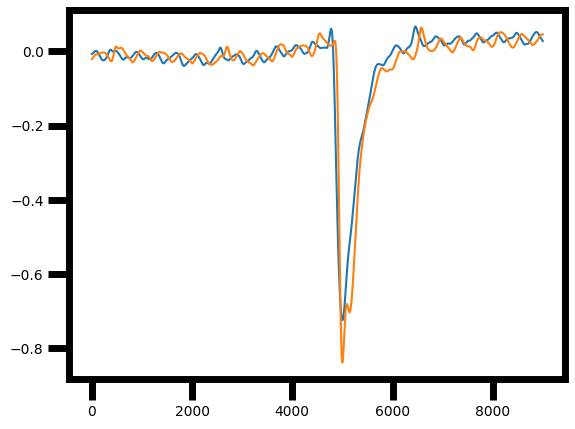

12 1000


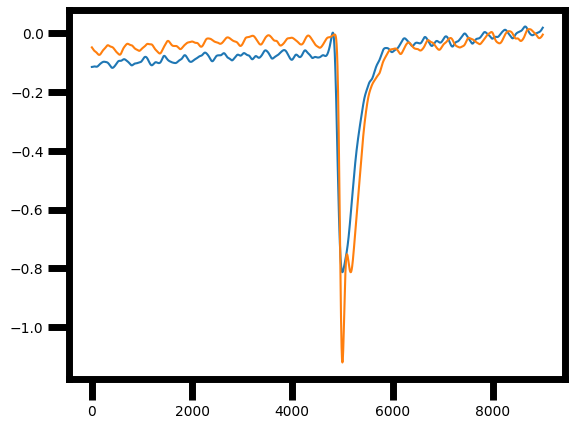

13 1000


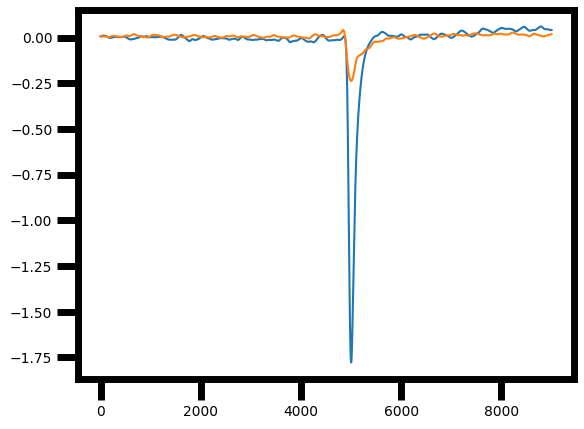

In [830]:
sigs=[]
ampls=[]
av1=[]
av3=[]
allca1=[]
unav3={}
unav1={}
for amp in list(range(100, 1001, 100)):
    averaged1 = []
    averaged3 = []
    for sig, ind in zip(union_data[amp], range(len(union_data[amp])-1)):
        print(ind, amp)
        plt.plot(sig[0][0][:9000])
        plt.plot(sig[0][1][:9000])
        plt.show()
        averaged1.append(sig[0][0][:11000])
        allca1.append(sig[0][0])
        averaged3.append(sig[0][1][:11000])
        if amp not in unav3.keys():
            unav3[amp]=[]
        unav3[amp].append(sig[0][1][:11000])
        if amp not in unav1.keys():
            unav1[amp]=[]
        unav1[amp].append(sig[0][0][:11000])
        sigs.append(sig[0])
        ampls.append(sig[1])
    av1.append(sum(averaged1)/(len(averaged1)))
    av3.append(sum(averaged3)/(len(averaged3)))
        # plt.plot(sig[0])
        # plt.plot(sig[1])
        # plt.title(amp)
        # plt.show()
        # plt.plot(sig[2])
        # plt.title(amp)
        # plt.show()

In [273]:
# folders_test = os.listdir(path=dataPath)

In [832]:
unav3

{100: [array([-0.11277767, -0.10916785, -0.10558249, ..., -0.02125164,
         -0.01999295, -0.01873524]),
  array([ 0.01464293,  0.01472198,  0.01480378, ..., -0.00752322,
         -0.00774612, -0.00797014]),
  array([0.0284808 , 0.02876651, 0.02905483, ..., 0.0170355 , 0.01688334,
         0.01673251])],
 200: [array([-0.01365535, -0.01428453, -0.01492512, ..., -0.01969569,
         -0.01929926, -0.01891139]),
  array([ 0.01300182,  0.01291641,  0.01282911, ..., -0.00854886,
         -0.00860215, -0.00864482]),
  array([-0.09733009, -0.09739394, -0.09745482, ..., -0.04665161,
         -0.04660166, -0.0465499 ])],
 300: [array([-0.03641374, -0.03637034, -0.03631722, ...,  0.00535245,
          0.00554428,  0.00574159]),
  array([-0.00075791, -0.00100075, -0.00124546, ...,  0.00603147,
          0.00615329,  0.00627751]),
  array([-0.148103  , -0.14802821, -0.14794799, ...,  0.01226297,
          0.01240723,  0.01254958]),
  array([-0.00132032, -0.00108507, -0.00084714, ...,  0.045182

In [592]:
np.save("ca3_av.npy", av3)
np.save("ca1_av.npy", av1)

In [276]:
# records_test=[scipy.io.loadmat(dataPath+filename) for filename in folders_test]

In [277]:
# def smooth(a,WSZ):
#     out0 = np.convolve(a,np.ones(WSZ,dtype=int),'valid')/WSZ    
#     r = np.arange(1,WSZ-1,2)
#     start = np.cumsum(a[:WSZ-1])[::2]/r
#     stop = (np.cumsum(a[:-WSZ:-1])[::2]/r)[::-1]
#     return np.concatenate((  start , out0, stop  ))
# def lowpass(signal: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
#     sos = scipy.signal.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
#     return scipy.signal.sosfiltfilt(sos, signal)
# def removeArts(signal, new_data=False):
#     s = signal.copy()
#     if (not new_data):
#         for i in range(5200, 5220):
#             s[i] = s[i-150]
#     else:
#         for i in range(9975, 10100):
#             s[i] = s[i-300]
#     s = lowpass(s, 1000, 20000)
#     s_mean=s.mean()
#     s = standartization(s)
#     if (not new_data):
#         mean = np.mean(s)
#         for i in range(150, 5200):
#             if abs(s[i])>0.0003:
#                 s[i] = s[i-150]
#         for i in range(6000, len(s)):
#             if abs(s[i])>0.0003:
#                 s[i] = mean 
#     s = smooth(s, 11)
#     return s, s_mean
# def standartization(s, needStd = False):
#     if needStd:
#         return np.array((s-s.mean())/s.std())
#     else:
#         return np.array(s-s.mean())
# def gausFilter(signal, sigma = 35):
#     min1 = np.min(signal)
#     gf = gaussian_filter(signal, sigma)
#     min2 = np.min(gf)
#     return gf*min1/min2
# def getAnswer(signal):
#     left = right = np.argmin(signal)
#     mean = np.mean(signal)
#     while signal[left]<mean and left>0:
#         left-=1
#     while signal[right]<mean and right<maxlen:
#         right+=1
#     return [left, right]

In [278]:
# ca1 ={}
# ca1[600]=[]
# ca1[700]=[]
# ca1[800]=[]
# ca3 ={}
# ca3[600]=[]
# ca3[700]=[]
# ca3[800]=[]
# amps_test=[600, 700, 800]
# wa1 = {}
# wa3 = {}
# wan1 = {}
# wan3 = {}
# meanLine1 = {}
# meanLine3 = {}
# normMeanLine1 = {}
# normMeanLine3 = {}
# for a in amps:
#     ca1[a]=[]
#     ca3[a]=[]
#     wa1[a] = []
#     wa3[a] = []
#     wan1[a] = []
#     wan3[a] = []
#     meanLine1[a] = []
#     meanLine3[a] = []
#     normMeanLine1[a] = []
#     normMeanLine3[a] = []

# art_mins = []
# for rec in records_test:
#     for k in rec.keys():
#         if str(k)[0]=='Y':
#             if (str(k)[1]=='1'):
#                 ca1[600].append(rec[str(k)][:,0])
#                 ca3[600].append(rec[str(k)][:,1])
#                 art_mins.append(np.argmin(rec[str(k)][:,0]))
#                 art_mins.append(np.argmin(rec[str(k)][:,1]))
#             if (str(k)[1]=='2'):
#                 ca1[700].append(rec[str(k)][:,0])
#                 ca3[700].append(rec[str(k)][:,1])
#                 art_mins.append(np.argmin(rec[str(k)][:,0]))
#                 art_mins.append(np.argmin(rec[str(k)][:,1]))
#             if (str(k)[1]=='3'):
#                 ca1[800].append(rec[str(k)][:,0])
#                 ca3[800].append(rec[str(k)][:,1])
#                 art_mins.append(np.argmin(rec[str(k)][:,0]))
#                 art_mins.append(np.argmin(rec[str(k)][:,1]))
# for a in [600, 700, 800]:
#     wa1[a] = np.array([removeArts(rec, True)[0] for rec in ca1[a]])
#     wa3[a]= np.array([removeArts(rec, True)[0] for rec in ca3[a]])
#     wa1[a] = [x[4799:16001] for x in wa1[a]]
#     wa3[a] = [x[4799:16001] for x in wa3[a]]
# filt1 = {}
# filt3 = {}
# for a in [600, 700, 800]:
#     filt1[a]=np.array([gausFilter(rec)[0] for rec in wa1[a]])
#     filt3[a]=np.array([gausFilter(rec)[0] for rec in wa3[a]])

In [279]:
# averaged1_test=[]
# averaged3_test=[]
# for amp in amps_test:
#     averaged1_test.append(sum(filt1[amp])/len(filt1[amp]))
#     averaged3_test.append(sum(filt3[amp])/len(filt3[amp]))

In [280]:
# folders = os.listdir(path=dataPath)
# filenames = [dataPath+folder+'/'+filename for folder in folders for filename in os.listdir(path=dataPath+folder)]
# amps = [100, 200, 300, 400, 500, 1000]
# h = {}
# for a in amps:
#     h[a]=[]
# for filename in filenames:    
#     for a in amps:
#         if ' h '+str(a)+' ' in filename or ' h '+str(a)+'.' in filename or ' healthy '+str(a)+' ' in filename or ' healthy '+str(a)+'.' in filename:
#             h[a].append(filename)
# records = {}
# for a in amps:
#     records[a]=[scipy.io.loadmat(filename) for filename in h[a]]

In [281]:
# art_mins = []
# ca1 = {}
# ca3 = {}
# wa1 = {}
# wa3 = {}
# wan1 = {}
# wan3 = {}
# meanLine1 = {}
# meanLine3 = {}
# normMeanLine1 = {}
# normMeanLine3 = {}
# for a in amps:
#     ca1[a]=[]
#     ca3[a]=[]
#     wa1[a] = []
#     wa3[a] = []
#     wan1[a] = []
#     wan3[a] = []
#     meanLine1[a] = []
#     meanLine3[a] = []
#     normMeanLine1[a] = []
#     normMeanLine3[a] = []
# for a in amps:
#     for rec in records[a]:
#         for k in rec.keys():
#             if str(k).endswith('_2'):
#                 ca1[a].append(rec[str(k)][:,1])
#     ca1[a]= np.array(ca1[a])
#     for rec in records[a]:
#         for k in rec.keys():
#             if str(k).endswith('_3'):
#                 ca3[a].append(rec[str(k)][:,1])
#     ca3[a]= np.array(ca3[a])
#     for i in range(len(ca3[a])):
#         art_mins.append(np.argmax(ca3[a][i]))
#         art_mins.append(np.argmax(ca1[a][i]))
#     wa1[a] = np.array([removeArts(rec)[0] for rec in ca1[a]])
#     wa3[a]= np.array([removeArts(rec)[0] for rec in ca3[a]])

#     wan1[a] = np.array([standartization(rec) for rec in wa1[a]])
#     wan3[a] = np.array([standartization(rec) for rec in wa3[a]])

#     meanLine1[a] = sum(wa1[a])/len(wa1[a])
#     normMeanLine1[a] = sum(wan1[a])/len(wan1[a])

#     meanLine3[a] = sum(wa3[a])/len(wa3[a])
#     normMeanLine3[a] = sum(wan3[a])/len(wan3[a])

# maxlen = len(ca1[amps[0]][0])
# means_ca1=[]
# for a in amps:
#     means_ca1.append(np.mean([gausFilter(rec)[1] for rec in ca1[a]]))
    #filt3[a]=np.array([gausFilter(rec) for rec in wa3[a]])

In [282]:
# means_ca1

In [283]:
# plt.plot(ca3[100][0])

In [284]:
# wa1[100]

In [285]:
# filt1 = {}
# filt3 = {}
# for a in amps:
#     filt1[a]=np.array([10000*gausFilter(rec) for rec in wa1[a]])
#     filt3[a]=np.array([10000*gausFilter(rec) for rec in wa3[a]])

In [286]:
# answerUp = {}
# answerDown = {}
# answerBoth = {}
# answerNone = {}
# for a in amps:
#     answerUp[a] = []
#     answerDown[a] = []
#     answerBoth[a] = []
#     answerNone[a] = []
    
# for a in amps:
#     for number in range(len(h[a])):
#         signal = filt1[a][number]
#         argMin = np.argmin(signal)
#         argMax = np.argmax(signal)
#         minS = np.min(signal)
#         maxS = np.max(signal)
#         ext = maxS if abs(maxS)>abs(minS) else minS
#         argExt = argMax if abs(maxS)>abs(minS) else argMin
#         stdS = np.std(signal)
#         if argExt>6250 or argExt<5200 or ((maxS-minS)/stdS)<8 or stdS<0.5:
#             answerNone[a].append(signal)
#         else:
#             if (abs(maxS)/stdS)>2 and (abs(minS)/stdS)>2:
#                 answerBoth[a].append(signal)
#             else:
#                 if (abs(maxS)/stdS)>2:
#                     answerUp[a].append(signal)
#                 else: 
#                     answerDown[a].append(signal)

In [287]:
# all_ca1 = []
# for a in amps:
#     for sig in answerDown[a]:
#         all_ca1.append(list(sig))

In [288]:
# filt1[100]

In [289]:
# stimulUp = {}
# stimulDown = {}
# stimulBoth = {}
# stimulNone = {}
# for a in amps:
#     stimulUp[a] = []
#     stimulDown[a] = []
#     stimulBoth[a] = []
#     stimulNone[a] = []
    
# for a in amps:
#     for number in range(len(h[a])):
#         signal = filt3[a][number]
#         argMin = np.argmin(signal)
#         argMax = np.argmax(signal)
#         minS = np.min(signal)
#         maxS = np.max(signal)
#         ext = maxS if abs(maxS)>abs(minS) else minS
#         argExt = argMax if abs(maxS)>abs(minS) else argMin
#         stdS = np.std(signal)
#         if argExt>6250 or argExt<5200 or ((maxS-minS)/stdS)<8 or stdS<0.5:
#             stimulNone[a].append(signal)
#         else:
#             if (abs(maxS)/stdS)>2 and (abs(minS)/stdS)>2:
#                 stimulBoth[a].append(signal)
#             else:
#                 if (abs(maxS)/stdS)>2:
#                     stimulUp[a].append(signal)
#                 else: 
#                     stimulDown[a].append(signal)

In [290]:
# averaged1=[]
# averaged3=[]
# for amp in amps:
#     averaged1.append(sum(answerDown[amp])/(len(answerDown[amp])*10))
#     averaged3.append(sum(stimulDown[amp])/(len(stimulDown[amp])*10))

In [291]:
#.figure(figsize=(20, 20))
# for ca1, ca3 in zip(averaged1_test, averaged3_test):
#     plt.title("Test averaged signals")
#     plt.plot(ca1, label='ca1', color = 'red')
#     plt.plot(ca3, label='ca3', color = 'blue')
#     plt.legend()
#     plt.show
# plt.savefig("Test_averaged.pdf")

In [292]:
av3

[array([-0.02321798, -0.02189312, -0.02057463, ..., -0.00391312,
        -0.00361858, -0.00332429]),
 array([-0.03266121, -0.03292069, -0.03318361, ..., -0.02496538,
        -0.02483436, -0.02470203]),
 array([-0.04664874, -0.04662109, -0.04658945, ...,  0.01720742,
         0.01729811,  0.01738994]),
 array([-0.03659768, -0.03640191, -0.03620165, ...,  0.01319194,
         0.01325847,  0.01333265]),
 array([0.01749764, 0.01738786, 0.01727693, ..., 0.02973766, 0.029734  ,
        0.02973232]),
 array([ 0.00295063,  0.00344157,  0.00392921, ..., -0.00201918,
        -0.00194269, -0.00186602]),
 array([ 0.00185669,  0.00188023,  0.00190161, ..., -0.00190114,
        -0.00183521, -0.00176657]),
 array([-0.01217591, -0.01209103, -0.01200505, ...,  0.03239593,
         0.03238973,  0.03238525]),
 array([-0.02633158, -0.02620851, -0.02608225, ...,  0.01683262,
         0.01683118,  0.0168322 ]),
 array([0.00449812, 0.00445085, 0.00440247, ..., 0.02717029, 0.02719664,
        0.02722464])]

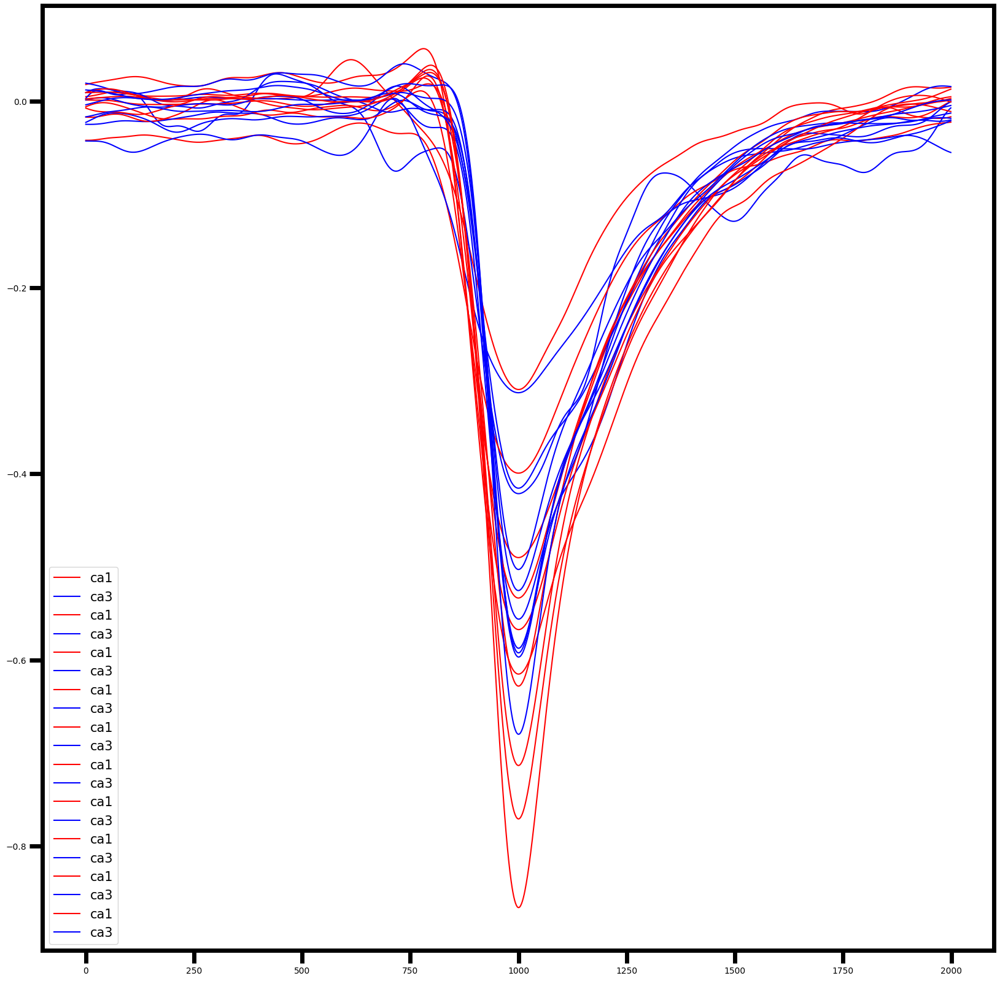

In [677]:
plt.figure(figsize=(20,20))
for ca1, ca3 in zip(av1, av3):
    plt.plot(ca1[4000:6000], label='ca1', color='red')
    plt.plot(ca3[4000:6000], label='ca3', color='blue')
    plt.legend(fontsize=15)
plt.savefig("Train_signals_ca1.png")    

In [562]:
av3 = np.load("av3_new.npy")
av1 = np.load("av1_new.npy")

In [620]:
len(av1)

10

In [624]:
np.save("av3_new_only.npy", av3)
np.save("av1_new_only.npy", av1)

In [295]:
avg = {}
avg['ca3'] = averaged3
avg['ca1'] = averaged1
avg['slope'] = [-11.8214, 9.2575, -9.2297, -9.0112, -8.8669, -6.7653]
avg['time_rise'] = [5.95, 5.65, 5.7, 5.65, 5.5, 5.5]
avg['time_descrease'] = [69.45, 91.7, 79.8, 79.65, 67.95, 88.8]
avg['answer_halfwidth'] = [8.75, 8.35, 7.75, 7.6, 8.05, 8.4]


In [296]:
scipy.io.savemat("100-500_1000_averaged.mat", avg)

In [297]:
scipy.io.loadmat("100-500_1000_averaged.mat")

{'__header__': b'MATLAB 5.0 MAT-file Platform: nt, Created on: Mon Apr  8 15:20:28 2024',
 '__version__': '1.0',
 '__globals__': [],
 'ca3': array([[-0.06935821, -0.06958702, -0.06981603, ..., -0.02866082,
         -0.02813722, -0.0276136 ],
        [ 0.0033616 ,  0.00348746,  0.00361396, ...,  0.01481628,
          0.01480752,  0.01479585],
        [ 0.02447833,  0.02442124,  0.02436465, ..., -0.02421964,
         -0.0244481 , -0.02467163],
        ...,
        [-0.02069943, -0.0206548 , -0.02060185, ...,  0.04019486,
          0.040123  ,  0.04005684],
        [-0.04829247, -0.04854749, -0.04880552, ...,  0.00822747,
          0.00856183,  0.00889611],
        [ 0.00810071,  0.00805967,  0.00801549, ...,  0.01554394,
          0.01573065,  0.01591782]]),
 'ca1': array([[-0.00872091, -0.00827893, -0.00782904, ...,  0.04242975,
          0.04259017,  0.04274428],
        [ 0.00542029,  0.00569467,  0.00596774, ...,  0.02414707,
          0.0242166 ,  0.02428181],
        [ 0.00328853, 

In [678]:
def normMetrics(signal, maxlen=MAXLEN):
    if abs(signal[np.argmin(signal)]) >= abs(signal[np.argmax(signal)]):
        left = right = argmin = semiLeft = semiRight = np.argmin(signal) #if absmax>absmin {argmax or argmin} #flag: min or max 
        minValue = signal[argmin]
        semiMin = minValue/2
        mean = np.mean(signal)
        found = False
        while signal[left]<mean and left>0: #>mean
            left-=1
            if (signal[left]>semiMin) and not found:
                semiLeft = left
                found = True
        found = False
        while signal[right]<mean and right<len(signal)-1: #>mean
            right+=1
            if (signal[right]>semiMin) and not found:
                semiRight = right
                found = True
        #SL = np.degrees(np.arctan((argmin-left) / (20*minValue)))
        SL = (argmin-left) / (abs(minValue))
        HW = (semiRight-semiLeft)
        TR = (argmin - left)
        #TR = argmin - np.argmax(signal)
        TD = (right - argmin)
        MV = minValue
    else:
        left = right = argmax = semiLeft = semiRight = np.argmax(signal) #if absmax>absmin {argmax or argmin} #flag: min or max 
        maxValue = signal[argmax]
        semiMin = maxValue/2
        mean = np.mean(signal)
        found = False
        while signal[left]>mean and left>0: 
            left-=1
            if (signal[left]>semiMin) and not found:
                semiLeft = left
                found = True
        found = False
        while signal[right]>mean and right<len(signal)-1: #>mean
            right+=1
            if (signal[right]>semiMin) and not found:
                semiRight = right
                found = True
        SL = (argmax-left) / maxValue
        HW = semiRight-semiLeft
        TD = argmax - left
        TR = right - argmax
        MV = maxValue
        
    return [SL, HW, TD, TR, MV]

In [679]:
SL=[]
HW=[]
TD=[]
TR=[]
MV = []
for sig in allca1:
    allMetrics = normMetrics(sig)
    SL.append(allMetrics[0])
    HW.append(allMetrics[1])
    TD.append(allMetrics[2])
    TR.append(allMetrics[3])
    MV.append(allMetrics[4])
minSL=min(SL)
maxSL=max(SL)
minHW=min(HW)
maxHW=max(HW)
minTD=min(TD)
maxTD=max(TD)
minTR=min(TR)
maxTR=max(TR)
minMV=min(MV)
maxMV=max(MV)

In [680]:
minSL = 82.16169471410727 
maxSL = 17145.802464672874
minHW = 2 
maxHW = 465 
minTD = 239 
maxTD = 10553
minTR = 106 
maxTR = 5000
minMV = -1.399679015874223 
maxMV = 0.08858223392367837

In [681]:
maxTR

5000

In [682]:
def getMetrics(signal, maxlen=MAXLEN, print_metrics=False, need_norm=True):
    left = right = argmin = semiLeft = semiRight = np.argmin(signal)
    print(argmin, len(signal))
    minValue = signal[argmin]
    semiMin = minValue/2
    mean = np.mean(signal)
    found = False
    while signal[left]<mean and left>0:
        left-=1
        if (signal[left]>semiMin) and not found:
            semiLeft = left
            found = True
    found = False
    while signal[right]<mean and right<len(signal)-1:
        right+=1
        if (signal[right]>semiMin) and not found:
            semiRight = right
            found = True
    if print_metrics:
        SL = (argmin-semiLeft)/(20*abs(minValue))
        # HW = (semiRight-semiLeft)/20
        # TD = (right - argmin)/20
        # TR = (argmin-left)/20
        return [SL, left, right, semiLeft, semiRight]
    else:
        SL = (argmin-semiLeft) / abs(minValue)
        #SL = (SL-minSL)/(maxSL-minSL)
        HW = semiRight-semiLeft
        #HW = (HW-minHW)/(maxHW-minHW)
        TD = right - argmin
        #TD = (TD-minTD)/(maxTD-minTD)
        #print("TD is", TD)
        TR = argmin - left
        #print("TR before norm", TR)
        #TR = (TR-minTR)/(maxTR-minTR)
        #print("TR is", TR)
        MV = (minValue - minMV)/(maxMV-minMV)
        if need_norm:
            SL = (SL-minSL)/(maxSL-minSL)
            HW = (HW-minHW)/(maxHW-minHW)
            TD = (TD-minTD)/(maxTD-minTD)
            TR = (TR-minTR)/(maxTR-minTR)
            MV = (minValue - minMV)/(maxMV-minMV)
    #coefs = [0.05, 0.3, 0.05, 0.3, 0.3]
    #coefs=[0.5, 0.5]
    # = [0.1, 0.4, 0.1, 0.4]
    #metric = coefs[0]*SL+coefs[1]*HW+coefs[2]*TD+coefs[3]*TR+coefs[4]*MV
    #metric = coefs[0]*HW
    return [SL, HW, TD, TR, MV]

In [560]:
# X_test = averaged3[num_test].reshape(-1, 1)
# Y_test = averaged1[num_test].reshape(-1, 1)


# X_tr = np.delete(averaged3, num_test, 0)
# Y_tr = np.delete(averaged1, num_test, 0)

# X_train=[]
# Y_train=[]
# for i in range(len(X_tr)):
#     X_train.append(X_tr[i].reshape(-1, 1))
#     Y_train.append(Y_tr[i].reshape(-1, 1))
# # X_train = averaged3[1].reshape(-1, 1)
# # Y_train = averaged1[1].reshape(-1, 1)

In [561]:
av3 = np.load("av_all3.npy")
av1 = np.load("av_all1.npy")

In [683]:
for sig in av3:
    print(len(sig))

11000
11000
11000
11000
11000
11000
11000
11000
11000
11000


In [684]:
def prepare_test(num_test):

    start, stop = 0, 9000
    X_test = av3[num_test]
    Y_test = av1[num_test]
    #print(Y_test)
    
    X_tr = np.delete(av3, num_test, 0)
    Y_tr = np.delete(av1, num_test, 0)

    X_train=[]
    Y_train=[]
    # for i in range(len(X_tr)):
    #     X_train.append(X_tr[i].reshape(-1, 1))
    #     Y_train.append(Y_tr[i].reshape(-1, 1))
    # X_train = averaged3[1].reshape(-1, 1)
    # Y_train = averaged1[1].reshape(-1, 1)
    
    X_train_1=[]
    Y_train_1=[]
    Y_train_1=[]
    X_train_1=[]
    start, stop = 0, 9000
    for i in range(9):
        diff = np.argmin(Y_tr[i])-np.argmin(X_tr[i])
        Y_train_1.append(Y_tr[i][diff:stop+diff].reshape(-1, 1))
        X_train_1.append(X_tr[i][:stop].reshape(-1, 1))
        #print(len(X_train_1[i]))
    # for i in range(len(X_tr)
    #     X_train_1.append(X_tr[i].reshape(-1, 1))
    #     Y_train_1.append(Y_tr[i].reshape(-1, 1))
    diff = np.argmin(Y_test)-np.argmin(X_test)
    Y_test = Y_test[diff:stop+diff].reshape(-1, 1)
    X_test = X_test[:stop].reshape(-1, 1)
    return X_train_1, Y_train_1, X_test, Y_test

In [307]:
#reservoir = Reservoir(25, lr=0.7, sr=0.1)

In [308]:
# i=2
# plt.figure(figsize=(10, 3))
# plt.title("Train CA1 and CA3")
# plt.xlabel("$t$")
# plt.plot(X_train_1[i], label="CA3", color="blue")
# plt.plot(Y_train_1[i], label="CA1", color="red")
# plt.legend()
# plt.show()

In [309]:
#averaged3_test

In [310]:
params = list(range(25, 500, 50))
sparcity = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
av_metric = 100000
best_param = 0
best_connectivity = 0
for param in params:
    for sparce in sparcity:
        reservoir = Reservoir(param, lr = 0.6, sr=0.1, rc_connectivity=sparce)
        readout = Ridge(ridge=1e-7)
        start, stop = 0, 11000
        segment = [start, stop]
        metrs=[]
        for sig in range(len(averaged1)):
            X_train, Y_train, X_test, Y_test = prepare_test(sig)
            print(f'Sig {sig}, param {param}, sparce {sparce} running...')
            for i in range(len(X_train)):
                train_states = reservoir.run(X_train[i], reset=False)
                readout = readout.fit(train_states, Y_train[i])
        
            test_states = reservoir.run(X_test)
            Y_pred = readout.run(test_states)

            plt.figure(figsize=(10, 10))
            plt.plot(Y_pred, label='predicted ca1')
            plt.plot(Y_test, label='real ca1')
            #plt.plot(Y_train[-1], label='last given')
            plt.legend()
            plt.show()
            reservoir = reservoir.reset()

            [SL1, HW1, TD1, TR1, MV1] = getMetrics(Y_pred[0])
            [SL2, HW2, TD2, TR2, MV2] = getMetrics(Y_test)
            print(SL1, HW1, TD1, TR1)
            print(SL2, HW2, TD2, TR2)
            # # metrs.append(0.1*(SL1-SL2)**2 + 0.3*(HW1-HW2)**2 + 0.4*(TD1-TD2)**2 + 0.1*(TR1-TR2)**2 + 0.1*(MV1-MV2)**2)
            # # print(0.1*(SL1-SL2)**2 + 0.3*(HW1-HW2)**2 + 0.1*(TD1-TD2)**2 + 0.1*(TR1-TR2)**2 + 0.4*(MV1-MV2)**2)

            # metrs.append(0.1*(SL1-SL2)**2 + 0.5*(HW1-HW2)**2 + 0.3*(TD1-TD2)**2 + 0.1*(TR1-TR2)**2)
            # print(0.1*(SL1-SL2)**2 + 0.5*(HW1-HW2)**2 + 0.3*(TD1-TD2)**2 + 0.1*(TR1-TR2)**2)

        if (av_metric > np.mean(metrs)):
            av_metric = np.mean(metrs)
            best_param = param
            best_connectivity = sparce

Sig 0, param 25, sparce 0.1 running...


Running Reservoir-177:  23%|███████████▉                                        | 2065/9000 [00:00<00:00, 23266.14it/s]


KeyboardInterrupt: 

In [91]:
os.chdir('amps')

In [311]:
os.listdir

<function nt.listdir(path=None)>

sig 0, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-268: 100%|██████████| 9000/9000 [00:00<00:00, 33775.46it/s]


5000 9000
4996 9000
5000 9000
4996 9000
[0.01714423] 0.6349892008639308 0.035582703121970136 0.031875766244380876
[0.00587116] 0.6263498920086393 0.06098506883847198 0.012668573763792398
5000 9000
4996 9000


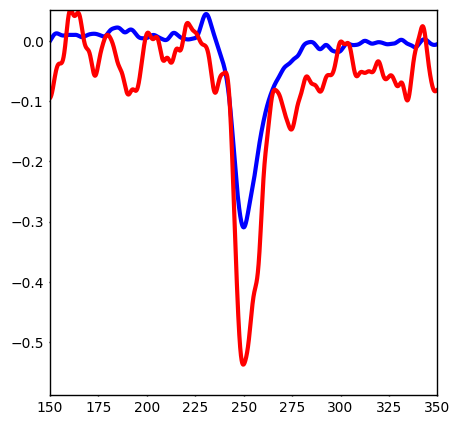

sig 1, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-269: 100%|██████████| 9000/9000 [00:00<00:00, 35444.22it/s]


5000 9000
5000 9000
5000 9000
5000 9000
[0.01396695] 0.7257019438444925 0.044017839829358155 0.022067838169186758
[0.01580665] 0.9892008639308856 0.04508435136707388 0.023293829178586023
5000 9000
5000 9000


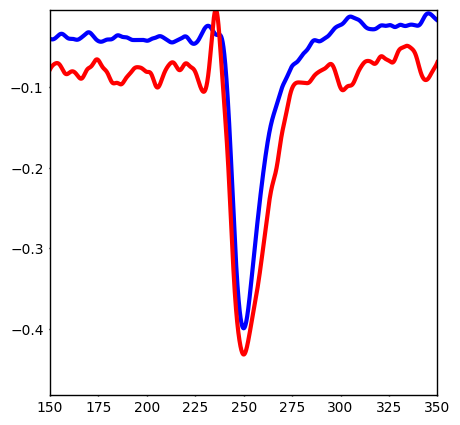

sig 2, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-270: 100%|██████████| 9000/9000 [00:00<00:00, 28434.10it/s]


5000 9000
4992 9000
5000 9000
4992 9000
[0.00857858] 0.714902807775378 0.04944735311227458 0.015120555782590927
[0.00548794] 0.7213822894168467 0.051192553810354854 0.008377605230894973
5000 9000
4992 9000


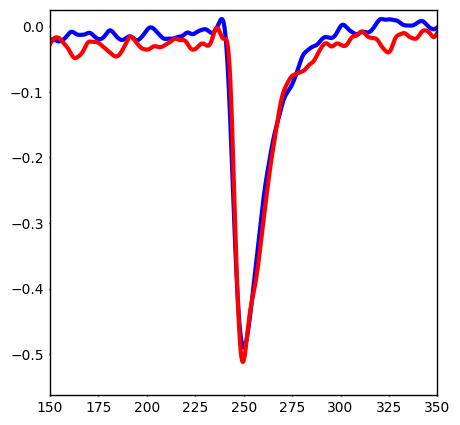

sig 3, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-271: 100%|██████████| 9000/9000 [00:00<00:00, 33865.57it/s]


5000 9000
4995 9000
5000 9000
4995 9000
[0.00490221] 0.7494600431965442 0.05148342059336824 0.011851246424192888
[0.00151526] 0.652267818574514 0.04421175101803374 0.008377605230894973
5000 9000
4995 9000


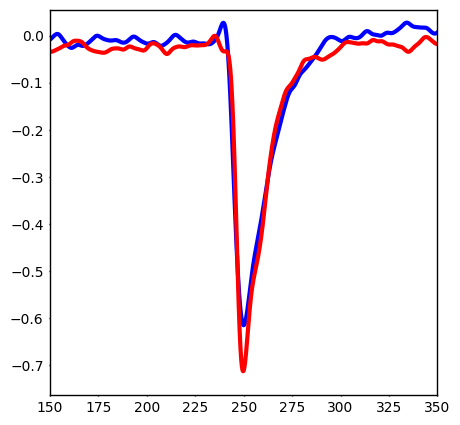

sig 4, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-272: 100%|██████████| 9000/9000 [00:00<00:00, 27177.62it/s]


5000 9000
5000 9000
5000 9000
5000 9000
[0.00603042] 0.6997840172786177 0.05400426604615086 0.01328156926849203
[0.00376935] 0.7710583153347732 0.06437851464029475 0.007968941561095219
5000 9000
5000 9000


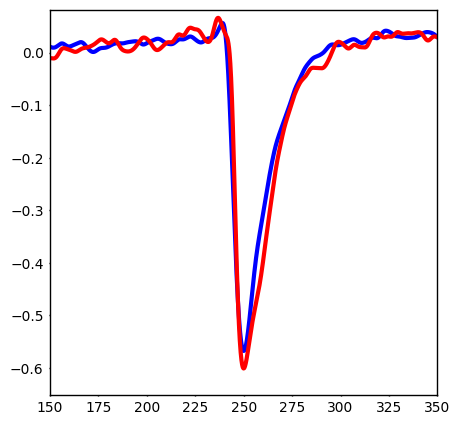

sig 5, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-273: 100%|██████████| 9000/9000 [00:00<00:00, 27799.04it/s]


5000 9000
4999 9000
5000 9000
4999 9000
[0.00311633] 0.5248380129589633 0.04285437269730463 0.012259910093992644
[0.00165987] 0.6004319654427646 0.061663757998836534 0.008377605230894973
5000 9000
4999 9000


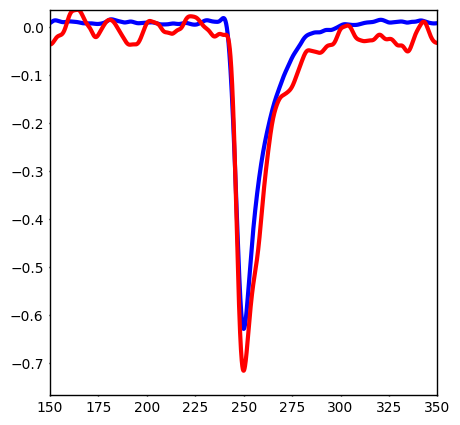

sig 6, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-274: 100%|██████████| 9000/9000 [00:00<00:00, 20462.30it/s]


5000 9000
4997 9000
5000 9000
4997 9000
[0.00617056] 0.6393088552915767 0.0535194880744619 0.013077237433592154
[0.00279764] 0.6047516198704104 0.06680240449873957 0.013077237433592154
5000 9000
4997 9000


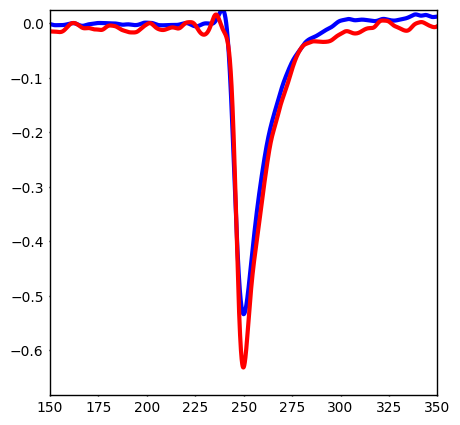

sig 7, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-275: 100%|██████████| 9000/9000 [00:00<00:00, 36580.86it/s]


5000 9000
4991 9000
5000 9000
4991 9000
[0.00200417] 0.5161987041036717 0.04779910800853209 0.010829587249693502
[0.00108606] 0.5853131749460043 0.0577855342253248 0.007151614221495709
5000 9000
4991 9000


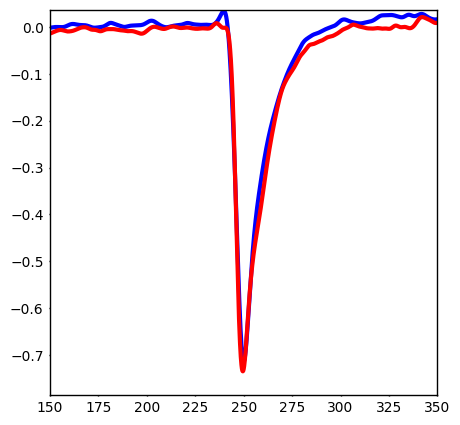

sig 8, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-276: 100%|██████████| 9000/9000 [00:00<00:00, 29817.14it/s]


5000 9000
4997 9000
5000 9000
4997 9000
[0.00126845] 0.5161987041036717 0.0506108202443281 0.009603596240294238
[0.00064016] 0.5053995680345572 0.05070777583866589 0.00858193706579485
5000 9000
4997 9000


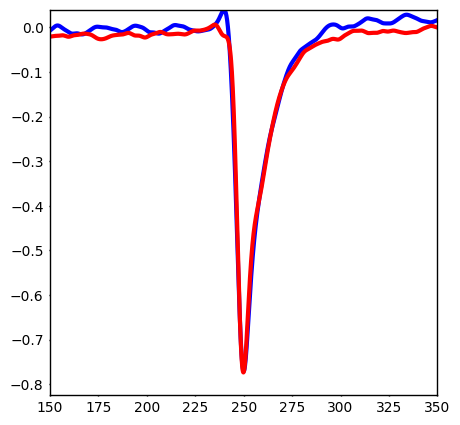

sig 9, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


Running Ridge-277: 100%|██████████| 9000/9000 [00:00<00:00, 35344.73it/s]


5000 9000
5000 9000
5000 9000
5000 9000
[0.00039643] 0.45788336933045354 0.048283885980221056 0.010420923579893748
[0.00034641] 0.5593952483801296 0.06273026953655225 0.0053126277073968125
5000 9000
5000 9000


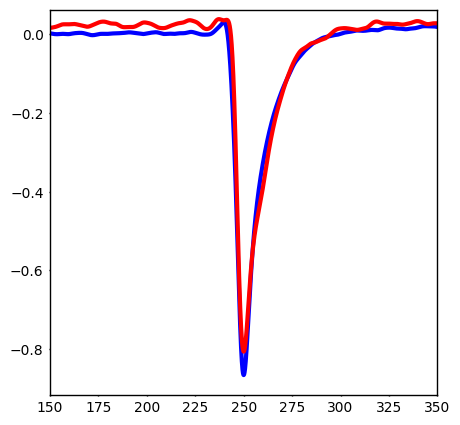

sig 10, size1= 10, size2= 10, sparce1= 0.6, sparce2= 0.8, sr1= 0.8, sr2= 0.1 running...      av_metric : 100000


IndexError: list index out of range

In [904]:
plt.rcParams['axes.linewidth'] = 1
plt.rcParams['xtick.major.width'] = 1
plt.rcParams['ytick.major.width'] = 1
plt.rcParams['xtick.major.size'] = 1
plt.rcParams['ytick.major.size'] = 1

sizes = [10]
sizes2 = [10]
#sizes2=[1]
sparcity = [0.6]
sparcity2= [0.8]
#sparcity2=[1]
spectral_rad1 = [0.8]
spectral_rad2 = [0.1]
#spectral_rad2=[1]
lr1s=[0.6]
lr2s=[0.6]
#lr2s=[1]

av_metric = 100000
av_mape = 1000000
best_size1 = 0
best_connectivity1 = 0

best_size2 = 0
best_connectivity2 = 0

best_sr1 = 0
best_sr2 = 0

preds=[]
metricss=[]
mapes = []
trues=[]
mses=[]
for size in sizes:
    for size2 in sizes2:
        for sparce1 in sparcity:
            for sparce2 in sparcity2:
                for sr1 in spectral_rad1:
                    for sr2 in spectral_rad2:
                        for lr1 in lr1s:
                            for lr2 in lr2s:
                                #res2_params[(size, size2, sparce1, sparce2, sr1, sr2, lr1, lr2)]
                                # if ((size, sparce1, sr1, lr1) not in res1_params.keys()):
                                #     res1_params[(size, sparce1, sr1, lr1)]=[]

                                #if ((size, size2, sparce1, sparce2, sr1, sr2, lr1, lr2) not in res2_params.keys()):
                                    # res2_params[(size, size2, sparce1, sparce2, sr1, sr2, lr1, lr2)]=[]
                                metrs=[]
                                metrs2=[]
                                
                                # fig, axs = plt.subplots(10, 1, figsize=(5, 50))
                                for sig in range(len(averaged1)):
                                    reservoir = Reservoir(size, lr = lr1, sr=sr1, rc_connectivity=sparce1)
                                    #reservoir2 = Reservoir(size2, lr = lr2, sr=sr2, rc_connectivity=sparce2)
                                    readout = Ridge(ridge=1e-2)
                                
                                        #X_train, Y_train, X_test, Y_test = prepare_test(sig)
                                    print(f'sig {sig}, size1= {size}, size2= {size2}, sparce1= {sparce1}, sparce2= {sparce2}, sr1= {sr1}, sr2= {sr2} running...      av_metric : {av_metric}')
                                    X_train, Y_train, X_test, Y_test = prepare_test(sig)
                                    for i in range(len(X_train)):
                                        train_states = reservoir.run(X_train[i], reset=False)
                                        #train_states_filtered = smooth(lowpass(np.reshape(train_states, (len(train_states), len(train_states[0]))), 1000, 20000), 17)
                                        #train_states_2 = reservoir2.run(train_states, reset=False)
                                        readout = readout.fit(train_states, Y_train[i])
                        
                                    test_states = reservoir.run(X_test)
                                    #test_states_filtered = smooth(lowpass((np.reshape(test_states, (len(test_states), ))), 1000, 20000), 17)
                                   # test_states_2 = reservoir2.run(test_states, reset=False)
                                    Y_pred = readout.run(test_states)
                                    preds.append(Y_pred)
                                    #fig, axs = plt.subplots(1, 2, figsize=(10, 5), dpi=300)
                                   # plt.subplots_adjust(wspace=0.5)
                                    plt.figure(figsize=(5,5))
                                    x1 = np.linspace(0, len(Y_test)/20, len(Y_test))
                                    y1 = np.linspace(0, len(Y_pred)/20, len(Y_pred))
                                
                                    left = 150
                                    right = 350
                                
                                    # axs[0].set_ylim(min(min(Y_test), min(Y_pred))-0.05,
                                    #             max(max(Y_test), max(Y_pred)))
                                    # axs[1].set_ylim(min(min(Y_test), min(Y_pred))-0.05,
                                    #             max(max(Y_test), max(Y_pred)))

                                    plt.ylim(min(min(Y_test), min(Y_pred))-0.05,
                                                max(max(Y_test), max(Y_pred)))

                                    plt.xlim([left, right])
                                    
                                    # axs[0].set_xlim([left, right])
                                    # axs[1].set_xlim([left, right])
        
                                    
                                    # axs[0].plot(x1, Y_test, label='real CA1', color='blue', linewidth=3)
                                    # axs[1].plot(y1, Y_pred,  label='predicted CA1', color='red', linewidth=3)

                                    plt.plot(x1, Y_test, label='real CA1', color='blue', linewidth=3)
                                    plt.plot(y1, Y_pred,  label='predicted CA1', color='red', linewidth=3)

                                    SL1, HW1, TD1, TR1, MV1 = getMetrics(Y_test)
                                    SL2, HW2, TD2, TR2, MV2 = getMetrics(Y_pred)
        
                                    trueM = getMetrics(Y_test, print_metrics=True)
                                    predM = getMetrics(Y_pred, print_metrics = True)
                                    print(SL1, HW1, TD1, TR1)
                                    print(SL2, HW2, TD2, TR2)
                                    


                                    # axs[0].plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])),
                                    #             [Y_test[trueM[-2]] for i in range(trueM[-2], trueM[-1])],
                                    #             label="true HalfWidth", color='green', linewidth = 2)
                                    
                                    # axs[0].axvline(trueM[1]/20, label="true TimeRise", color='orange', linewidth =2)
                                    # axs[0].axvline(trueM[2]/20, label="true TimeDecrease", color='purple', linewidth = 2)
                                    # axs[1].plot(np.linspace(predM[-2]/20, predM[-1]/20, (predM[-1]-predM[-2])),
                                    #             [Y_pred[predM[-2]] for i in range(predM[-2], predM[-1])],
                                    #             label="pred HalfWidth", color='green', linewidth = 2)
                                    
                                    # axs[1].axvline(predM[1]/20, label="pred TimeRise", color='orange', linewidth = 2)
                                    # axs[1].axvline(predM[2]/20, label="pred TimeDecrease", color='blue', linewidth = 2)
                                    
                                    # axs[0].set_xlabel("t, msec", fontsize=20)
                                    # axs[0].set_ylabel("mA", fontsize=20)

                                    # axs[1].set_xlabel("t, msec", fontsize=20)
                                    # axs[1].set_ylabel("mA", fontsize=20)

                                    # axs[1].legend()
                                    # axs[0].legend()
                                    trues.append([SL1, HW1, TD1, TR1])
                                    #metrs.append(0.1*(SL1-SL2)**2 + 0.2*(HW1-HW2)**2 + 0.1*(TD1-TD2)**2 + 0.1*(TR1-TR2)**2 + 0.5*(MV1-MV2)**2)
                                    metricss.append(0.05*(SL1-SL2)**2 + 0.4*(HW1-HW2)**2 + 0.3*(TD1-TD2)**2 + 0.05*(TR1-TR2)**2+ 0.2*(MV1-MV2)**2)

                                    SL1, HW1, TD1, TR1, MV1 = getMetrics(Y_test, need_norm=False)
                                    SL2, HW2, TD2, TR2, MV2 = getMetrics(Y_pred, need_norm = False)
                                    mape = mean_absolute_percentage_error(Y_test[min(TR1, TR2):max(TD1, TD2)], Y_pred[min(TR1, TR2):max(TD1, TD2)])
                                    mse = mean_squared_error(Y_test[min(TR1, TR2):max(TD1, TD2)], Y_pred[min(TR1, TR2):max(TD1, TD2)])
                                    mapes.append(mape)
                                    mses.append(mse)
                                    # fig.savefig(f'old_new/supplementary/{sig*100+100}_no_metrics.pdf')
                                    # fig.savefig(f'old_new/supplementary/{sig*100+100}_no_metrics.png')
                                    plt.show()
                                    #axs[sig].set_title(f'sig={sig}, mape={mape}, metric = {0.1*(SL1-SL2)**2 + 0.2*(HW1-HW2)**2 + 0.1*(TD1-TD2)**2 + 0.1*(TR1-TR2)**2 + 0.5*(MV1-MV2)**2}')
                                # fig.suptitle(f'{size, sparce1, sr1, lr1}')
                                # plt.show()
                                #     fig.savefig(f'{size, size2, sparce1, sparce2, sr1, sr2, lr1, lr2}.pdf')
                    
                                # metric = np.mean(metrs)
                                # #res2_params[(size, size2, sparce1, sparce2, sr1, sr2, lr1, lr2)].append(metric)
                                # #res1_params[(size, sparce1, sr1, lr1)].append(metric)
                                #  metric2 = np.mean(metrs2)
                
                                # if (av_metric > metric and av_mape > metric2):
                                #     av_metric = metric
                                #     av_mape = metric2
                                #     best_size1= size
                                #     best_size2= size2
                                #     best_connectivity1 = sparce1
                                #     best_connectivity2 = sparce2
            
                                #     best_sr1 = sr1
                                #     best_sr2 = sr2

5000 10000
5000 10000
[6.3559331848213665, 4845, 5643, 4913, 5149]
236
[6.3559331848213665, 4845, 5643, 4913, 5149]
-0.6843998943205154


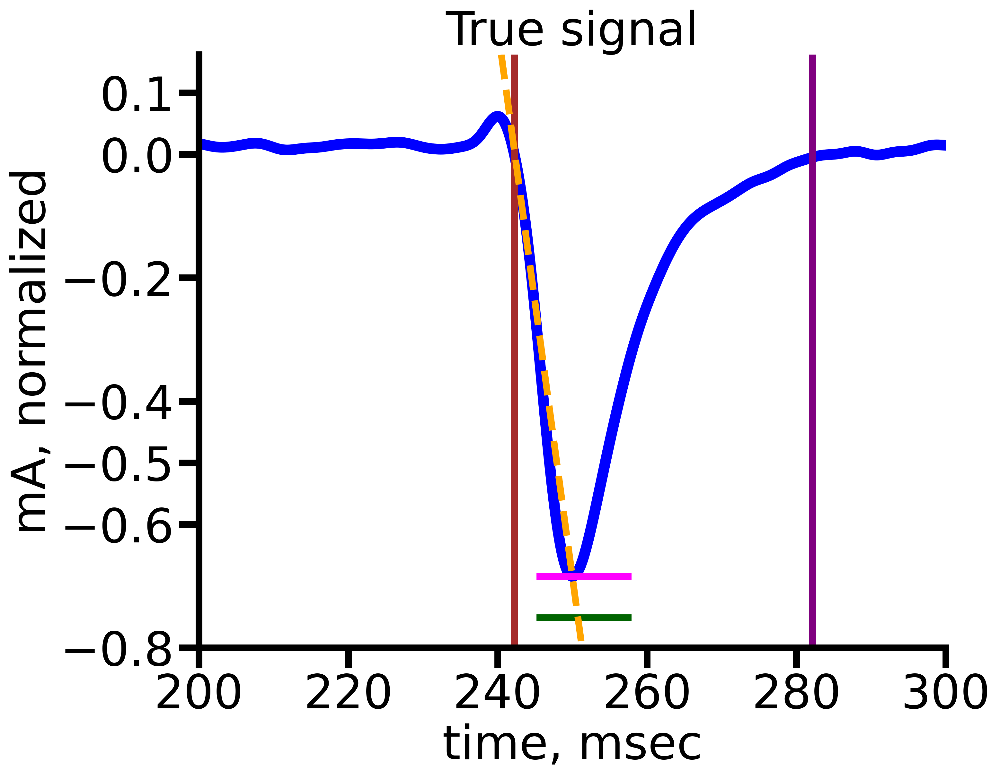

In [477]:
SL, HW, TD, TR, MV = getMetrics(av1[0], print_metrics=True, need_norm=False)
trueM = getMetrics(av1[0], print_metrics=True)
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
fig, axs = plt.subplots(1, 1, figsize=(10, 8), dpi=300)
axs.spines[['right', 'top']].set_visible(False)
x1 = np.linspace(0, len(av1[0])/20, len(av1[0]))

left = 200
right = 300


axs.set_ylim(min(av1[0])-0.05,
            max(av1[0]+0.1))

axs.set_xlim([left, right])

axs.set_xlabel("time, msec", fontsize=35)
axs.set_ylabel("mA, normalized", fontsize=35)
axs.xaxis.set_tick_params(labelsize=35)
axs.yaxis.set_tick_params(labelsize=35)
axs.set_yticks([-0.8, -0.6, -0.5, -0.4, -0.2, 0.0, 0.1])
axs.plot(x1, av1[0], color='blue', linewidth=8)
axs.set_title("True signal", fontsize=35)
print(trueM)

axs.plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])),
                [Y_test[trueM[-2]] for i in range(trueM[-2], trueM[-1])],
                label="true HalfWidth", color='darkgreen', linewidth = 5)



mins = np.ones(236)*min(av1[0])
axs.plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])), mins, label="true HalfWidth", color='magenta', linewidth = 5)

axs.plot(-0.5)


print(trueM[-1]-trueM[-2])
print(trueM)

axs.axvline(trueM[1]/20, label="true TimeRise", color='brown', linewidth =5)
axs.axvline(trueM[2]/20, label="true TimeDecrease", color='purple', linewidth = 5)

axs.axline((np.argmin(av1[0])/20, min(av1[0])), slope=-0.089, linestyle="--", color='orange', linewidth=5)
print(min(av1[0]))
fig.savefig("p5.png", bbox_inches='tight')

In [886]:
preds_res = preds
preds_lstm_ = np.load("preds_lstm_new_only2.npy")
preds_lstm=[]
for sig in preds_lstm_:
    preds_lstm.append(sig[0])

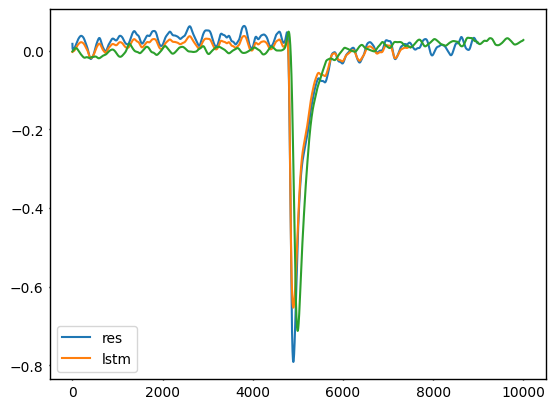

In [567]:
plt.plot(preds_res[3], label='res')
plt.plot(preds_lstm[3], label='lstm')
plt.plot(av1[3])
plt.legend()

[0.6970642834235052,
 2.375683371649719,
 14.081805485922937,
 15.263889006556536,
 2.5448760204381666,
 2.0299812151241103,
 26.58742961612843,
 0.7269306493839187,
 0.39456937347315596,
 0.5561145382728496]

In [166]:
metricss

[array([0.0022677]),
 array([0.0041584]),
 array([0.00326041]),
 array([0.00779124]),
 array([0.01309957]),
 array([0.00572322]),
 array([0.00730922]),
 array([0.00574584]),
 array([0.00716233]),
 array([0.0121537])]

In [687]:
mapes_lstm=[1.664386759885077,
 0.6321539417934683,
 0.30442441858768116,
 0.06276070946509366,
 0.7770036601186062,
 0.8465636380051298,
 2.319004792550947,
 1.4619722151284114,
 0.2683742751509685,
 33.13891468890408]

In [ ]:
mapes_res

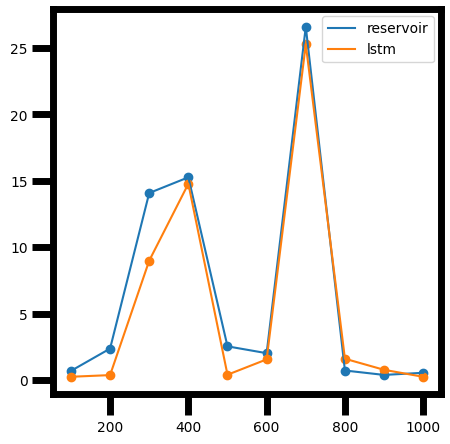

In [170]:
x=list(range(100,1001,100))
plt.figure(figsize=(5,5))
plt.plot(x, mapes, label = 'reservoir')
plt.scatter(x, mapes)
plt.plot(x, mapes_lstm, label = 'lstm')
plt.scatter(x, mapes_lstm)
plt.legend()
plt.savefig("mapes.png")

In [60]:
plt.plot(preds[0])
plt.axvline(4600, color = 'r', linewidth = 3)
plt.axvline(6000, color = 'r', linewidth = 3)
plt.savefig("mape_example.png")

IndexError: list index out of range

In [650]:
mets=metricss

In [651]:
mets

[array([0.00498507]),
 array([0.00451066]),
 array([5.48227756e-05]),
 array([0.00262098]),
 array([0.00107312]),
 array([0.00154536]),
 array([0.00437701]),
 array([0.00078417]),
 array([0.00249164]),
 array([0.00932017])]

In [92]:
metricss=[0.00024491, 0.00022201, 0.00897067, 0.00439158, 0.00680955, 0.00613704, 0.0364604, 0.00898286, 0.01350087, 0.00505314]

In [316]:
metrs_lstm = [0.0005550625882137058,
 0.0004579720328461507,
 0.00023569656359563834,
 0.0031702839213438184,
 0.003678788434801949,
 0.00018595128640708802,
 0.0004556915075502494,
 0.0004106666484804128,
 0.0010277824819926557,
 0.0007203678780353052]

In [626]:
metrs_lstm2 = [0.0027119040546421383,
 0.0016596872771956392,
 0.00016258093809213813,
 0.00041296263175920626,
 0.005521738648125866,
 0.0005936006068630323,
 0.002099683529204372,
 0.000549644087558038,
 0.0007919373992841612,
 0.0006760424369190337]

In [901]:
mses_lstm=[0.0009488894783100159,
 0.0003555487306836524,
 0.000142992709892099,
 2.4114939692868253e-05,
 0.00019874960253309462,
 8.487134943587475e-05,
 3.817122352780421e-05,
 1.3306635684103027e-05,
 4.285810793006469e-05,
 3.8440076377709744e-05]

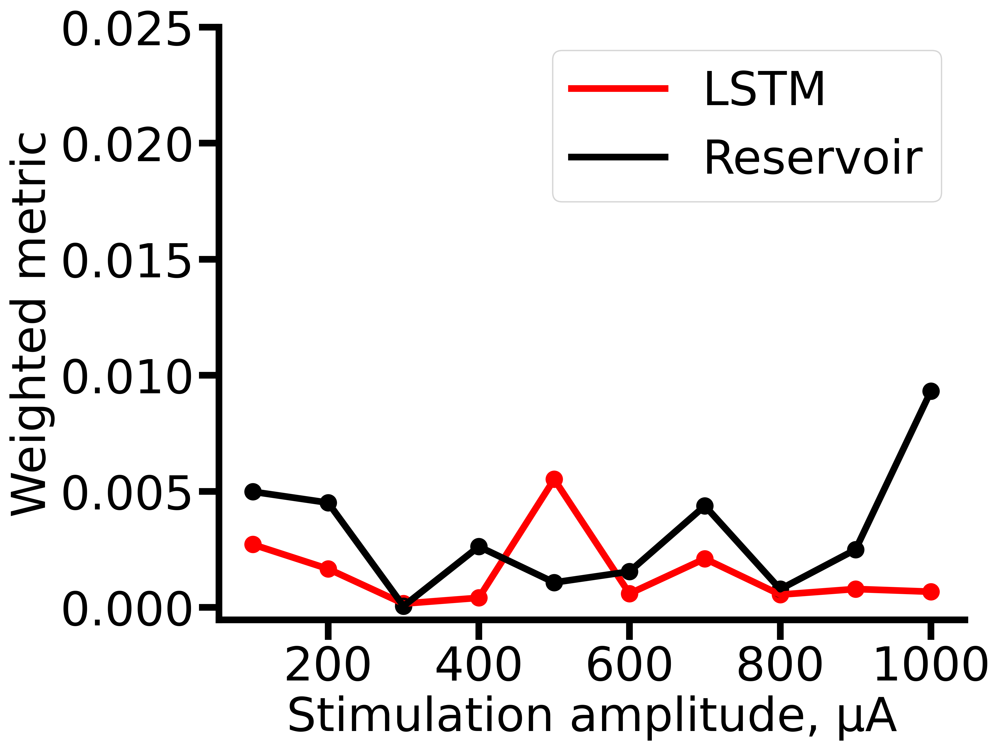

In [829]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
fig, axs = plt.subplots(1,1, figsize=(10, 8), dpi=400)
axs.spines[['right', 'top']].set_visible(False)
axs.spines[['right', 'top']].set_visible(False)
#fig.subplots(figsize=(10, 8), dpi=400)
axs.plot(x, metrs_lstm2, color='r',label='LSTM', linewidth = 5)
axs.scatter(x, metrs_lstm2, color='r', linewidth = 7)
axs.plot(x, mets, color='black', label='Reservoir', linewidth = 5)
axs.scatter(x, mets, color='black', linewidth = 7)

axs.xaxis.set_tick_params(labelsize=35)
axs.yaxis.set_tick_params(labelsize=35)

axs.set_xlabel("Stimulation amplitude, μА", fontsize=35)
axs.set_ylabel("Weighted metric", fontsize=35)

axs.set_ylim(top=0.025)
axs.set_ylim(min(metrs_lstm2)-0.0007)

axs.legend(fontsize=35)
fig.savefig("new_only/Metrics_new.png", bbox_inches='tight')
fig.savefig("new_only/Metrics_legend.pdf", bbox_inches='tight')

In [695]:
mapes

[5.016297725632833,
 0.8345572959890772,
 0.30820702101036723,
 0.21237194540949136,
 0.39407113039609026,
 1.6437414489131617,
 9.047119937826471,
 12.671067667499669,
 1.3540952336382304,
 80.31292691951549]

mapes

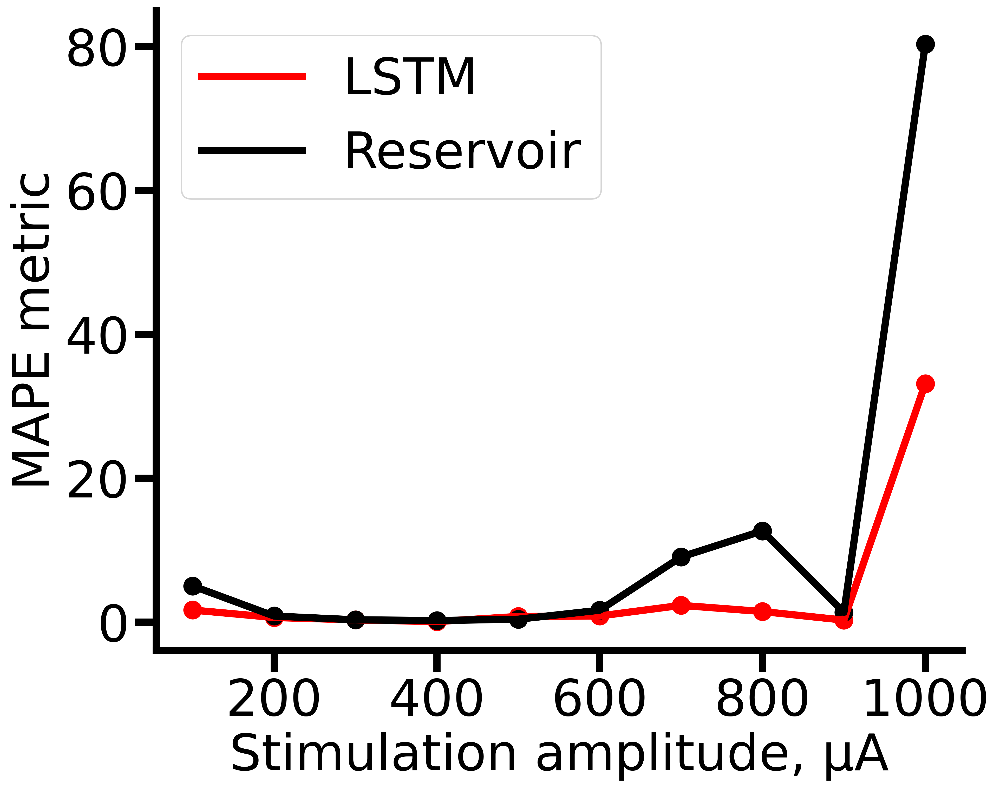

In [828]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15

fig, axs = plt.subplots(1,1, figsize=(10, 8), dpi=400)
axs.spines[['right', 'top']].set_visible(False)
axs.spines[['right', 'top']].set_visible(False)

axs.plot(x, mapes_lstm, color='r',label='LSTM', linewidth = 5)
axs.scatter(x, mapes_lstm, color='r', linewidth = 7)
axs.plot(x, mapes, color='black', label='Reservoir', linewidth = 5)
axs.scatter(x, mapes, color='black', linewidth = 7)
axs.set_ylim(top=85)

# axs.xlabel("Stimulation amplitude, μА", fontsize=35)
# axs.ylabel("MAPE metric", fontsize=35)

axs.xaxis.set_tick_params(labelsize=35)
axs.yaxis.set_tick_params(labelsize=35)

axs.set_xlabel("Stimulation amplitude, μА", fontsize=35)
axs.set_ylabel("MAPE metric", fontsize=35)

#axs.set_ylim(top=85)
# axs.set_ylim(min(metrs_lstm2)-0.0007)

axs.legend(fontsize=35)
fig.savefig("new_only/Metrics_mape_new.png", bbox_inches='tight')
#plt.savefig("new_only/Metrics_mape_legend.pdf", bbox_inches='tight')

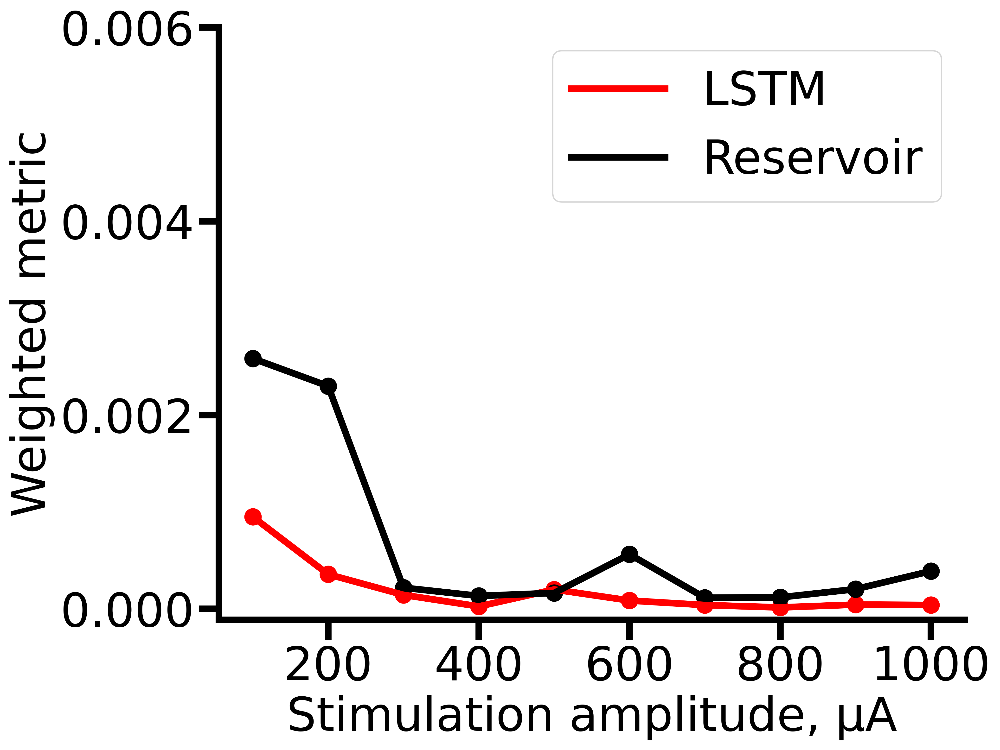

In [908]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
fig, axs = plt.subplots(1,1, figsize=(10, 8), dpi=400)
axs.spines[['right', 'top']].set_visible(False)
axs.spines[['right', 'top']].set_visible(False)
#fig.subplots(figsize=(10, 8), dpi=400)
axs.plot(x,mses_lstm, color='r',label='LSTM', linewidth = 5)
axs.scatter(x, mses_lstm, color='r', linewidth = 7)
axs.plot(x, mses, color='black', label='Reservoir', linewidth = 5)
axs.scatter(x, mses, color='black', linewidth = 7)

axs.xaxis.set_tick_params(labelsize=35)
axs.yaxis.set_tick_params(labelsize=35)

axs.set_xlabel("Stimulation amplitude, μА", fontsize=35)
axs.set_ylabel("Weighted metric", fontsize=35)

axs.set_ylim(top=0.006)
#axs.set_ylim(min(metrs_lstm2)-0.0007)

axs.legend(fontsize=35)
fig.savefig("new_only/MSE.png", bbox_inches='tight')
fig.savefig("new_only/MSE.pdf", bbox_inches='tight')

In [235]:
len(averaged1)

14

5000 11000
5001 9000
5000 11000
4994 9000
5000 11000
4997 9000
5000 11000
4996 9000
5000 11000
5000 9000
5000 11000
4993 9000
5000 11000
4997 9000
5000 11000
5001 9000
5000 11000
5005 9000
5000 11000
4996 9000


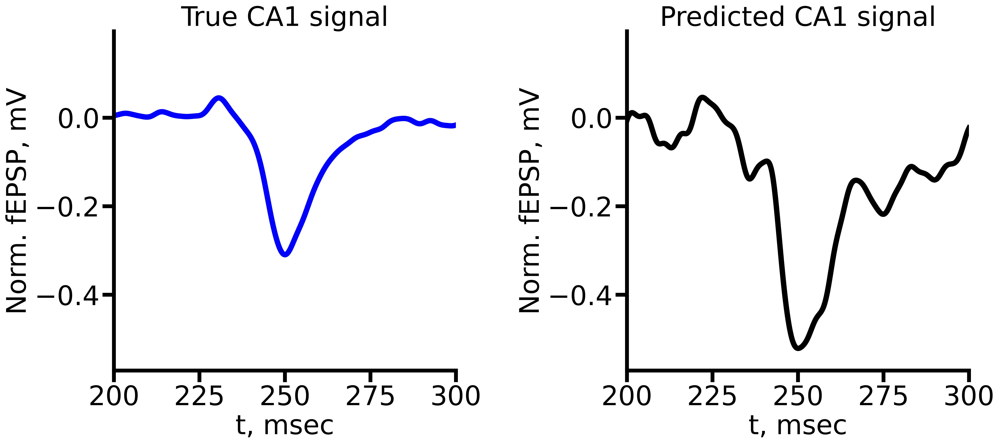

<Figure size 500x500 with 0 Axes>

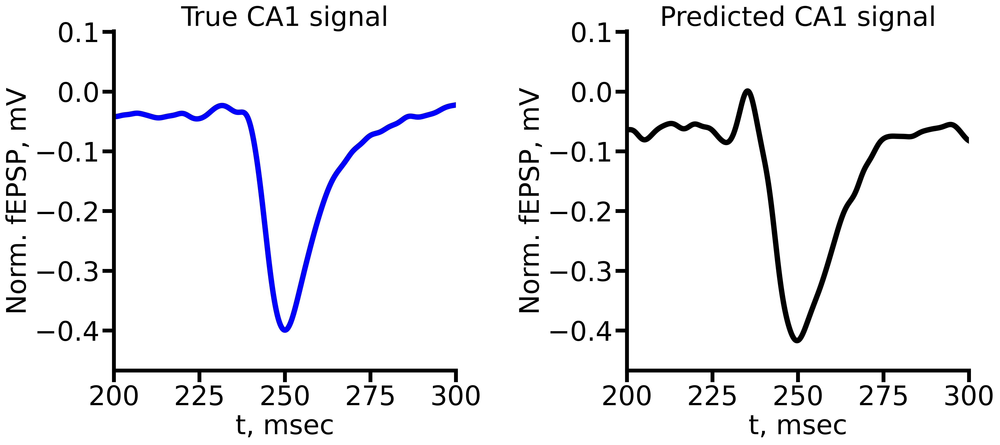

<Figure size 500x500 with 0 Axes>

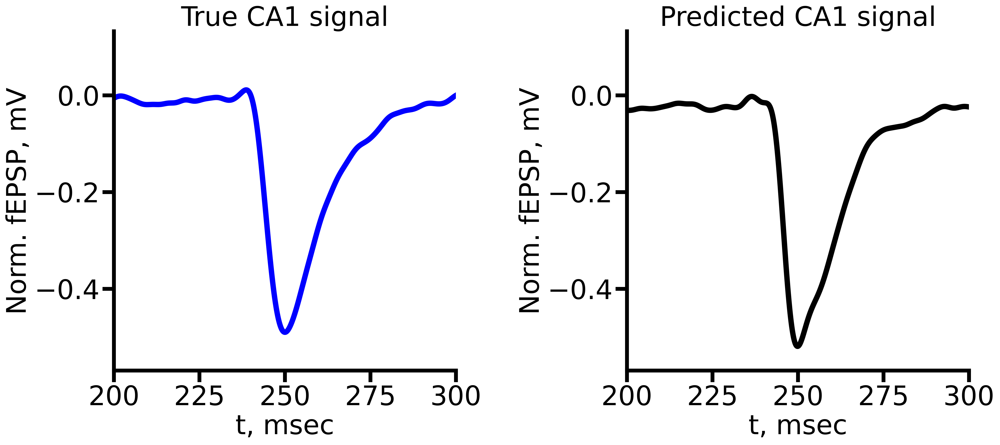

<Figure size 500x500 with 0 Axes>

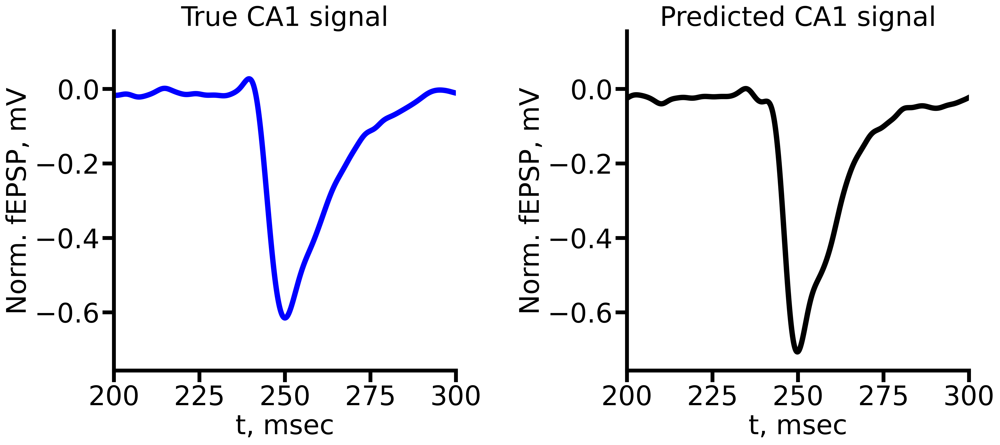

<Figure size 500x500 with 0 Axes>

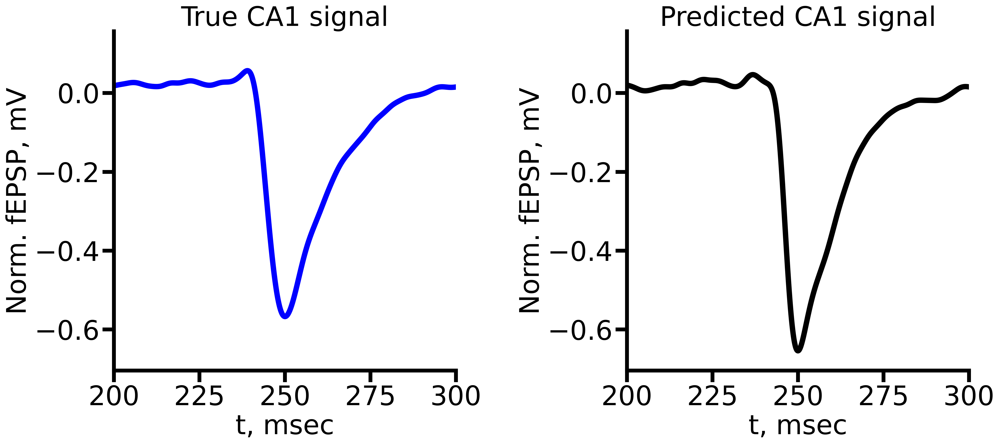

<Figure size 500x500 with 0 Axes>

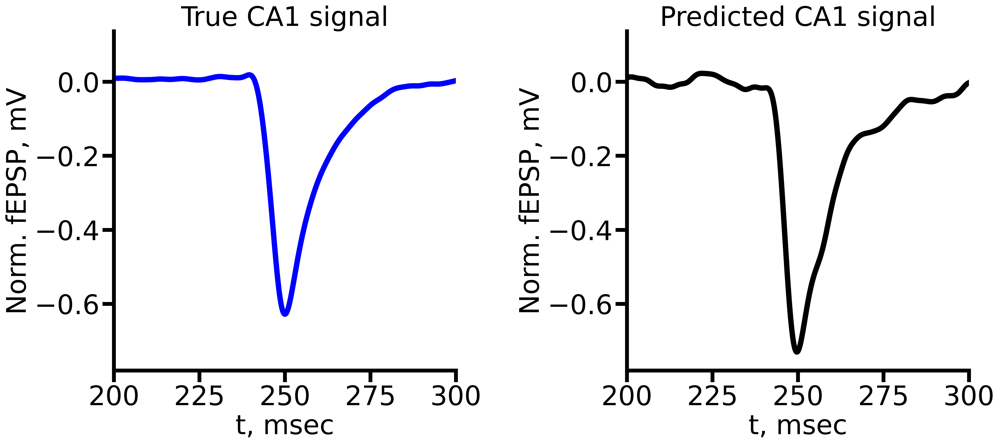

<Figure size 500x500 with 0 Axes>

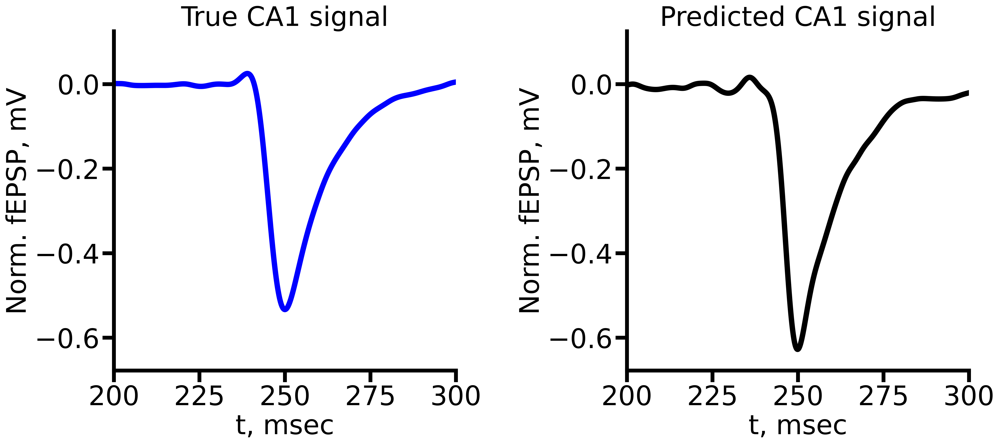

<Figure size 500x500 with 0 Axes>

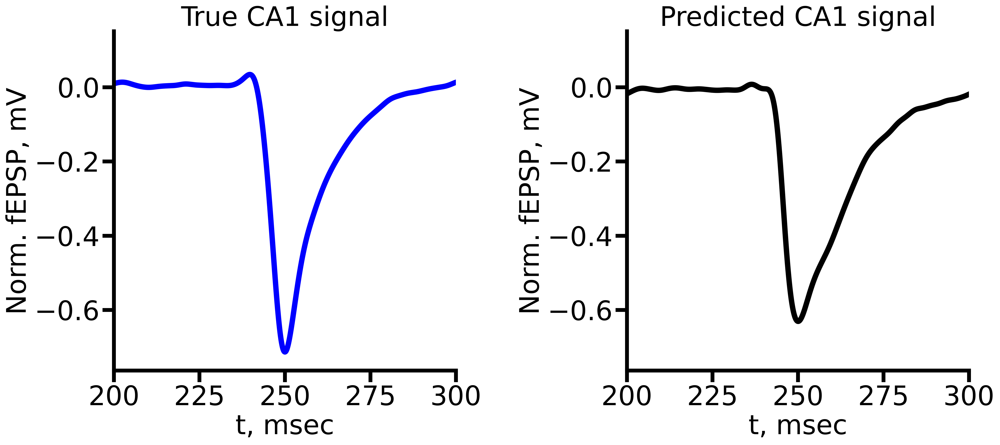

<Figure size 500x500 with 0 Axes>

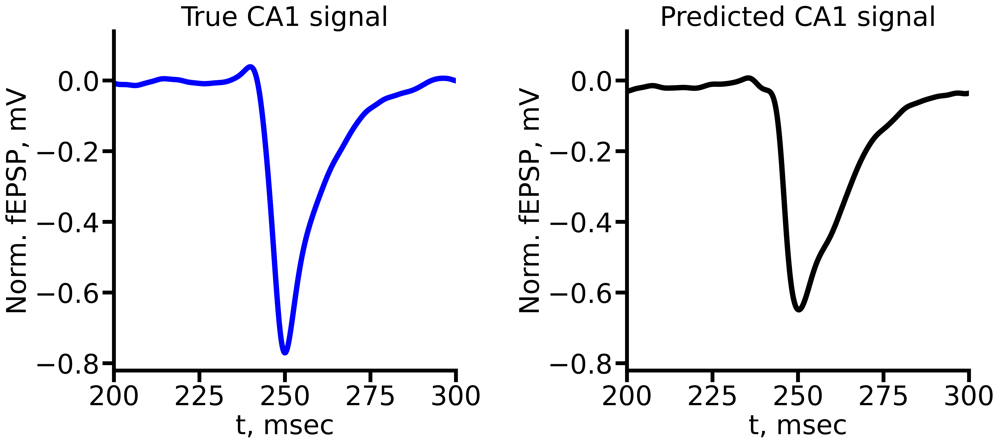

<Figure size 500x500 with 0 Axes>

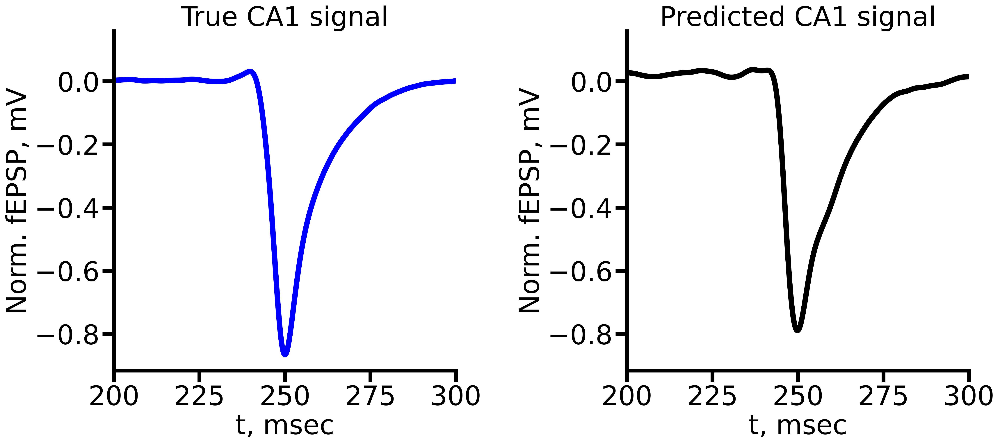

<Figure size 500x500 with 0 Axes>

In [699]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
for sig in range(len(av1)):
    Y_test=av1[sig]
    Y_pred=preds_res[sig]
    fig, axs = plt.subplots(1, 2, figsize=(20, 8), dpi=300)
    axs[0].spines[['right', 'top']].set_visible(False)
    axs[1].spines[['right', 'top']].set_visible(False)
    plt.subplots_adjust(wspace=0.5)
    plt.figure(figsize=(5,5))
    x1 = np.linspace(0, len(Y_test)/20, len(Y_test))
    y1 = np.linspace(0, len(Y_pred)/20, len(Y_pred))
    
    left = 200
    right = 300
    
    axs[0].set_ylim(min(min(Y_test), min(Y_pred))-0.05,
                max(max(Y_test), max(Y_pred))+0.1)
    axs[1].set_ylim(min(min(Y_test), min(Y_pred))-0.05,
                max(max(Y_test), max(Y_pred))+0.1)
    
    # plt.ylim(min(min(Y_test), min(Y_pred))-0.05,
    #     max(max(Y_test), max(Y_pred)))
    
    axs[0].set_xlim([left, right])
    axs[1].set_xlim([left, right])

    axs[0].xaxis.set_tick_params(labelsize=35)
    axs[0].yaxis.set_tick_params(labelsize=35)

    axs[1].xaxis.set_tick_params(labelsize=35)
    axs[1].yaxis.set_tick_params(labelsize=35)
    
    # axs[0].set_xlim([left, right])
    # axs[1].set_xlim([left, right])

    axs[0].set_xlabel("t, msec", fontsize=35)
    axs[1].set_xlabel("t, msec", fontsize=35)

    axs[0].set_ylabel("Norm. fEPSP, mV", fontsize=35)
    axs[1].set_ylabel("Norm. fEPSP, mV", fontsize=35)
    
    axs[0].plot(x1, Y_test, label='real CA1', color='blue', linewidth=7)
    axs[1].plot(y1, Y_pred,  label='predicted CA1', color='black', linewidth=7)

    axs[0].set_title("True CA1 signal", fontsize=35)
    axs[1].set_title("Predicted CA1 signal", fontsize=35)

    trueM = getMetrics(Y_test, print_metrics=True)
    predM = getMetrics(Y_pred, print_metrics = True)

    # axs[0].plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])),
    #             [Y_test[trueM[-2]] for i in range(trueM[-2], trueM[-1])],
    #             label="true HalfWidth", color='green', linewidth = 2)
    
    # axs[0].axvline(trueM[1]/20, label="true TimeRise", color='orange', linewidth =2)
    # axs[0].axvline(trueM[2]/20, label="true TimeDecrease", color='purple', linewidth = 2)
    # axs[1].plot(np.linspace(predM[-2]/20, predM[-1]/20, (predM[-1]-predM[-2])),
    #             [Y_pred[predM[-2]] for i in range(predM[-2], predM[-1])],
    #             label="pred HalfWidth", color='green', linewidth = 2)
    
    # axs[1].axvline(predM[1]/20, label="pred TimeRise", color='orange', linewidth = 2)
    # axs[1].axvline(predM[2]/20, label="pred TimeDecrease", color='purple', linewidth = 2)

    fig.savefig(f"new_only/reservoir/{sig*100+100}.png", bbox_inches="tight")
    

5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500
5000 11000
5000 7500


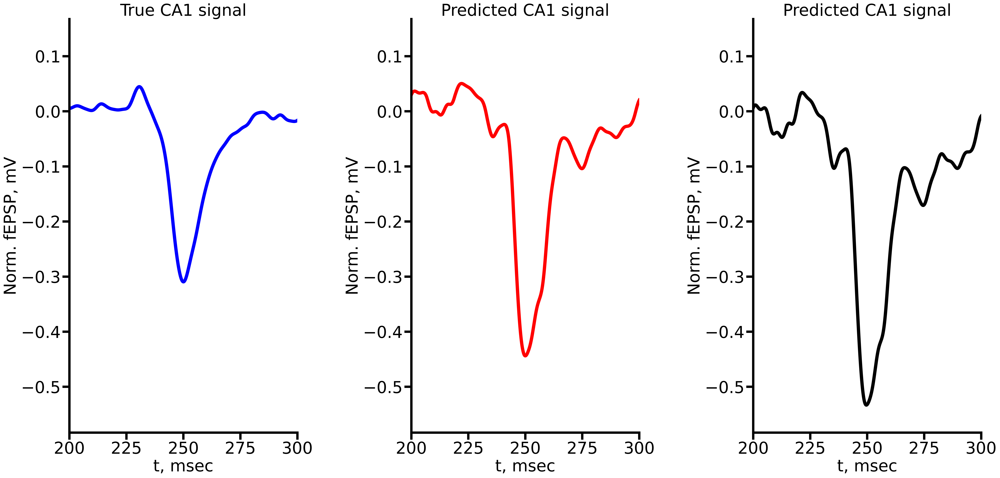

<Figure size 500x500 with 0 Axes>

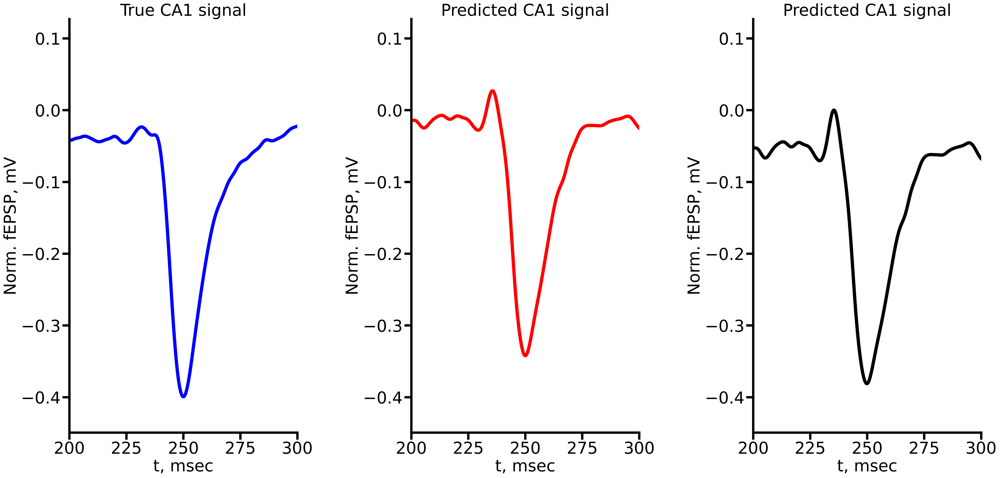

<Figure size 500x500 with 0 Axes>

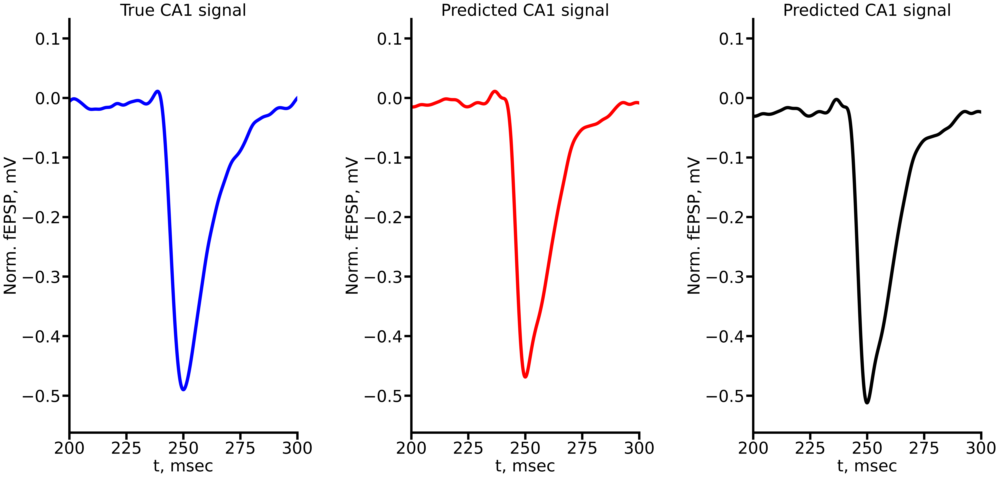

<Figure size 500x500 with 0 Axes>

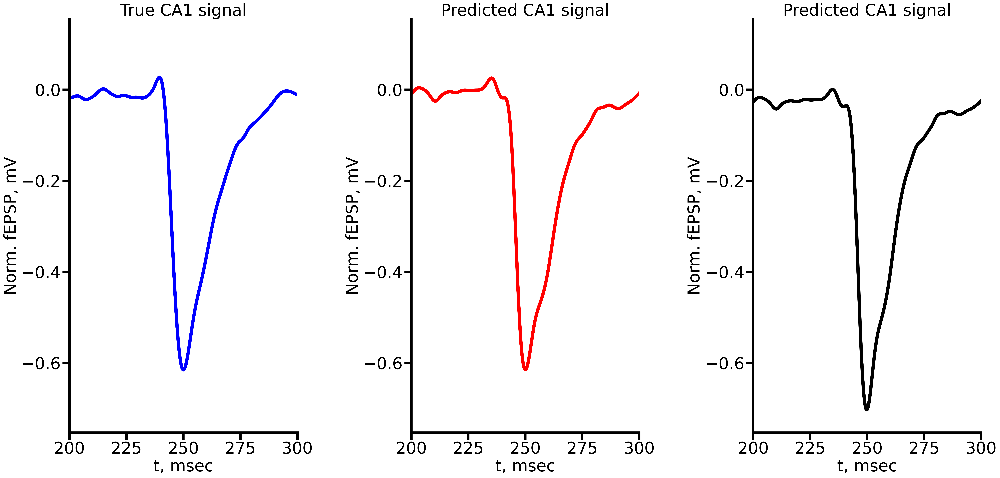

<Figure size 500x500 with 0 Axes>

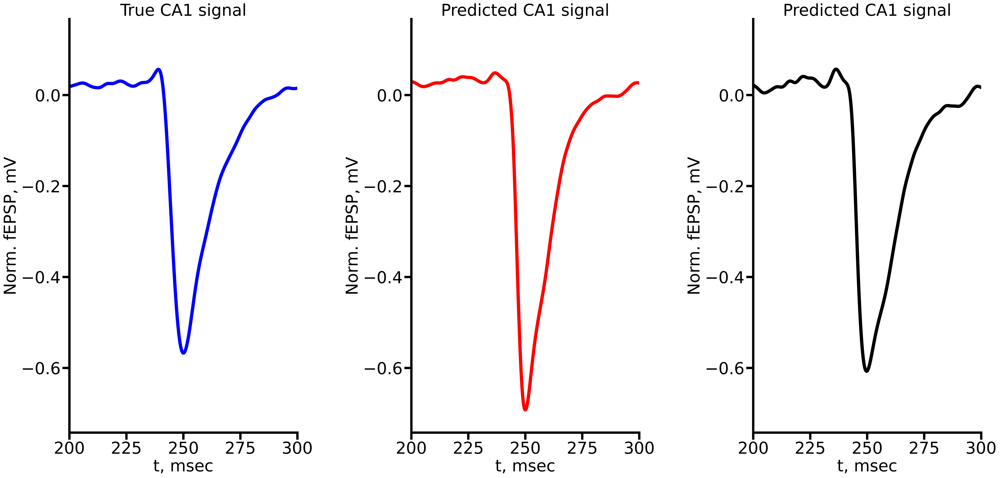

<Figure size 500x500 with 0 Axes>

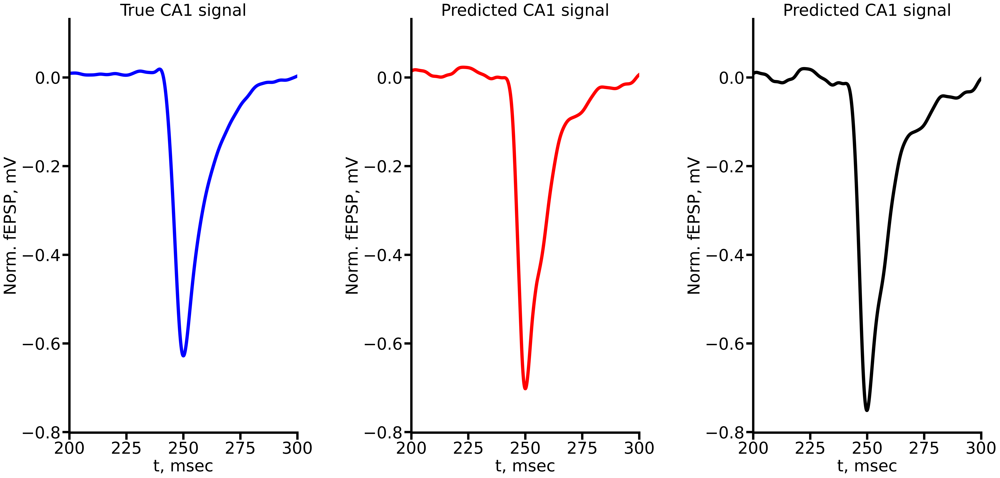

<Figure size 500x500 with 0 Axes>

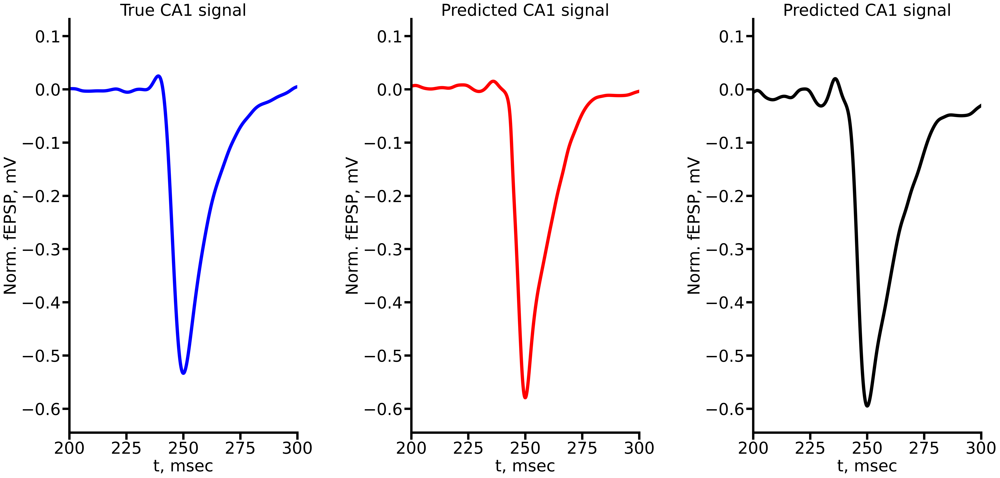

<Figure size 500x500 with 0 Axes>

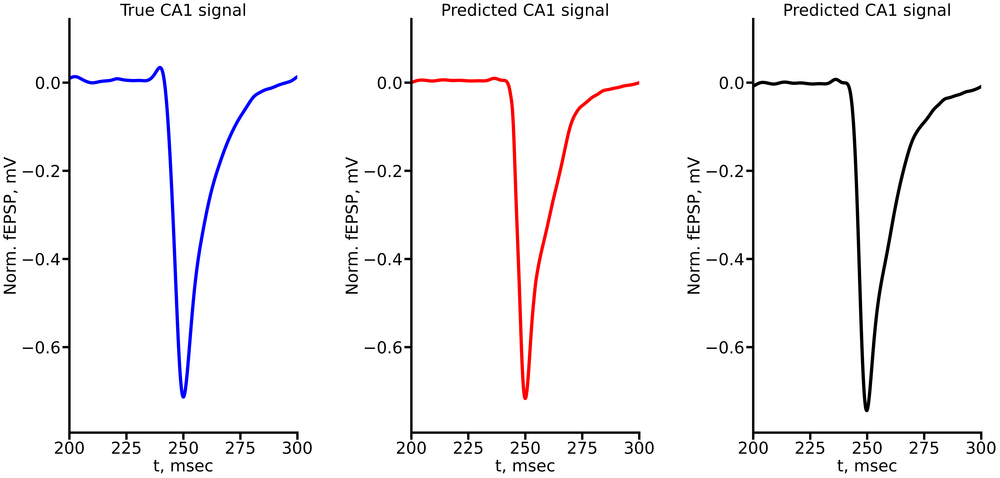

<Figure size 500x500 with 0 Axes>

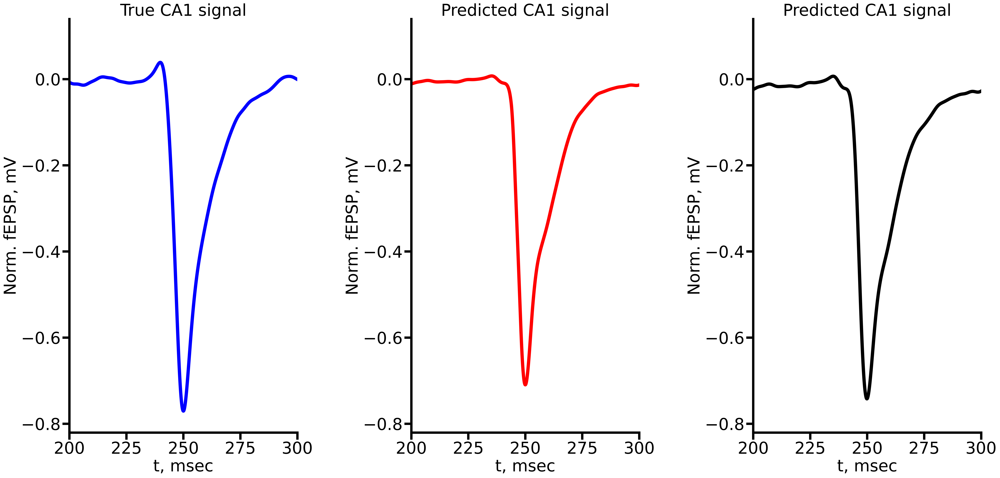

<Figure size 500x500 with 0 Axes>

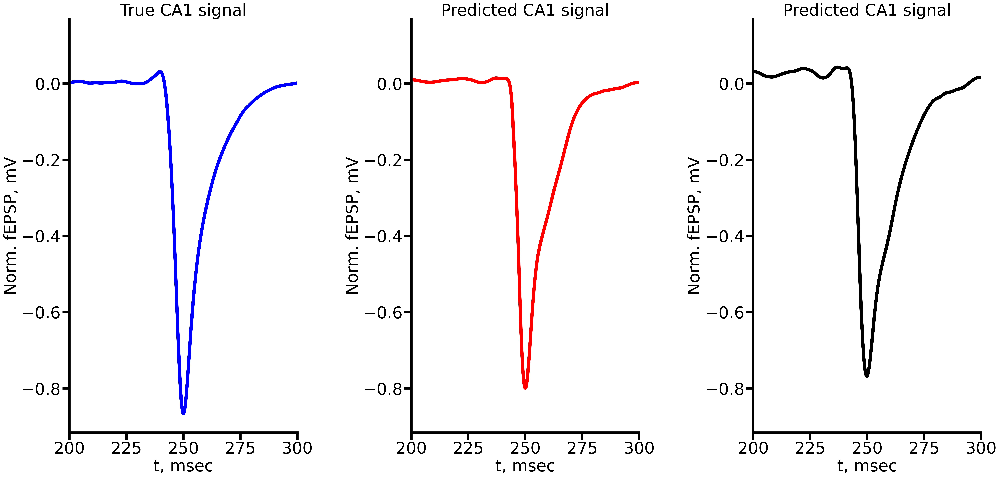

<Figure size 500x500 with 0 Axes>

In [659]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
for sig in range(len(av1)):
    Y_test=av1[sig]
    Y_pred_lstm=preds_lstm[sig]
    Y_pred_res = preds_res[sig]
    fig, axs = plt.subplots(1, 3, figsize=(35, 16), dpi=300)
    axs[0].spines[['right', 'top']].set_visible(False)
    axs[1].spines[['right', 'top']].set_visible(False)
    axs[2].spines[['right', 'top']].set_visible(False)
    plt.subplots_adjust(wspace=0.5)
    plt.figure(figsize=(5,5))
    x1 = np.linspace(0, len(Y_test)/20, len(Y_test))
    y1 = np.linspace(0, len(Y_pred_lstm)/20, len(Y_pred_lstm))
    yz = np.linspace(0, len(Y_pred_res)/20, len(Y_pred_res))
    
    left = 200
    right = 300
    
    axs[0].set_ylim(min(min(Y_test), min(Y_pred_lstm), min(Y_pred_res))-0.05,
                max(max(Y_test), max(Y_pred_lstm), max(Y_pred_res))+0.1)
    axs[1].set_ylim(min(min(Y_test), min(Y_pred_lstm),  min(Y_pred_res))-0.05,
                max(max(Y_test), max(Y_pred_lstm),  max(Y_pred_res))+0.1)

    axs[2].set_ylim(min(min(Y_test), min(Y_pred_lstm),  min(Y_pred_res))-0.05,
                max(max(Y_test), max(Y_pred_lstm),  max(Y_pred_res))+0.1)
    
    # plt.ylim(min(min(Y_test), min(Y_pred))-0.05,
    #     max(max(Y_test), max(Y_pred)))
    
    axs[0].set_xlim([left, right])
    axs[1].set_xlim([left, right])
    axs[2].set_xlim([left, right])

    axs[0].xaxis.set_tick_params(labelsize=35)
    axs[0].yaxis.set_tick_params(labelsize=35)

    axs[1].xaxis.set_tick_params(labelsize=35)
    axs[1].yaxis.set_tick_params(labelsize=35)

    axs[2].xaxis.set_tick_params(labelsize=35)
    axs[2].yaxis.set_tick_params(labelsize=35)
    
    # axs[0].set_xlim([left, right])
    # axs[1].set_xlim([left, right])

    axs[0].set_xlabel("t, msec", fontsize=35)
    axs[1].set_xlabel("t, msec", fontsize=35)
    axs[2].set_xlabel("t, msec", fontsize=35)

    axs[0].set_ylabel("Norm. fEPSP, mV", fontsize=35)
    axs[1].set_ylabel("Norm. fEPSP, mV", fontsize=35)
    axs[2].set_ylabel("Norm. fEPSP, mV", fontsize=35)
    
    axs[0].plot(x1, Y_test, label='real CA1', color='blue', linewidth=7)
    axs[1].plot(y1, Y_pred_lstm,  label='predicted CA1', color='red', linewidth=7)
    axs[2].plot(z1, Y_pred_res,  label='predicted CA1', color='black', linewidth=7)

    axs[0].set_title("True CA1 signal", fontsize=35)
    axs[1].set_title("Predicted CA1 signal", fontsize=35)
    axs[2].set_title("Predicted CA1 signal", fontsize=35)

    trueM = getMetrics(Y_test, print_metrics=True)
    predM = getMetrics(Y_pred, print_metrics = True)

    # axs[0].plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])),
    #             [Y_test[trueM[-2]] for i in range(trueM[-2], trueM[-1])],
    #             label="true HalfWidth", color='green', linewidth = 2)
    
    # axs[0].axvline(trueM[1]/20, label="true TimeRise", color='orange', linewidth =2)
    # axs[0].axvline(trueM[2]/20, label="true TimeDecrease", color='purple', linewidth = 2)
    # axs[1].plot(np.linspace(predM[-2]/20, predM[-1]/20, (predM[-1]-predM[-2])),
    #             [Y_pred[predM[-2]] for i in range(predM[-2], predM[-1])],
    #             label="pred HalfWidth", color='green', linewidth = 2)
    
    # axs[1].axvline(predM[1]/20, label="pred TimeRise", color='orange', linewidth = 2)
    # axs[1].axvline(predM[2]/20, label="pred TimeDecrease", color='purple', linewidth = 2)

    fig.savefig(f"new_only/supplementary_lstm/{sig*100+100}.png", bbox_inches="tight")
    

In [836]:
slopes1=[]
slopes3=[]
halfwidths1=[]
halfwidths3=[]
timerises1=[]
timerises3=[]
timedecreases1=[]
timedecreases3=[]
minvalues1=[]
minvalues3=[]
for amp in range(100,1001, 100):
    SLS= []
    SLS3=[]
    HWS= []
    HWS3= []
    TDS= []
    TDS3= []
    TRS= []
    TRS3= []
    MVS= []
    MVS3= []
    for sig in range(len(unav1[amp])):
        Y_test  = unav1[amp][sig]
        Y_train = unav3[amp][sig]
        # Y_pred_lstm=preds_lstm[sig]
        # Y_pred_res=preds_res[sig]
        SL, HW, TD, TR, MV = getMetrics(Y_test, print_metrics=False)
        # SL1, HW1, TD1, TR1, MV1 = getMetrics(Y_pred_lstm, print_metrics=False)
        # SL2, HW2, TD2, TR2, MV2 = getMetrics(Y_pred_res, print_metrics=False)
        SL3, HW3, TD3, TR3, MV3 = getMetrics(Y_train, print_metrics=False)
        SLS.append(SL)
        SLS3.append(SL3)
        HWS.append(HW)
        HWS3.append(HW3)
        TDS.append(TD)
        TDS3.append(TD3)
        TRS.append(TR)
        TRS3.append(TR3)
        MVS.append(MV)
        MVS3.append(MV3)
    slopes1.append(SLS)
    slopes3.append(SLS3)

    halfwidths1.append(HWS)
    halfwidths3.append(HWS3)

    timerises1.append(TRS)
    timerises3.append(TRS3)

    timedecreases1.append(TDS)
    timedecreases3.append(TDS3)

    minvalues1.append(MVS)
    minvalues3.append(MVS3)
    

5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000
5000 11000

In [887]:
SLS= []
SLS1=[]
SLS2=[]
SLS3=[]
HWS= []
HWS1= []
HWS2= []
HWS3= []
TDS= []
TDS1= []
TDS2= []
TDS3= []
TRS= []
TRS1= []
TRS2= []
TRS3= []
MVS= []
MVS1= []
MVS2= []
MVS3= []
for sig in range(len(av1)):
    Y_test  = av1[sig]
    Y_train = av3[sig]
    Y_pred_lstm=preds_lstm[sig]
    Y_pred_res=preds_res[sig]
    SL, HW, TD, TR, MV = getMetrics(Y_test, print_metrics=False)
    SL1, HW1, TD1, TR1, MV1 = getMetrics(Y_pred_lstm, print_metrics=False)
    SL2, HW2, TD2, TR2, MV2 = getMetrics(Y_pred_res, print_metrics=False)
    SL3, HW3, TD3, TR3, MV3 = getMetrics(Y_train, print_metrics=False)
    SLS.append(SL)
    SLS1.append(SL1)
    SLS2.append(SL2)
    SLS3.append(SL3)
    HWS.append(HW)
    HWS1.append(HW1)
    HWS2.append(HW2)
    HWS3.append(HW3)
    TDS.append(TD)
    TDS1.append(TD1)
    TDS2.append(TD2)
    TDS3.append(TD3)
    TRS.append(TR)
    TRS1.append(TR1)
    TRS2.append(TR2)
    TRS3.append(TR3)
    MVS.append(MV)
    MVS1.append(MV1)
    MVS2.append(MV2)
    MVS3.append(MV3)

5000 11000
5000 7500
5001 9000
5000 11000
5000 11000
5000 7500
4994 9000
5000 11000
5000 11000
5000 7500
4997 9000
5000 11000
5000 11000
5000 7500
4996 9000
5000 11000
5000 11000
5000 7500
5000 9000
5000 11000
5000 11000
5000 7500
4993 9000
5000 11000
5000 11000
4999 7500
4997 9000
5000 11000
5000 11000
4999 7500
5001 9000
5000 11000
5000 11000
5000 7500
5005 9000
5000 11000
5000 11000
5000 7500
4996 9000
5000 11000


In [752]:
list(np.reshape(SLS3, len(SLS3)))

[0.008003078731250916,
 0.015280601512553072,
 0.004893092057984823,
 0.0020714603228441414,
 0.0021717017869247093,
 0.0014442361039448085,
 0.0026536899405855234,
 0.003358939133850974,
 0.003221754311417577,
 0.0006053843458599906]

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


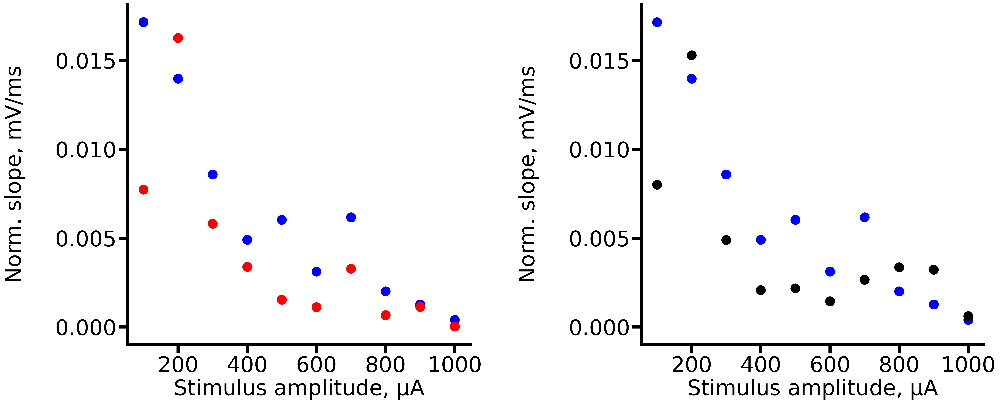

In [896]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15

fig, axs = plt.subplots(1, 2, figsize=(25, 10), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = SLS
y1 = SLS1
y2 = SLS2
axs[0].set_ylim(min(min(y1), min(y2), min(y))-0.001,
            max(max(y1), max(y2), max(y))+0.001)
axs[1].set_ylim(min(min(y1), min(y2), min(y))-0.001,
            max(max(y1), max(y2), max(y))+0.001)

axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. slope, mV/ms", fontsize=35)
axs[1].set_ylabel("Norm. slope, mV/ms", fontsize=35)

axs[0].get_yaxis().set_label_coords(-0.3,0.5)
axs[1].get_yaxis().set_label_coords(-0.3,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/slope.png", bbox_inches="tight")

In [745]:
y3

[array([0.00800308]),
 array([0.0152806]),
 array([0.00489309]),
 array([0.00207146]),
 array([0.0021717]),
 array([0.00144424]),
 array([0.00265369]),
 array([0.00335894]),
 array([0.00322175]),
 array([0.00060538])]

In [881]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15


fig, axs = plt.subplots(1, 2, figsize=(35, 12), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
y = slopes1
y3 = slopes3
min_all = min(min([min(sig) for sig in y]), min([min(sig) for sig in y3]))
max_all = max(max([max(sig) for sig in y]), max([max(sig) for sig in y3]))
# y = SLS
# y1 = SLS1
# y2 = SLS2
#y3 = list(np.reshape(SLS3, len(SLS3)))
axs[0].set_ylim(min_all, max_all+0.005)
axs[1].set_ylim(min_all, max_all+0.005)

axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. slope, mV/ms", fontsize=35)
axs[1].set_ylabel("Norm. slope, mV/ms", fontsize=35)

# axs[0].tick_params(
#     axis='x',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     bottom=False,      # ticks along the bottom edge are off         # ticks along the top edge are off
#     labelbottom=False)


# axs[1].tick_params(
#     axis='x',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     bottom=False,      # ticks along the bottom edge are off         # ticks along the top edge are off
#     labelbottom=False)



boxprops = dict(linewidth=5, color='black')
flierprops = dict(marker='o', markerfacecolor='black', markersize=12,
                  markeredgecolor='none')
medianprops = dict(linewidth=5, color='blue')
meanlineprops = dict(linewidth=5, color='blue')
whiskerprops = dict(linewidth=5, color='black')
capprops = dict(linewidth=5, color='black')
labels = list(range(100,1001,100))

axs[0].get_yaxis().set_label_coords(-0.2,0.5)
axs[1].get_yaxis().set_label_coords(-0.2,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].boxplot(slopes3, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanline=meanlineprops, whiskerprops=whiskerprops, capprops=capprops)
#axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].boxplot(slopes1, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanprops=meanpointprops, whiskerprops=whiskerprops, meanline=meanlineprops, capprops=capprops)
#axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/slope_boxplot.png", bbox_inches="tight")

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


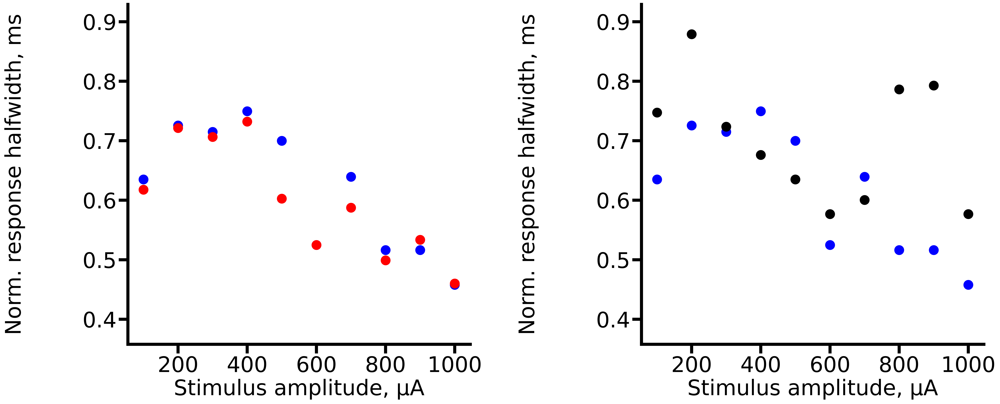

In [897]:
fig, axs = plt.subplots(1, 2, figsize=(25, 10), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = HWS
y1 = HWS1
y2 = HWS2
axs[0].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)
axs[1].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)

axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. response halfwidth, ms", fontsize=35)
axs[1].set_ylabel("Norm. response halfwidth, ms", fontsize=35)

axs[0].get_yaxis().set_label_coords(-0.3,0.5)
axs[1].get_yaxis().set_label_coords(-0.3,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/halfwidth.png", bbox_inches="tight")

In [882]:
fig, axs = plt.subplots(1, 2, figsize=(35, 12), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))


y = halfwidths1
y3 = halfwidths3
min_all = min(min([min(sig) for sig in y]), min([min(sig) for sig in y3]))
max_all = max(max([max(sig) for sig in y]), max([max(sig) for sig in y3]))

axs[0].set_ylim(min_all, max_all+0.1)
axs[1].set_ylim(min_all, max_all+0.1)

axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. response halfwidth, ms", fontsize=35)
axs[1].set_ylabel("Norm. response halfwidth, ms", fontsize=35)



boxprops = dict(linewidth=5, color='black')
flierprops = dict(marker='o', markerfacecolor='black', markersize=12,
                  markeredgecolor='none')
medianprops = dict(linewidth=5, color='blue')
meanlineprops = dict(linewidth=5, color='blue')
whiskerprops = dict(linewidth=5, color='black')
capprops = dict(linewidth=5, color='black')
labels = list(range(100,1001,100))

axs[0].get_yaxis().set_label_coords(-0.2,0.5)
axs[1].get_yaxis().set_label_coords(-0.2,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].boxplot(y3, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanline=meanlineprops, whiskerprops=whiskerprops, capprops=capprops)
#axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].boxplot(y, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanprops=meanpointprops, whiskerprops=whiskerprops, meanline=meanlineprops, capprops=capprops)
#axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)

fig.savefig("new_only/halfwidth_boxplot.png", bbox_inches="tight")

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


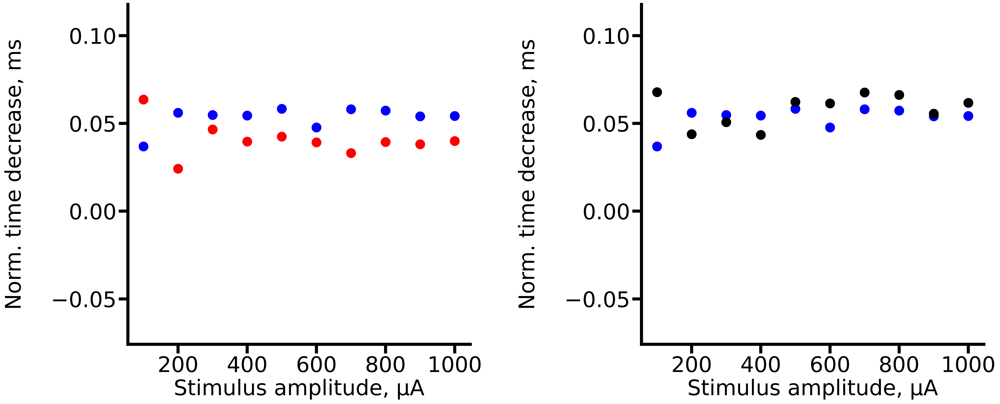

In [898]:
fig, axs = plt.subplots(1, 2, figsize=(25, 10), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = TDS
y1 = TDS1
y2 = TDS2
axs[0].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)
axs[1].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)

axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. time decrease, ms", fontsize=35)
axs[1].set_ylabel("Norm. time decrease, ms", fontsize=35)

axs[0].get_yaxis().set_label_coords(-0.3,0.5)
axs[1].get_yaxis().set_label_coords(-0.3,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/timedecrease.png", bbox_inches="tight")

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


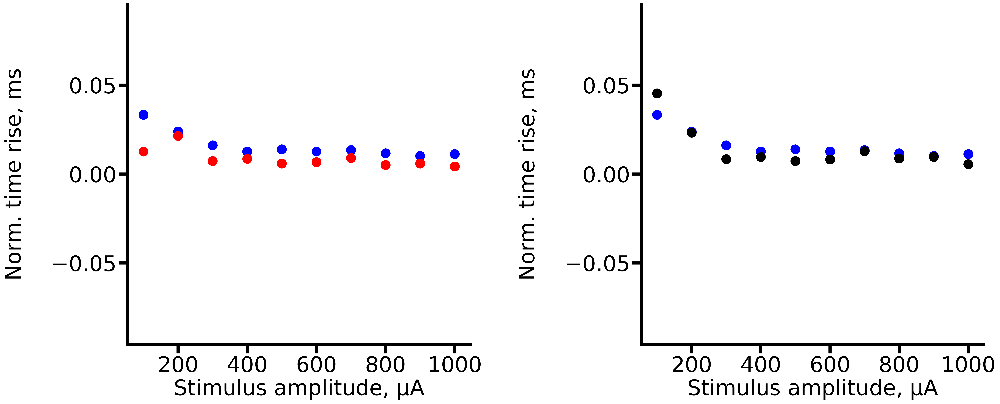

In [899]:
fig, axs = plt.subplots(1, 2, figsize=(25, 10), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = TRS
y1 = TRS1
y2 = TRS2
axs[0].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)
axs[1].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)

axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. time rise, ms", fontsize=35)
axs[1].set_ylabel("Norm. time rise, ms", fontsize=35)

axs[0].get_yaxis().set_label_coords(-0.3,0.5)
axs[1].get_yaxis().set_label_coords(-0.3,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/timerise.png", bbox_inches="tight")

In [883]:
fig, axs = plt.subplots(1, 2, figsize=(35, 12), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = timedecreases1
y3 = timedecreases3

min_all = min(min([min(sig) for sig in y]), min([min(sig) for sig in y3]))
max_all = max(max([max(sig) for sig in y]), max([max(sig) for sig in y3]))

axs[0].set_ylim(min_all, max_all+0.1)
axs[1].set_ylim(min_all, max_all+0.1)


axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. time decrease, ms", fontsize=35)
axs[1].set_ylabel("Norm. time decrease, ms", fontsize=35)

boxprops = dict(linewidth=5, color='black')
flierprops = dict(marker='o', markerfacecolor='black', markersize=12,
                  markeredgecolor='none')
medianprops = dict(linewidth=5, color='blue')
meanlineprops = dict(linewidth=5, color='blue')
whiskerprops = dict(linewidth=5, color='black')
capprops = dict(linewidth=5, color='black')
labels = list(range(100,1001,100))

axs[0].get_yaxis().set_label_coords(-0.2,0.5)
axs[1].get_yaxis().set_label_coords(-0.2,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].boxplot(y3, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanline=meanlineprops, whiskerprops=whiskerprops, capprops=capprops)
#axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].boxplot(y, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanprops=meanpointprops, whiskerprops=whiskerprops, meanline=meanlineprops, capprops=capprops)
#axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)

fig.savefig("new_only/timedecrease_boxplot.png", bbox_inches="tight")

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


In [884]:
fig, axs = plt.subplots(1, 2, figsize=(35, 12), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = timerises1
y3 = timerises3
min_all = min(min([min(sig) for sig in y]), min([min(sig) for sig in y3]))
max_all = max(max([max(sig) for sig in y]), max([max(sig) for sig in y3]))

axs[0].set_ylim(min_all, max_all+0.001)
axs[1].set_ylim(min_all, max_all+0.001)



axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. time rise, ms", fontsize=35)
axs[1].set_ylabel("Norm. time rise, ms", fontsize=35)


axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

# axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
# axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. time rise, ms", fontsize=35)
axs[1].set_ylabel("Norm. time rise, ms", fontsize=35)

boxprops = dict(linewidth=5, color='black')
flierprops = dict(marker='o', markerfacecolor='black', markersize=12,
                  markeredgecolor='none')
medianprops = dict(linewidth=5, color='blue')
meanlineprops = dict(linewidth=5, color='blue')
whiskerprops = dict(linewidth=5, color='black')
capprops = dict(linewidth=5, color='black')
labels = list(range(100,1001,100))

axs[0].get_yaxis().set_label_coords(-0.2,0.5)
axs[1].get_yaxis().set_label_coords(-0.2,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].boxplot(y3, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanline=meanlineprops, whiskerprops=whiskerprops, capprops=capprops)
#axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].boxplot(y, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanprops=meanpointprops, whiskerprops=whiskerprops, meanline=meanlineprops, capprops=capprops)
#axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/timerise_boxplot.png", bbox_inches="tight")

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


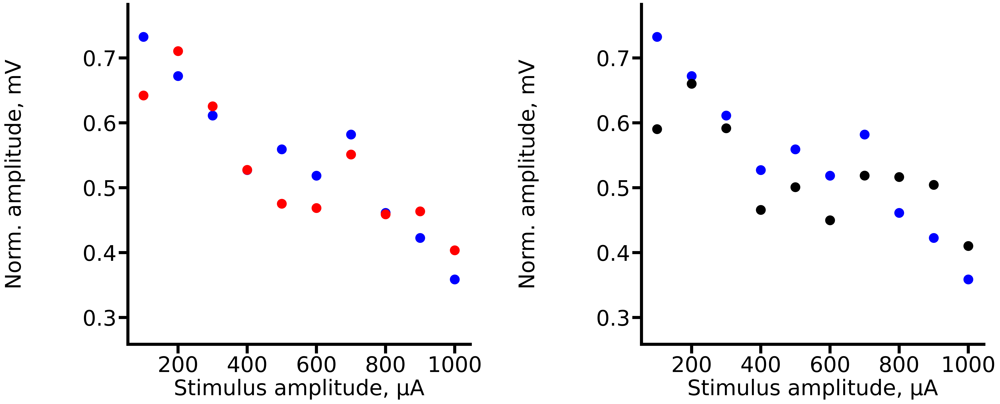

In [900]:
fig, axs = plt.subplots(1, 2, figsize=(25, 10), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = MVS
y1 = MVS1
y2 = MVS2
axs[0].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)
axs[1].set_ylim(min(min(y1), min(y2), min(y))-0.1,
            max(max(y1), max(y2), max(y))+0.05)


axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. amplitude, mV", fontsize=35)
axs[1].set_ylabel("Norm. amplitude, mV", fontsize=35)

axs[0].get_yaxis().set_label_coords(-0.3,0.5)
axs[1].get_yaxis().set_label_coords(-0.3,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].scatter(x1, y, label='real CA1', color='blue', linewidth=10)
axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/amplitude.png", bbox_inches="tight")

In [885]:
fig, axs = plt.subplots(1, 2, figsize=(35, 12), dpi=400)
axs[0].spines[['right', 'top']].set_visible(False)
axs[1].spines[['right', 'top']].set_visible(False)
plt.subplots_adjust(wspace=0.5)
x1 = list(range(100, 1001, 100))
print(x1)
y = minvalues1
y3= minvalues3

min_all = min(min([min(sig) for sig in y]), min([min(sig) for sig in y3]))
max_all = max(max([max(sig) for sig in y]), max([max(sig) for sig in y3]))

axs[0].set_ylim(min_all-0.1, max_all+0.001)
axs[1].set_ylim(min_all-0.1, max_all+0.001)



axs[0].xaxis.set_tick_params(labelsize=35)
axs[0].yaxis.set_tick_params(labelsize=35)

axs[1].xaxis.set_tick_params(labelsize=35)
axs[1].yaxis.set_tick_params(labelsize=35)

axs[0].set_xlabel("Stimulus amplitude, μA", fontsize=35)
axs[1].set_xlabel("Stimulus amplitude, μA", fontsize=35)

axs[0].set_ylabel("Norm. amplitude, mV", fontsize=35)
axs[1].set_ylabel("Norm. amplitude, mV", fontsize=35)

boxprops = dict(linewidth=5, color='black')
flierprops = dict(marker='o', markerfacecolor='black', markersize=12,
                  markeredgecolor='none')
medianprops = dict(linewidth=5, color='blue')
meanlineprops = dict(linewidth=5, color='blue')
whiskerprops = dict(linewidth=5, color='black')
capprops = dict(linewidth=5, color='black')
labels = list(range(100,1001,100))

axs[0].get_yaxis().set_label_coords(-0.2,0.5)
axs[1].get_yaxis().set_label_coords(-0.2,0.5)

# axs[0].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[0].plot(x1, y1, label='real CA1', color='red', linewidth=7)
axs[0].boxplot(y3, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanline=meanlineprops, whiskerprops=whiskerprops, capprops=capprops)
#axs[0].scatter(x1, y1, label='real CA1', color='red', linewidth=10)

# axs[1].plot(x1, y, label='real CA1', color='blue', linewidth=7)
# axs[1].plot(x1, y2, label='real CA1', color='black', linewidth=7)
axs[1].boxplot(y, labels=labels, boxprops = boxprops, flierprops = flierprops, medianprops=medianprops, meanprops=meanpointprops, whiskerprops=whiskerprops, meanline=meanlineprops, capprops=capprops)
#axs[1].scatter(x1, y2, label='real CA1', color='black', linewidth=10)


fig.savefig("new_only/amplitude_boxplot.png", bbox_inches="tight")

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]


In [667]:
np.save("preds_res.npy", preds)

In [256]:
Y_pred = preds[2]
Y_test = av1[2][:9000]

4993 9000
4901 9000
0.0014772908444640885 0.2804232804232804 0.032183163237755816 0.007968941561095219
[0.0027274] 0.18783068783068782 0.04503482909444354 0.0018389865140988966


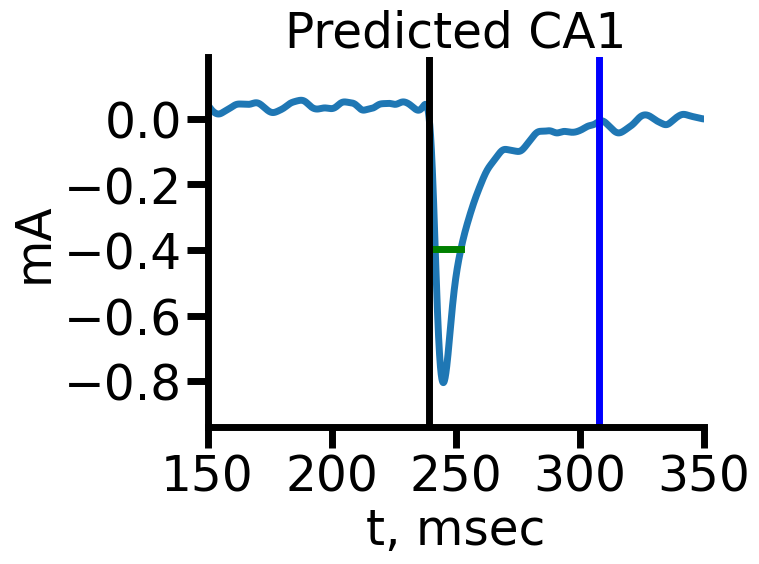

In [258]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
for i in range(10):
x1 = np.linspace(0, len(Y_test)/20, len(Y_test))
ax = plt.subplot(111)
ax.spines[['right', 'top']].set_visible(False)

left = 150
right = 350



plt.ylim(min(min(Y_test), min(Y_pred))-0.1,
            max(max(Y_test), max(Y_pred))+0.1)
# plt.ylim(min(min(Y_test), min(Y_pred))-0.05,
#             max(max(Y_test), max(Y_pred)))
plt.xlim([left, right])
plt.plot(x1, Y_pred, linewidth=5)
plt.xlabel("t, msec", fontsize=35)
plt.ylabel("mA", fontsize=35)
trueM = getMetrics(Y_test, print_metrics=True)
predM = getMetrics(Y_pred, print_metrics = True)
print(SL1, HW1, TD1, TR1)
print(SL2, HW2, TD2, TR2)

plt.yticks(fontsize=35)
plt.xticks(ticks=[150,200,250,300, 350], fontsize=35)


# plt.plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])),
#             [Y_test[trueM[-2]] for i in range(trueM[-2], trueM[-1])],
#             label="true HalfWidth", color='green', linewidth = 5)

# plt.axvline(trueM[1]/20, label="true TimeRise", color='black', linewidth =5)
# plt.axvline(trueM[2]/20, label="true TimeDecrease", color='blue', linewidth = 5)
plt.plot(np.linspace(predM[-2]/20, predM[-1]/20, (predM[-1]-predM[-2])),
            [Y_pred[predM[-2]] for i in range(predM[-2], predM[-1])],
            label="pred HalfWidth", color='green', linewidth = 5)

plt.axvline(predM[1]/20, label="pred TimeRise", color='black', linewidth = 5)
plt.axvline(predM[2]/20, label="pred TimeDecrease", color='blue', linewidth = 5)
#plt.legend()
plt.title("Predicted CA1", fontsize=35)
plt.savefig("pred_reservoir.png", bbox_inches='tight')

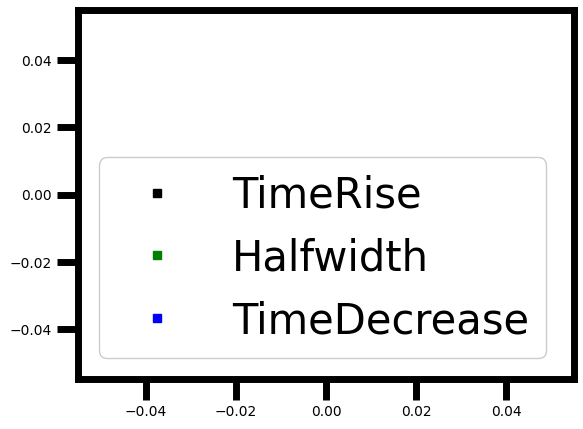

In [262]:
colors = ["black", "green", "blue"]
f = lambda m,c: plt.plot([],[],marker=m, color=c, ls="none")[0]
handles = [f("s", colors[i]) for i in range(3)]
labels = ["TimeRise", "Halfwidth", "TimeDecrease"]
legend = plt.legend(handles, labels, loc=3, framealpha=1, frameon=True, fontsize=30)

def export_legend(legend, filename="legend.png", expand=[-5,-5,5,5]):
    fig  = legend.figure
    fig.canvas.draw()
    bbox  = legend.get_window_extent()
    bbox = bbox.from_extents(*(bbox.extents + np.array(expand)))
    bbox = bbox.transformed(fig.dpi_scale_trans.inverted())
    fig.savefig(filename, dpi="figure", bbox_inches=bbox)

export_legend(legend)
plt.show()

## plt.figure(figsize=(7, 7), dpi=300)

plt.plot(range(100, 1001, 100), metrs_lstm, color='r')
plt.scatter(range(100, 1001, 100), metrs_lstm, color='r')

plt.xlabel('stimulation amplitude, mA', fontsize=20)
plt.ylabel('metric', fontsize=20)
plt.savefig('metrics_pimu_lstm.png')

In [ ]:
av_mape

In [133]:
res2_params

{(10, 10, 0.8, 0.5, 1.5, 1.5, 0.6, 0.6): [0.012426451109542207]}

In [132]:
res1_params

{(10, 0.7, 0.1, 0.1): [0.012872614514215374],
 (10, 0.7, 0.1, 0.5): [0.010992594751445092],
 (10, 0.7, 0.1, 0.9): [0.012236066431659493],
 (10, 0.7, 1.2, 0.1): [0.01531436680791488],
 (10, 0.7, 1.2, 0.5): [0.012970733911173085],
 (10, 0.7, 1.2, 0.9): [0.013702953502343676],
 (10, 0.7, 1.5, 0.1): [0.020118389934604256],
 (10, 0.7, 1.5, 0.5): [0.012872034693659263],
 (10, 0.7, 1.5, 0.9): [0.014882413923133738],
 (10, 0.7, 0.8, 0.1): [0.011869185287930985],
 (10, 0.7, 0.8, 0.5): [0.01391749547786002],
 (10, 0.7, 0.8, 0.9): [0.011242490556321304],
 (10, 0.7, 2, 0.1): [0.03355366886737274],
 (10, 0.7, 2, 0.5): [0.020829220061391207],
 (10, 0.7, 2, 0.9): [0.044924298584367334],
 (10, 0.1, 0.1, 0.1): [0.01035580914969873],
 (10, 0.1, 0.1, 0.5): [0.012126818909864823],
 (10, 0.1, 0.1, 0.9): [0.009777551775924997,
  0.016580186636146996,
  0.005531857548610375,
  0.005692165731328016],
 (10, 0.1, 1.2, 0.1): [0.017310878935197987],
 (10, 0.1, 1.2, 0.5): [0.018113381952318233],
 (10, 0.1, 1.2, 0.

In [159]:
np.save('res1_params.npy', res1_params)
np.save('res2_params.npy', res2_params)

In [117]:
res1_params = np.load('res1_params.npy', allow_pickle=True).item()

In [157]:
res1_params

{(10, 0.7, 0.1, 0.1): [0.012872614514215374],
 (10, 0.7, 0.1, 0.5): [0.010992594751445092],
 (10, 0.7, 0.1, 0.9): [0.012236066431659493],
 (10, 0.7, 1.2, 0.1): [0.01531436680791488],
 (10, 0.7, 1.2, 0.5): [0.012970733911173085],
 (10, 0.7, 1.2, 0.9): [0.013702953502343676],
 (10, 0.7, 1.5, 0.1): [0.020118389934604256],
 (10, 0.7, 1.5, 0.5): [0.012872034693659263],
 (10, 0.7, 1.5, 0.9): [0.014882413923133738],
 (10, 0.7, 0.8, 0.1): [0.011869185287930985],
 (10, 0.7, 0.8, 0.5): [0.01391749547786002],
 (10, 0.7, 0.8, 0.9): [0.011242490556321304],
 (10, 0.7, 2, 0.1): [0.03355366886737274],
 (10, 0.7, 2, 0.5): [0.020829220061391207],
 (10, 0.7, 2, 0.9): [0.044924298584367334],
 (10, 0.1, 0.1, 0.1): [0.01035580914969873],
 (10, 0.1, 0.1, 0.5): [0.012126818909864823],
 (10, 0.1, 0.1, 0.9): [0.009777551775924997,
  0.016580186636146996,
  0.005531857548610375,
  0.005692165731328016],
 (10, 0.1, 1.2, 0.1): [0.017310878935197987],
 (10, 0.1, 1.2, 0.5): [0.018113381952318233],
 (10, 0.1, 1.2, 0.

In [136]:
res2_params=np.load('res2_params.npy', allow_pickle=True).item()

In [158]:
res2_params

{(10, 1, 0.1, 0.8, 1.5, 1.2, 0.1, 0.1): [],
 (20, 1, 0.1, 0.8, 1.5, 1.2, 0.1, 0.1): [],
 (20, 1, 0.1, 0.8, 0.1, 0.1, 0.1, 0.1): [],
 (50, 1, 0.1, 0.8, 0.1, 0.1, 0.1, 0.1): [],
 (5, 1, 0.1, 0.8, 0.1, 0.1, 0.1, 0.1): [],
 (1000, 1, 0.1, 0.8, 0.1, 0.1, 0.1, 0.1): [],
 (10, 10, 0.1, 0.8, 0.1, 0.1, 0.1, 0.1): [],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.1, 0.1): [0.0407999815335959],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.1, 0.5): [0.14835620808529354],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.1, 0.9): [0.04176038374611089],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.5, 0.1): [0.03770330882610611],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.5, 0.5): [0.03820418129799891],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.5, 0.9): [],
 (10, 10, 0.1, 0.8, 1.5, 1.5, 0.6, 0.6): [0.045424047229455665],
 (10, 10, 0.1, 0.1, 1.5, 1.5, 0.6, 0.6): [0.0714326974915623],
 (10, 10, 0.1, 0.5, 1.5, 1.5, 0.6, 0.6): [0.02743907804771268],
 (10, 10, 0.8, 0.8, 1.5, 1.5, 0.6, 0.6): [0.01573440790950509,
  0.023610024141908652],
 (10, 10, 0.8, 0.1, 1.5, 1.5, 0.6, 0.6): [0.02

In [111]:
for key in pars[0].keys():
    print(key, pars[key])

IndexError: too many indices for array: array is 0-dimensional, but 1 were indexed

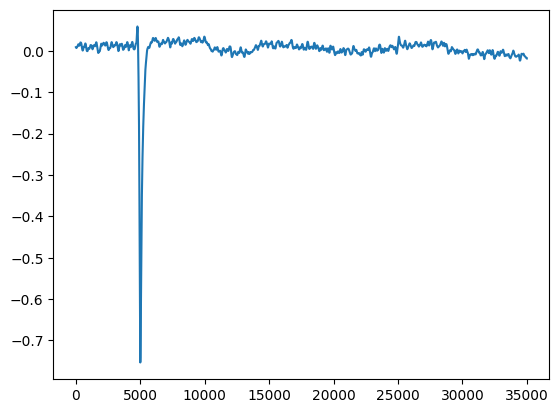

In [80]:
plt.plot(av3[1])

In [132]:
reservoir = Reservoir(10, lr = 0.6, sr=1.5, rc_connectivity=0.4)
readout = Ridge(ridge=2)
metrs=[]
preds=[]
for sig in range(len(av3)):
    X_train, Y_train, X_test, Y_test = prepare_test(sig)
    print(len(X_train[0]))
    print(f'Sig {sig} running...')
    for i in range(len(X_train)):
        train_states = reservoir.run(X_train[i], reset=False)
        readout = readout.fit(train_states, Y_train[i])

    test_states = reservoir.run(X_test)
    Y_pred = readout.run(test_states)
    plt.figure(figsize=(10, 7), dpi=400)

    x1 = np.linspace(0, len(Y_test)/20, len(Y_test))
    y1 = np.linspace(0, len(Y_pred)/20, len(Y_pred))

    left = 150
    right = 800

    plt.ylim(min(min(Y_test), min(Y_pred))-0.05,
                max(max(Y_test), max(Y_pred)))
    plt.xlim([left, right])

    plt.plot(x1, Y_test, label='real CA1', color='blue', linewidth=3)
    plt.plot(y1, Y_pred,  label='predicted CA1', color='red', linewidth=3)
    trueM = getMetrics(Y_test, print_metrics=True)
    predM = getMetrics(Y_pred, print_metrics = True)

    weight_coeffs=[0.1, 0.5, 0.3, 0.1]
    trueM_c = getMetrics(Y_test, print_metrics=False)
    predM_c = getMetrics(Y_pred, print_metrics=False)
    cur_metric = weight_coeffs[0]*(trueM_c[0] - predM_c[0])**2 + weight_coeffs[1]*(trueM_c[1] - predM_c[1])**2 + weight_coeffs[2]*(trueM_c[2] - predM_c[2])**2 + weight_coeffs[3]*(trueM_c[3] - predM_c[3])**2

    print(cur_metric)
    print(trueM_c)
    print(predM_c)
    plt.plot(np.linspace(trueM[-2]/20, trueM[-1]/20, (trueM[-1]-trueM[-2])),
            [Y_test[trueM[-2]] for i in range(trueM[-2], trueM[-1])],
            label="true HalfWidth", color='green', linewidth = 2)

    plt.axvline(trueM[1]/20, label="true TimeRise", color='orange', linewidth =2)
    plt.axvline(trueM[2]/20, label="true TimeDecrease", color='purple', linewidth = 2)
    plt.plot(np.linspace(predM[-2]/20, predM[-1]/20, (predM[-1]-predM[-2])),
            [Y_pred[predM[-2]] for i in range(predM[-2], predM[-1])],
            label="pred HalfWidth", color='green', linewidth = 2)

    plt.axvline(predM[1]/20, label="pred TimeRise", color='orange', linewidth = 2)
    plt.axvline(predM[2]/20, label="pred TimeDecrease", color='blue', linewidth = 2)
    
    plt.xlabel("t, msec", fontsize=35)
    plt.ylabel("mA", fontsize=35)
    plt.legend(fontsize=15)
    plt.savefig(f"amp{sig}")
    #plt.legend(fontsize=10)
    plt.show()

    reservoir = reservoir.reset()
    preds.append(Y_pred)
    

    # [SL1, HW1, TD1, TR1] = getMetrics(Y_pred[0])
    # [SL2, HW2, TD2, TR2] = getMetrics(Y_test)
    #print(SL1, HW1, TD1, TR1)
    #print(SL2, HW2, TD2, TR2)
    metrs.append(cur_metric)
    #print(0.2*(SL1-SL2)**2 + 0.4*(HW1-HW2)**2 + 0.1*(TD1-TD2)**2 + 0.3*(TR1-TR2)**2 + 0.5*(MV1-MV2)**2)

55000
Sig 0 running...


Running Reservoir-21:  26%|█████████████▎                                      | 14106/55000 [00:02<00:06, 6602.59it/s]


KeyboardInterrupt: 

In [53]:
to_exp = preds

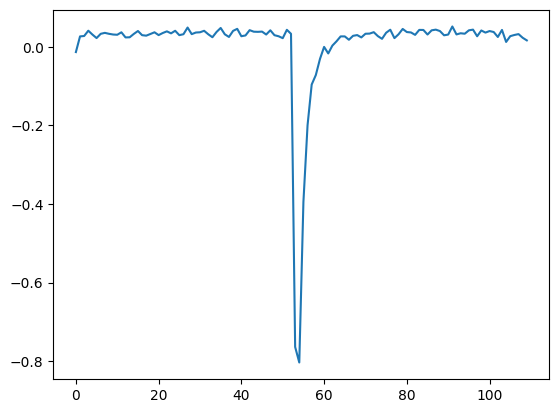

In [48]:
plt.plot(to_exp[0][::100])

In [126]:
b, a = scipy.signal.ellip(4, 0.001, 20, 0.125)

In [218]:
ex = np.ravel(to_exp[0][::10]) - 0.02

In [219]:
np.argmin(ex)

535

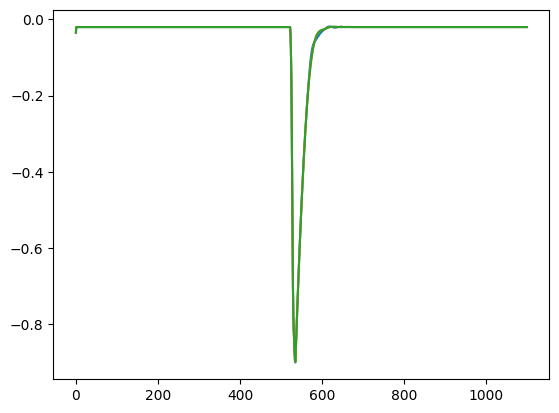

In [222]:
plt.plot(ex)
ex[535:] = scipy.signal.savgol_filter(np.ravel(ex[535:]), 65, 2)
plt.plot(ex)
for i in range(len(ex)):
    if ex[i]>0:
        ex[i]=0
plt.plot(ex)
plt.show()

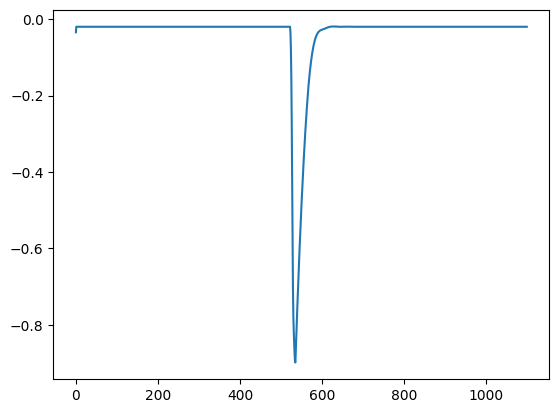

In [223]:
plt.plot(ex)

In [140]:
res1_params={}
res2_params={}

In [245]:
to_exp = preds

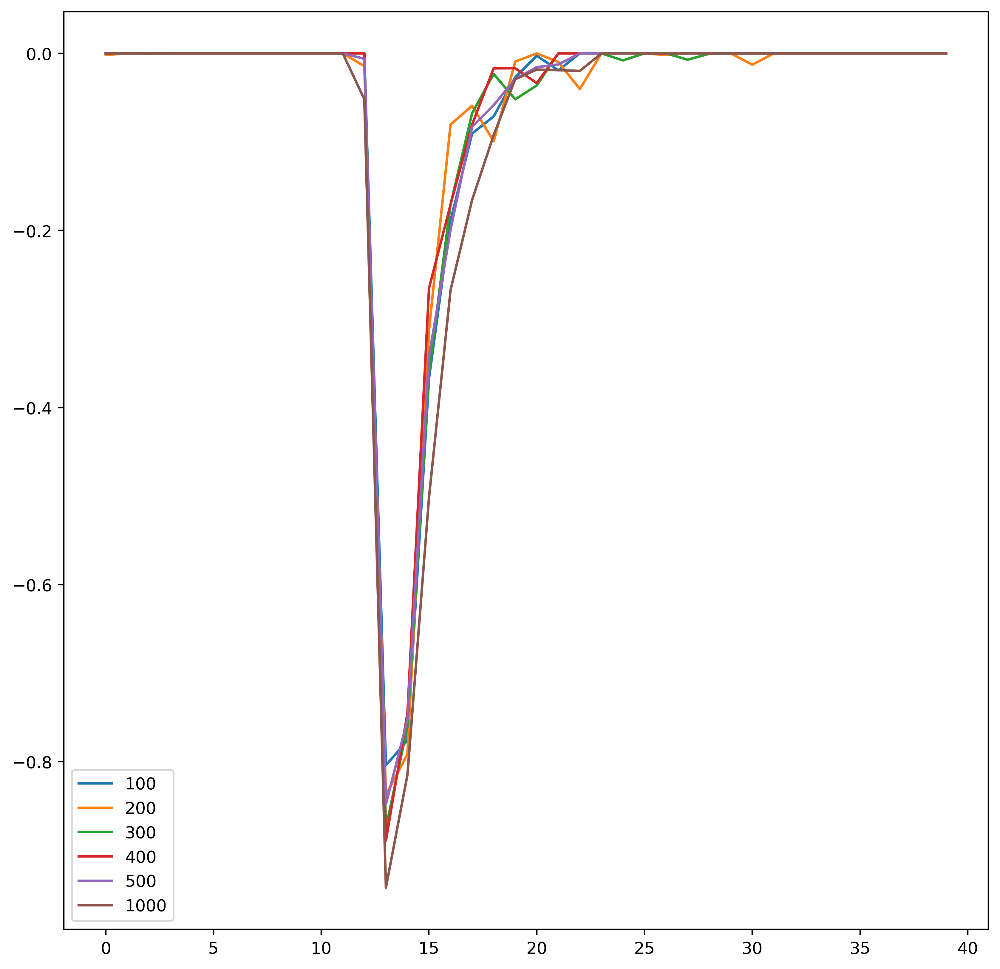

In [54]:
plt.figure(figsize=(10,10), dpi=400)
for pred, amp in zip(to_exp, [100,200,300,400,500,1000]):
    pred=pred[10::100]
    for i in range(len(pred)):
        if pred[i]>0:
            pred[i]=0
    # argmn = np.argmin(pred)
    # pred = np.ravel(pred)
    # pred[argmn:] = scipy.signal.savgol_filter(np.ravel(pred[argmn:]), 7, 2)
    # argmn = np.argmin(pred)
    # pred[argmn:] = scipy.signal.savgol_filter(np.ravel(pred[argmn:]), 7, 2)
    # argmn = np.argmin(pred)
    # pred[argmn:] = scipy.signal.savgol_filter(np.ravel(pred[argmn:]), 7, 2)
    plt.plot(pred[40:80], label=amp)
    plt.legend()
    plt.savefig("Predicted signals_100times_nosmooth.png")
    np.save(f"amp_{amp}_100times.npy", pred[40:80])

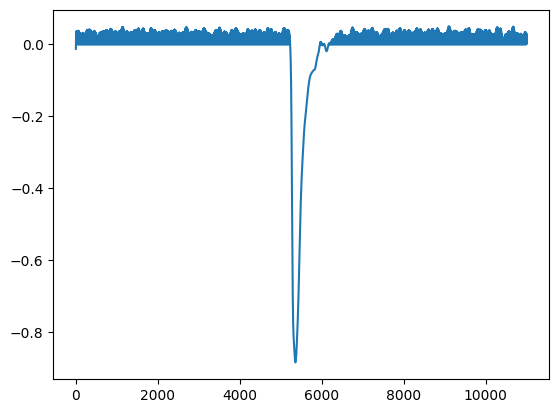

In [228]:
plt.plot(preds[0])

In [55]:
def to_txt(path):
    b = np.load(f'{path}.npy')
    plt.plot(b)
    f = open(f"{path}.txt", 'w+')
    for a in b:
        f.write(str(a)+'\r\n')
    f.close()

In [ ]:
for amp in [100,200,300,400,500,1000]:
    to_txt(f"amp_{amp}_smooth_100times")
    plt.savefig("amps_smooth.png")

In [ ]:
test_states = reservoir.run(X_test_1[2][:stop])
Y_pred = readout.run(test_states)

plt.figure(figsize=(10, 5))
plt.plot(Y_test_1[2], label='Real ca1')
plt.plot(Y_pred[0], label='Predicted ca1')
plt.legend()
plt.title("Amp 800 in test")
plt.savefig("800.pdf")

In [ ]:
for sig in Y_test_1:
    plt.plot(sig)
    plt.show()

Running Reservoir-2:  65%|███████████████████████████████████▏                  | 7295/11202 [00:00<00:00, 7772.85it/s]


KeyboardInterrupt: 

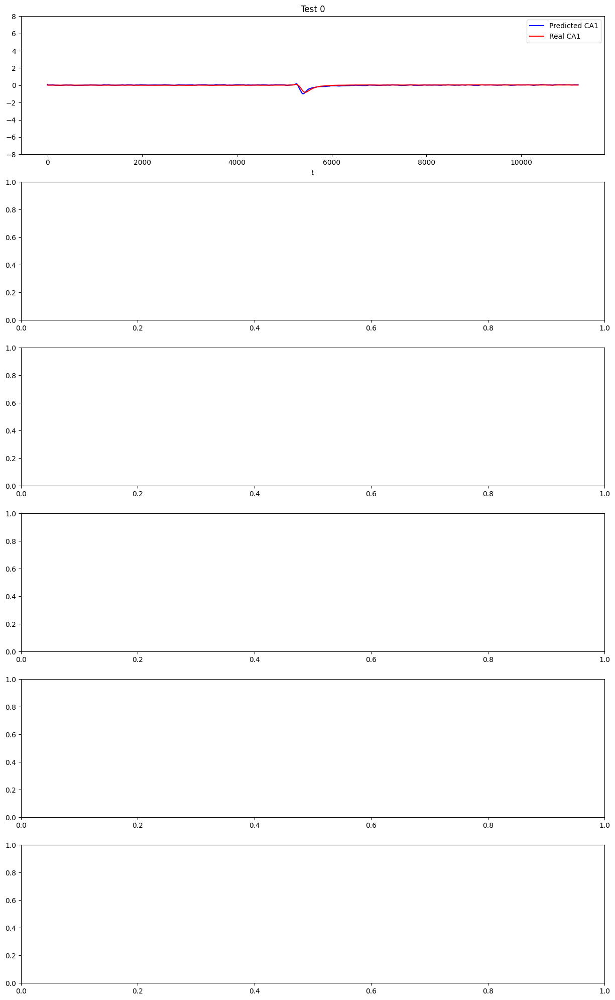

In [36]:
# fig, axs = plt.subplots(6, figsize=(15, 25))
# for num_test in range(len(averaged1)):
#     X_test = averaged3[num_test].reshape(-1, 1)
#     Y_test = averaged1[num_test].reshape(-1, 1)
    
    
#     X_tr = np.delete(averaged3, num_test, 0)
#     Y_tr = np.delete(averaged1, num_test, 0)
    
#     X_train=[]
#     Y_train=[]
#     for i in range(len(X_tr)):
#         X_train.append(X_tr[i].reshape(-1, 1))
#         Y_train.append(Y_tr[i].reshape(-1, 1))
#     reservoir = Reservoir(25, lr=0.7, sr=0.1, input_scaling=0.5)
#     readout = Ridge(ridge=1e-7)
#     for i in range(len(X_train)):
#         train_states = reservoir.run(X_train[i], reset=False)
#         readout = readout.fit(train_states, Y_train[i])
#     test_states = reservoir.run(X_test)
#     Y_pred = readout.run(test_states)
    
#     axs[num_test].set_title(f"Test {num_test}")
#     axs[num_test].set_xlabel("$t$")
#     axs[num_test].plot(Y_pred, label="Predicted CA1", color="blue")
#     axs[num_test].set_ylim([-8, 8])
#     axs[num_test].plot(Y_test, label="Real CA1", color="red")
#     axs[num_test].legend()
# plt.tight_layout()
# plt.savefig("res_cross_val")

In [109]:
r1 = np.array([np.array([0.02258604]),
 np.array([0.01307474]),
 np.array([0.01402705]),
 np.array([0.03973598]),
 np.array([0.01001369]),
 np.array([0.05432905])])

r1.reshape(6)

r2=np.array([np.array([0.02394709]),
 np.array([0.01679851]),
 np.array([0.01406092]),
 np.array([0.03942279]),
 np.array([0.0089614]),
 np.array([0.02151971])])

r3=np.array([np.array([0.0121827]),
 np.array([0.00824773]),
 np.array([0.0131568]),
 np.array([0.03970138]),
 np.array([0.01116959]),
 np.array([0.38886737])])

r4=np.array([np.array([0.02267644]),
 np.array([0.01462432]),
 np.array([0.0152482]),
 np.array([0.0394109]),
 np.array([0.00976398]),
 np.array([0.03660556])])

r5=np.array([np.array([0.0207721]),
 np.array([0.01380729]),
 np.array([0.01317304]),
 np.array([0.04015561]),
 np.array([0.0099952]),
 np.array([0.04611665])])


r1.reshape(6)
r2.reshape(6)
r3.reshape(6)
r4.reshape(6)
r5.reshape(6)

array([0.0207721 , 0.01380729, 0.01317304, 0.04015561, 0.0099952 ,
       0.04611665])

In [110]:
rr = (r1+r2+r3+r4+r5)/5

In [111]:
rr

array([[0.02043287],
       [0.01331052],
       [0.0139332 ],
       [0.03968533],
       [0.00998077],
       [0.10948767]])

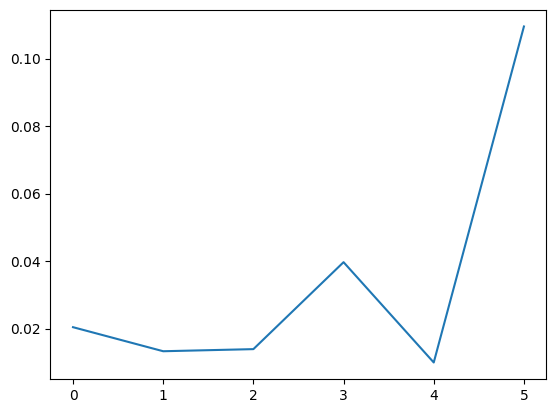

In [112]:
plt.plot(rr)

In [113]:
l1=[4.293174874562888,
 2.583622362194235,
 0.07658956960251184,
 0.19025135665696769,
 0.008839391480468731,
 0.33520078956143656]

l2=[0.04912822054166592,
 2.2513628213832844,
 7.935755723256142,
 0.14462819416437722,
 0.4917375821521528,
 2.40212588299565]

l3=[0.02099787401819495,
 2.630849253595907,
 0.20915086678231642,
 0.16883378913913397,
 0.04491754830007453,
 0.29510661404237587]

l4=[0.03874597059890759,
 2.222566199464626,
 0.42651140985608776,
 0.2690480218314829,
 0.08426404153698702,
 0.9172114281462839]

l5=[0.025757737291106177,
 2.4486941257944794,
 0.12641070836864945,
 0.11160098241545725,
 0.13101165407643942,
 0.7563352418836001]

In [114]:
l1=np.array(l1)
l2=np.array(l2)
l3=np.array(l3)
l4=np.array(l4)
l5=np.array(l5)

In [115]:
ll=(l1+l2+l3+l4+l5)/5

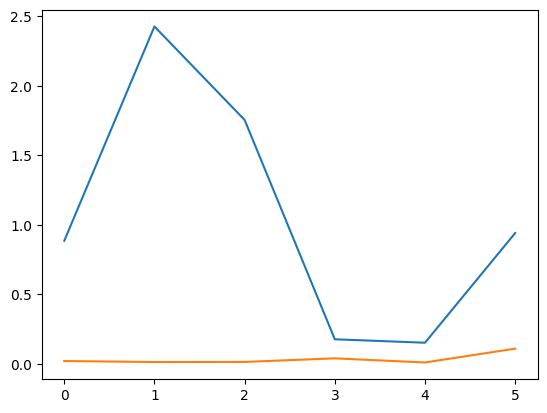

In [116]:
plt.plot(ll)
plt.plot(rr)

In [117]:
x=[100, 200, 300, 400, 500, 1000]

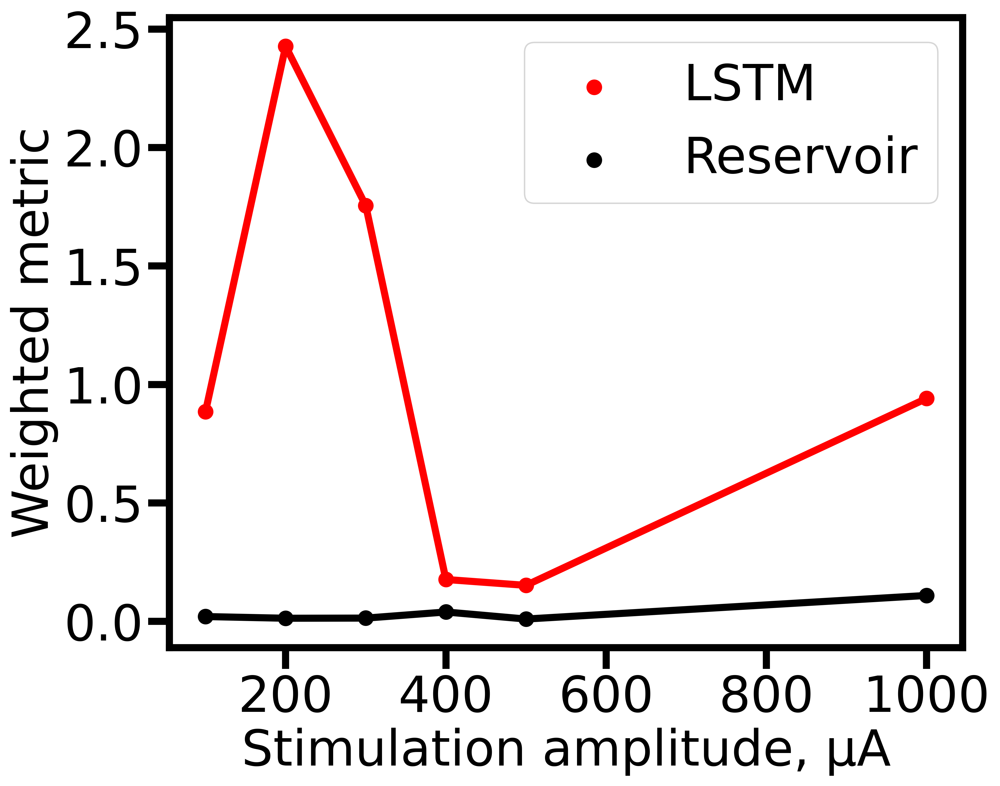

In [171]:
plt.rcParams['axes.linewidth'] = 5
plt.rcParams['xtick.major.width'] = 5
plt.rcParams['ytick.major.width'] = 5
plt.rcParams['xtick.major.size'] = 15
plt.rcParams['ytick.major.size'] = 15
plt.figure(figsize=(10, 8), dpi=400)
plt.plot(x, ll, color='r', linewidth = 5)
plt.scatter(x, ll, label='LSTM', color='r', linewidth = 5)
plt.plot(x, rr, color='black', linewidth = 5)
plt.scatter(x, rr, label='Reservoir', color='black', linewidth = 5)
plt.xlabel("Stimulation amplitude, μА", fontsize=35)
plt.ylabel("Weighted metric", fontsize=35)
plt.yticks(fontsize=35)
plt.xticks(fontsize=35)
plt.legend(fontsize=35)
plt.savefig("Metrics.png", bbox_inches='tight')

In [45]:
x1 = [1e-06,
5e-06,
4.4e-05,
0.000489,
0.004531,
0.050396,
0.467846,
5.04033
]
x2 = [1e-06,
2e-06,
1.5e-05,
0.000133,
0.00102,
0.016719,
0.120496,
4.60713
]

x= np.array([10, 100, 1000, 10000, 100000, 1000000, 10000000, 100000000])

In [52]:
plt.figure(figsize=(10,10), dpi=400)

plt.plot(math.log(x),x1)
plt.plot(math.log(x),x2)

TypeError: must be real number, not list

<Figure size 4000x4000 with 0 Axes>